In [1]:
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import keras
import tensorflow as tf
from keras import layers
import matplotlib.pyplot as plt
import os
import time
from PIL import Image
from keras.preprocessing import image
from tqdm import tqdm
from tensorflow.keras.preprocessing.image import array_to_img, img_to_array
from tensorflow.keras.preprocessing.image import NumpyArrayIterator, ImageDataGenerator
import IPython
from IPython import display

# Generate Monet style paintings with DCGAN models

- This project goal is to generate paintings in the style of Monet with Deep Convolutional Generative Adversial Networks (DCGAN). DCGAN is a type of neural network consisting of two main neural networks: discriminator and generator. The generator generates images and the discriminator separates the generated images from the real images. The idea is for DCGAN is to let discriminator and generator compete with each other to generate images similar to the input images.
- In this project, a dataset of 300 Monet's paintings (256x256) is downloaded from the Kaggle competition "I’m Something of a Painter Myself". 

## Import images

Let's import all 300 images from tfrecord files.

These images are stored in RBG format. Pixel values are normalized from (0,255) to (-1,1).

Images are splited into 10 batches of 30 images for model training.



In [2]:
# Get file list
file_list=["monet_tfrec/"+ fname for fname in os.listdir("monet_tfrec")]

# Read tfrecord files
tfrecord_format = {
    'image_name': tf.io.FixedLenFeature([], tf.string)
    , 'image': tf.io.FixedLenFeature([], tf.string)
    , 'target': tf.io.FixedLenFeature([], tf.string)}

# Pull image data out of individual TFRecord elements as dictionary mappings and then convert to iamges
def parse_image(record):
    img = tf.io.parse_single_example(record, tfrecord_format)['image']
    img = tf.io.decode_image(img, channels=3)
    img = (tf.cast(img, tf.float32)-127.5)/127.5 # Normalize pixel values
    return img

# Import tfrec files
tfrecs_monet = tf.data.TFRecordDataset(file_list)

img_monet=tfrecs_monet.map(parse_image).batch(30)

2024-09-17 22:54:34.600293: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2
2024-09-17 22:54:34.600342: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 8.00 GB
2024-09-17 22:54:34.600356: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 2.67 GB
2024-09-17 22:54:34.600616: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:303] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2024-09-17 22:54:34.600663: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:269] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Let's show some sample images from Monet.

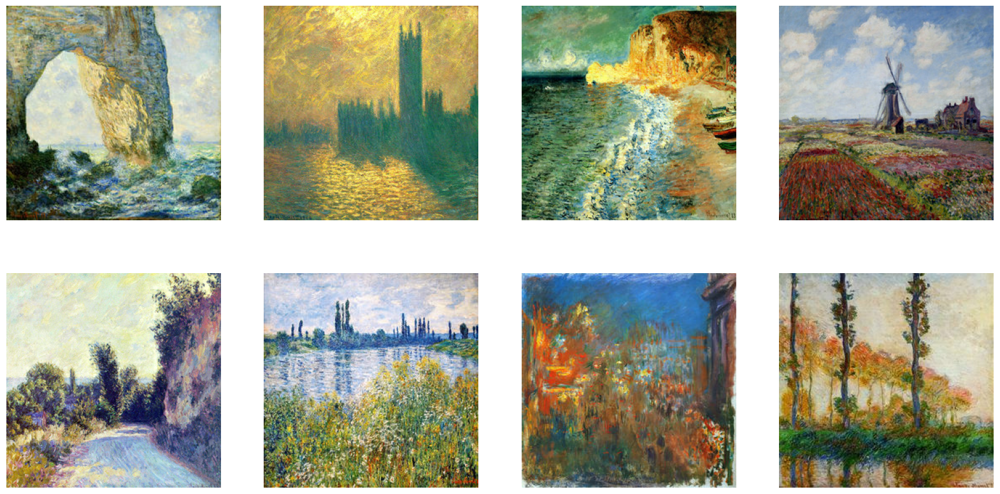

In [3]:
# Show some example paintings
sample_monet =next(iter(img_monet))
painting_it=iter(sample_monet)

plt.figure(figsize=(20, 10))
for i in range (0,4):
    plt.subplot(2, 4, i + 1)
    plt.imshow(np.array(next(painting_it)*127.5+127.5).astype('int'))
    plt.axis('off')
for i in range (4,8):
    plt.subplot(2, 4, i + 1)
    plt.imshow(np.array(next(painting_it)*127.5+127.5).astype('int'))
    plt.axis('off')

plt.show()

## DCGAN Model

Let's build the DCGAN model. Some of the codes are referred to https://www.tensorflow.org/tutorials/generative/dcgan

The dicriminator has input shape of 256x256x3 for the RBG images.
I add a series of Convolutional layers, Batch normalization, and leaky Relu so that the model can extract deep features from images.
Then, the flatten layer transform the feature map to 1 dimension. Dropout layer with rate 0.3 helps the model increase the weights of imporatnt features only.
Finally, The output layer has a sigmoid activation function of the probability that the image is real.

In [12]:
discriminator = keras.Sequential(
    [
        keras.Input(shape=(256, 256, 3)),
        layers.Conv2D(32, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2D(64, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(128, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(256, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(512, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Flatten(),
        layers.Dropout(0.3),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 128, 128, 32)      896       
                                                                 
 leaky_re_lu_9 (LeakyReLU)   (None, 128, 128, 32)      0         
                                                                 
 conv2d_7 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 batch_normalization_4 (Bat  (None, 64, 64, 64)        256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_8 (Conv2D)           (None, 32, 32, 128)       73856     
                                                     

The Generator takes in a series of 100 random numbers. The input is passed through a dense layer and reshaped into 16x16 map. The map is passed through a series of Transpose Convolutional layers and Leaky Relu layers to increase the dimension until it reaches dimension 256x256. Finally, the outputlayer is a Convolutional layer that extract main features and map them into RBG format 256x256x3.

In [13]:
latent_dim = 100

generator = keras.Sequential(
    [
        keras.Input(shape=(latent_dim,)),
        layers.Dense(16 * 16 * 512),
        layers.Reshape((16, 16, 512)),
        layers.Conv2DTranspose(256, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(128, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(64, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(32, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2D(3, kernel_size=(3, 3),strides=(1, 1), padding="same", activation="tanh"),
    ],
    name="generator",
)
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 131072)            13238272  
                                                                 
 reshape_1 (Reshape)         (None, 16, 16, 512)       0         
                                                                 
 conv2d_transpose_4 (Conv2D  (None, 32, 32, 256)       1179904   
 Transpose)                                                      
                                                                 
 leaky_re_lu_14 (LeakyReLU)  (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose_5 (Conv2D  (None, 64, 64, 128)       295040    
 Transpose)                                                      
                                                                 
 leaky_re_lu_15 (LeakyReLU)  (None, 64, 64, 128)       0 

I use the binary cross entropy loss function for this model.

The loss for discriminator model takes in both the output from real images and generated (fake) images. The real loss is cross entropy of output from real images and label 1; the fake loss is cross entropy of fake images and label 0. The sum of these losses is discriminator loss. This loss is minimized when the discriminator is able to separate generated images and real images well.

The generator loss is the opposite. It is the cross entropy of generated images output for discriminator and label 1. This loss is minimize when the generated images look similar to the real images.

I use Adam optimizer with an initial learning rate of 0.0002 because of this optimizer's superior performance thanks to learning rate decay.

In [53]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

generator_optimizer = tf.keras.optimizers.legacy.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(2e-4, beta_1=0.5)


I set some key hyperparameters here: 
- Batch size of 30
- 500 epochs
- latent dimension for generator of 100

In [15]:
BATCH_SIZE =30
EPOCHS = 500
noise_dim = 100

# Reuse this seed over time to visualize progress
seed = tf.random.normal([1, noise_dim])

I define the training step function for the model. The general steps include:

- Generate images from random noises
- Calculate the discriminator loss from real images and generated images
- Calculate the generator loss from generated images
- Find gradients from the losses
- Update weights of discriminator and generator from the gradients

In [16]:
def train_step(d_loss, g_loss,images):
    #get random noise    
    noise = tf.random.normal([images.shape[0], noise_dim])
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True) #Generate images from noise
        real_output = discriminator(images, training=True) # Find fake loss
        fake_output = discriminator(generated_images, training=True) # Find real loss
        # Get dicriminator loss and generator loss
        disc_loss = discriminator_loss(real_output, fake_output)
        gen_loss = generator_loss(fake_output)

        #Store the loss
        d_loss.append(disc_loss)
        g_loss.append(gen_loss)

        # Calculate the gradients from the losses
        gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

        # Update weights from the gradients
        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return d_loss, g_loss

I also define the train function. The train function runs the epochs and batches. It updates the weights with the training step function. The train function also stores the discriminator loss and generator loss from each epoch.

In [19]:
def train(dataset, epochs):
    discriminator_loss_hist, generation_loss_hist=[],[]
    start = time.time()
    for epoch in range(epochs):
        print('Training epoch {}/{}'.format(epoch+1, epochs))
        d_loss, g_loss = [], []

        for batch in dataset:
            d_loss, g_loss=train_step(d_loss, g_loss, batch)

        
        #Store history of loss
        discriminator_loss_hist.append(np.mean(d_loss))
        generation_loss_hist.append(np.mean(g_loss)) 
        if (epoch+1) % 20 == 0:                                  
            print('generator loss: {}    discriminator loss: {}'.format( generation_loss_hist[-1],discriminator_loss_hist[-1]))
            print ('Time for epoch {} is {} min'.format(epoch + 1, (time.time()-start)/60))
            generate_and_save_images(generator,epoch+1,seed)
    return discriminator_loss_hist, generation_loss_hist

This function is to generate the seed image after epoch for display.

In [20]:
def generate_and_save_images(model, epoch, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10, 10))
    
    plt.imshow((np.array((predictions[0]+1)*127.5).astype(int)))     
    plt.axis('off')

    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

Now, let's train the model.

Training epoch 1/500
Training epoch 2/500
Training epoch 3/500
Training epoch 4/500
Training epoch 5/500
Training epoch 6/500
Training epoch 7/500
Training epoch 8/500
Training epoch 9/500
Training epoch 10/500
Training epoch 11/500
Training epoch 12/500
Training epoch 13/500
Training epoch 14/500
Training epoch 15/500
Training epoch 16/500
Training epoch 17/500
Training epoch 18/500
Training epoch 19/500
Training epoch 20/500
generator loss: 1.8346076011657715    discriminator loss: 0.4918705224990845
Time for epoch 20 is 2.045515819390615 min


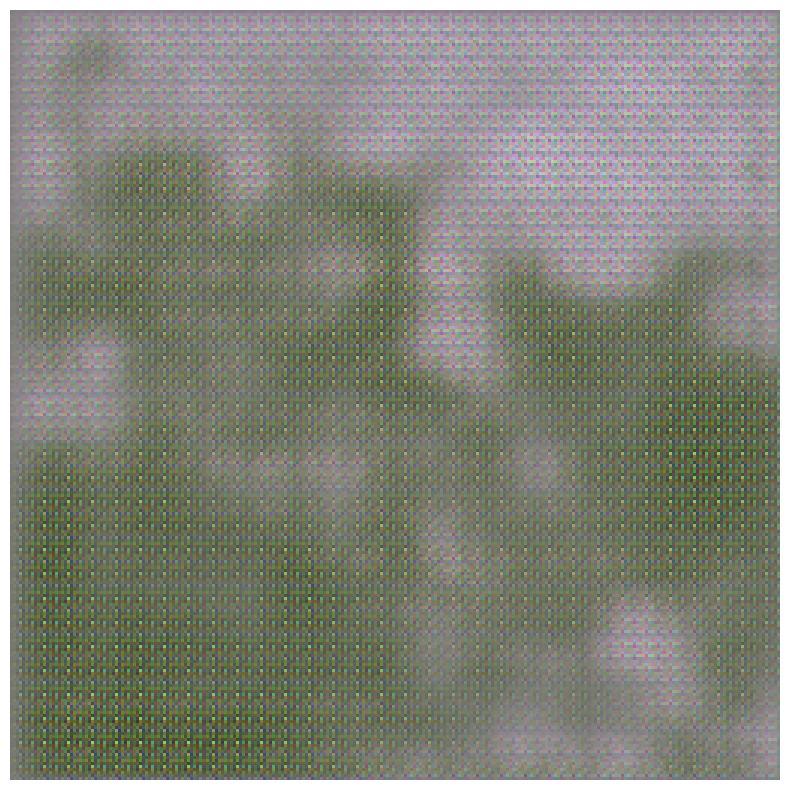

Training epoch 21/500
Training epoch 22/500
Training epoch 23/500
Training epoch 24/500
Training epoch 25/500
Training epoch 26/500
Training epoch 27/500
Training epoch 28/500
Training epoch 29/500
Training epoch 30/500
Training epoch 31/500
Training epoch 32/500
Training epoch 33/500
Training epoch 34/500
Training epoch 35/500
Training epoch 36/500
Training epoch 37/500
Training epoch 38/500
Training epoch 39/500
Training epoch 40/500
generator loss: 1.525109052658081    discriminator loss: 1.0985922813415527
Time for epoch 40 is 4.082966768741608 min


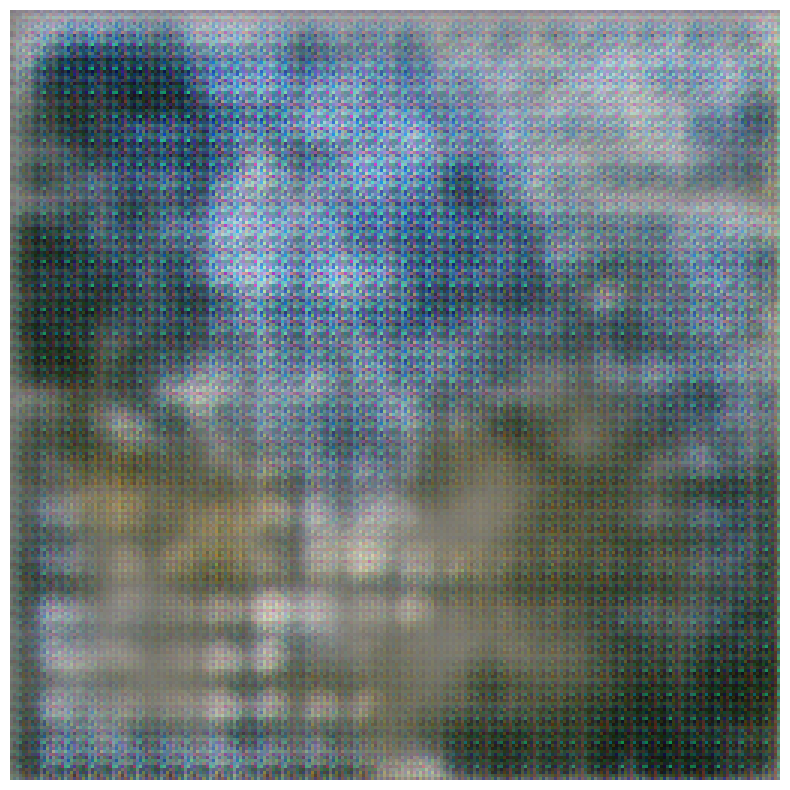

Training epoch 41/500
Training epoch 42/500
Training epoch 43/500
Training epoch 44/500
Training epoch 45/500
Training epoch 46/500
Training epoch 47/500
Training epoch 48/500
Training epoch 49/500
Training epoch 50/500
Training epoch 51/500
Training epoch 52/500
Training epoch 53/500
Training epoch 54/500
Training epoch 55/500
Training epoch 56/500
Training epoch 57/500
Training epoch 58/500
Training epoch 59/500
Training epoch 60/500
generator loss: 1.2317299842834473    discriminator loss: 0.9748015403747559
Time for epoch 60 is 6.1325831373532615 min


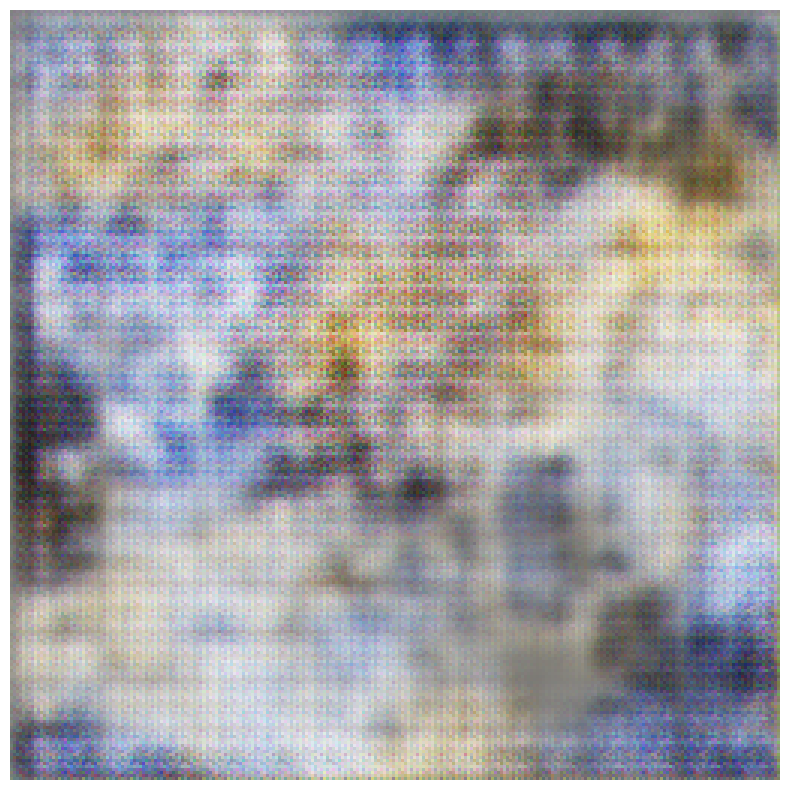

Training epoch 61/500
Training epoch 62/500
Training epoch 63/500
Training epoch 64/500
Training epoch 65/500
Training epoch 66/500
Training epoch 67/500
Training epoch 68/500
Training epoch 69/500
Training epoch 70/500
Training epoch 71/500
Training epoch 72/500
Training epoch 73/500
Training epoch 74/500
Training epoch 75/500
Training epoch 76/500
Training epoch 77/500
Training epoch 78/500
Training epoch 79/500
Training epoch 80/500
generator loss: 1.018824815750122    discriminator loss: 1.2401633262634277
Time for epoch 80 is 8.178350786368052 min


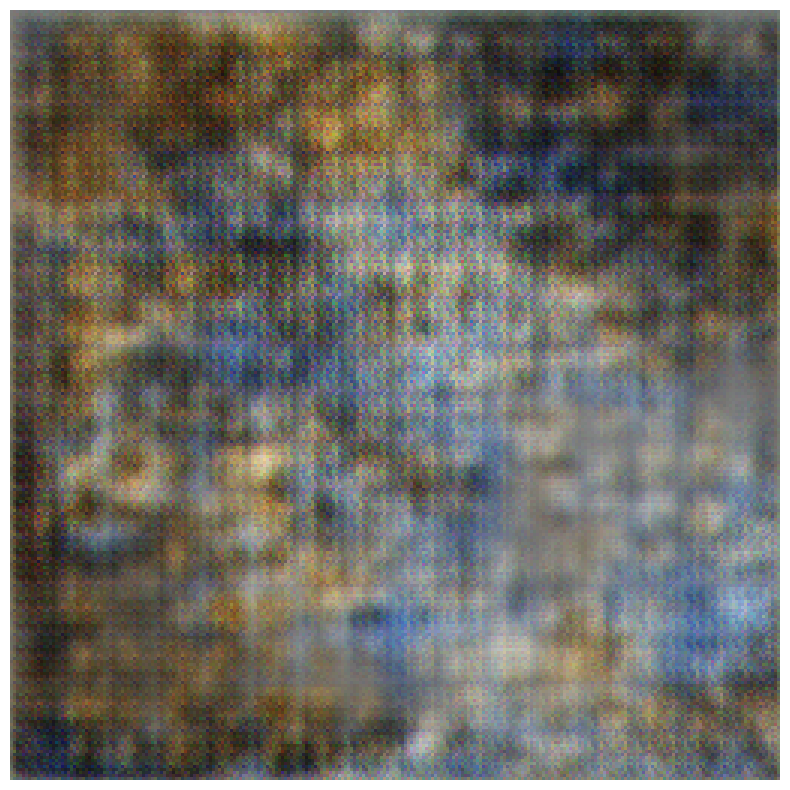

Training epoch 81/500
Training epoch 82/500
Training epoch 83/500
Training epoch 84/500
Training epoch 85/500
Training epoch 86/500
Training epoch 87/500
Training epoch 88/500
Training epoch 89/500
Training epoch 90/500
Training epoch 91/500
Training epoch 92/500
Training epoch 93/500
Training epoch 94/500
Training epoch 95/500
Training epoch 96/500
Training epoch 97/500
Training epoch 98/500
Training epoch 99/500
Training epoch 100/500
generator loss: 1.0912270545959473    discriminator loss: 1.1627006530761719
Time for epoch 100 is 10.19756523768107 min


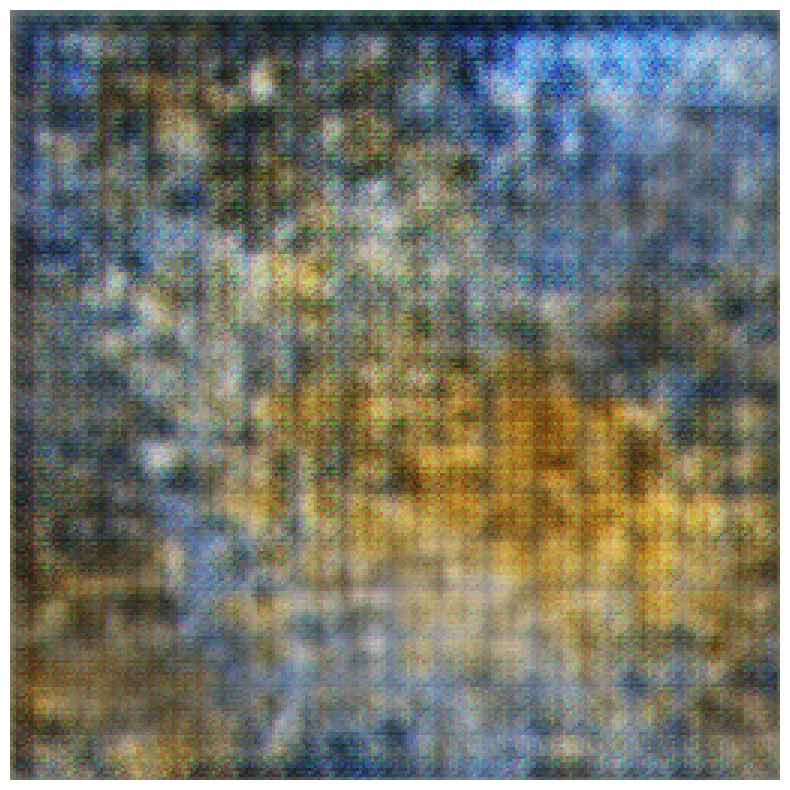

Training epoch 101/500
Training epoch 102/500
Training epoch 103/500
Training epoch 104/500
Training epoch 105/500
Training epoch 106/500
Training epoch 107/500
Training epoch 108/500
Training epoch 109/500
Training epoch 110/500
Training epoch 111/500
Training epoch 112/500
Training epoch 113/500
Training epoch 114/500
Training epoch 115/500
Training epoch 116/500
Training epoch 117/500
Training epoch 118/500
Training epoch 119/500
Training epoch 120/500
generator loss: 0.9602990746498108    discriminator loss: 1.2757877111434937
Time for epoch 120 is 12.248647117614746 min


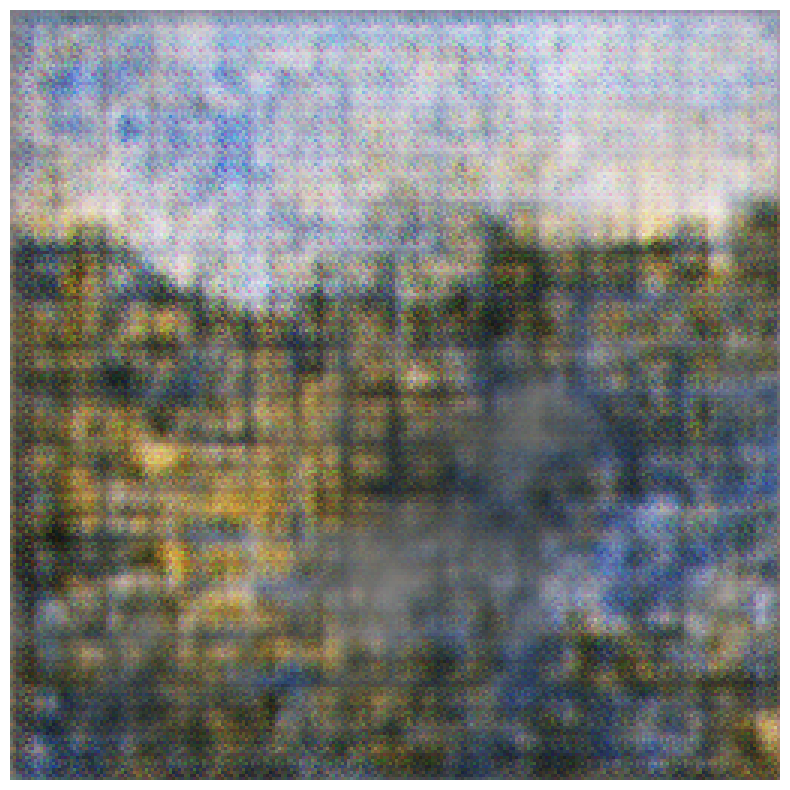

Training epoch 121/500
Training epoch 122/500
Training epoch 123/500
Training epoch 124/500
Training epoch 125/500
Training epoch 126/500
Training epoch 127/500
Training epoch 128/500
Training epoch 129/500
Training epoch 130/500
Training epoch 131/500
Training epoch 132/500
Training epoch 133/500
Training epoch 134/500
Training epoch 135/500
Training epoch 136/500
Training epoch 137/500
Training epoch 138/500
Training epoch 139/500
Training epoch 140/500
generator loss: 1.070853590965271    discriminator loss: 1.2091865539550781
Time for epoch 140 is 14.278166619936625 min


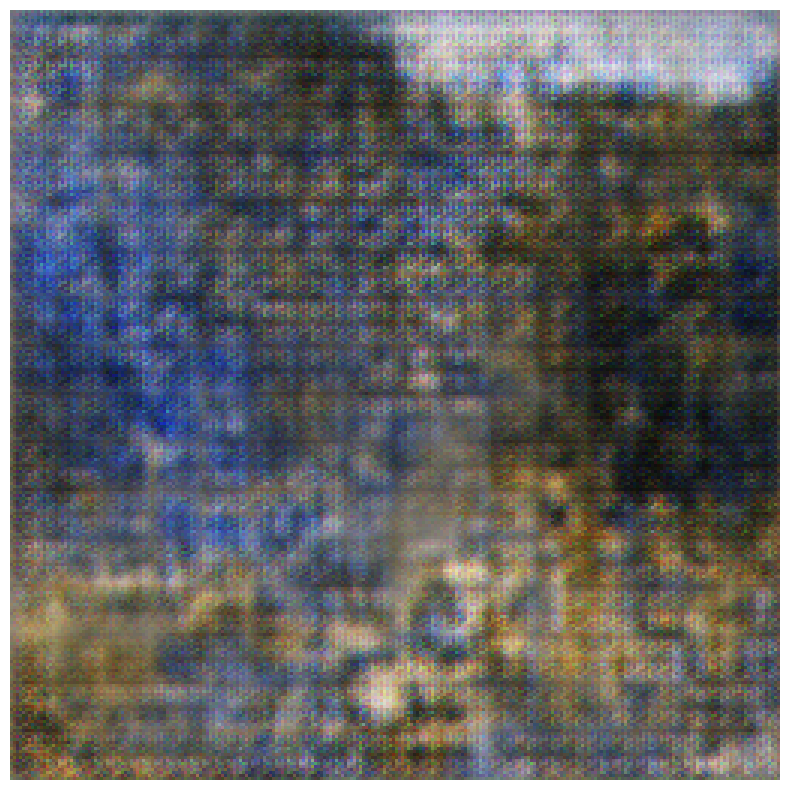

Training epoch 141/500
Training epoch 142/500
Training epoch 143/500
Training epoch 144/500
Training epoch 145/500
Training epoch 146/500
Training epoch 147/500
Training epoch 148/500
Training epoch 149/500
Training epoch 150/500
Training epoch 151/500
Training epoch 152/500
Training epoch 153/500
Training epoch 154/500
Training epoch 155/500
Training epoch 156/500
Training epoch 157/500
Training epoch 158/500
Training epoch 159/500
Training epoch 160/500
generator loss: 1.1220072507858276    discriminator loss: 1.324683427810669
Time for epoch 160 is 16.296270020802815 min


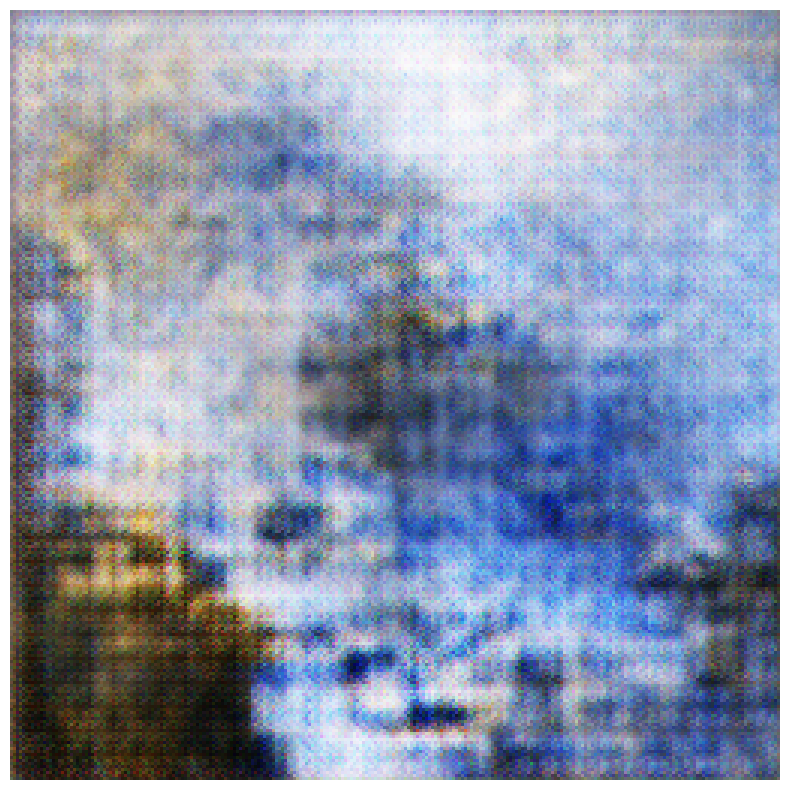

Training epoch 161/500
Training epoch 162/500
Training epoch 163/500
Training epoch 164/500
Training epoch 165/500
Training epoch 166/500
Training epoch 167/500
Training epoch 168/500
Training epoch 169/500
Training epoch 170/500
Training epoch 171/500
Training epoch 172/500
Training epoch 173/500
Training epoch 174/500
Training epoch 175/500
Training epoch 176/500
Training epoch 177/500
Training epoch 178/500
Training epoch 179/500
Training epoch 180/500
generator loss: 1.0988377332687378    discriminator loss: 1.1374223232269287
Time for epoch 180 is 18.3173068523407 min


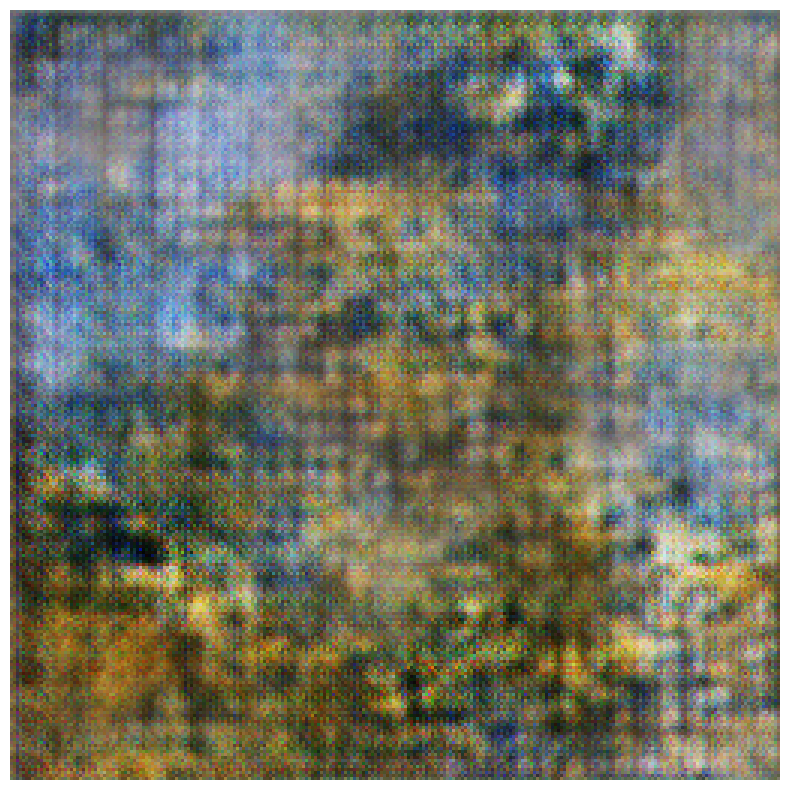

Training epoch 181/500
Training epoch 182/500
Training epoch 183/500
Training epoch 184/500
Training epoch 185/500
Training epoch 186/500
Training epoch 187/500
Training epoch 188/500
Training epoch 189/500
Training epoch 190/500
Training epoch 191/500
Training epoch 192/500
Training epoch 193/500
Training epoch 194/500
Training epoch 195/500
Training epoch 196/500
Training epoch 197/500
Training epoch 198/500
Training epoch 199/500
Training epoch 200/500
generator loss: 1.1398262977600098    discriminator loss: 1.1704415082931519
Time for epoch 200 is 20.33525093793869 min


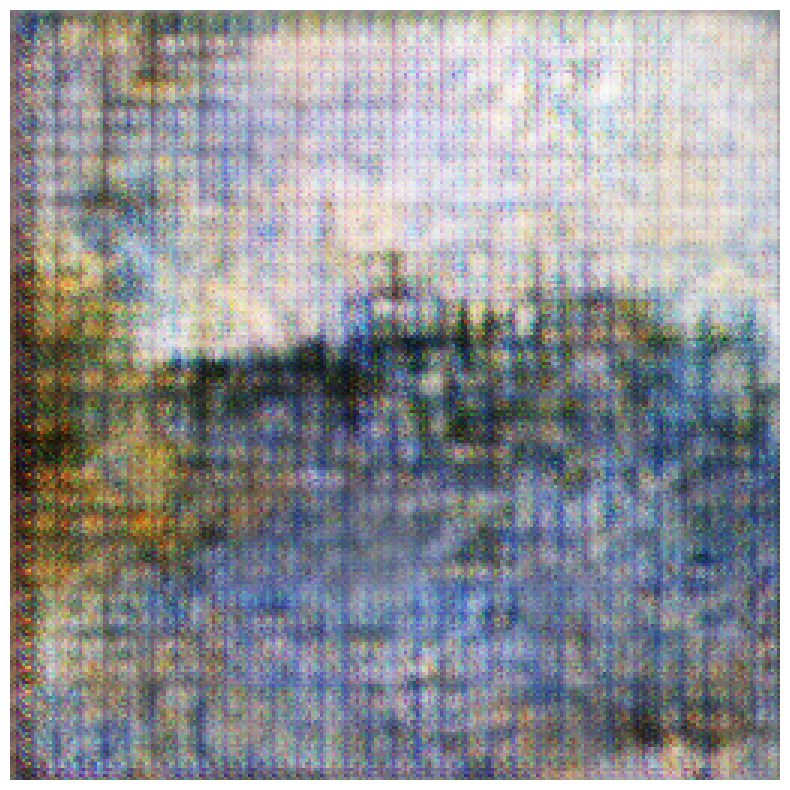

Training epoch 201/500
Training epoch 202/500
Training epoch 203/500
Training epoch 204/500
Training epoch 205/500
Training epoch 206/500
Training epoch 207/500
Training epoch 208/500
Training epoch 209/500
Training epoch 210/500
Training epoch 211/500
Training epoch 212/500
Training epoch 213/500
Training epoch 214/500
Training epoch 215/500
Training epoch 216/500
Training epoch 217/500
Training epoch 218/500
Training epoch 219/500
Training epoch 220/500
generator loss: 1.049439787864685    discriminator loss: 1.3656134605407715
Time for epoch 220 is 22.356762290000916 min


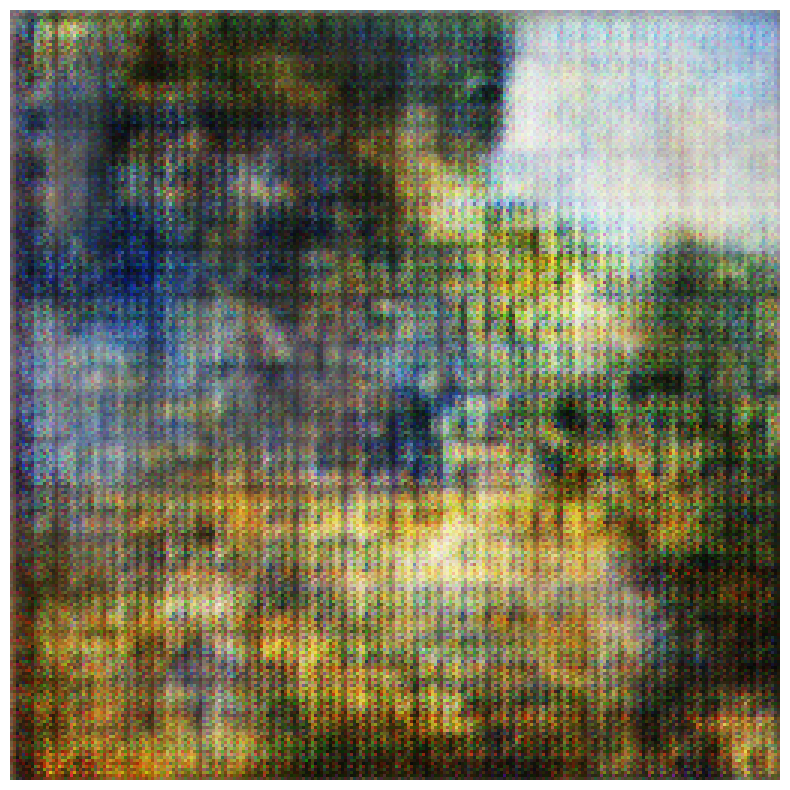

Training epoch 221/500
Training epoch 222/500
Training epoch 223/500
Training epoch 224/500
Training epoch 225/500
Training epoch 226/500
Training epoch 227/500
Training epoch 228/500
Training epoch 229/500
Training epoch 230/500
Training epoch 231/500
Training epoch 232/500
Training epoch 233/500
Training epoch 234/500
Training epoch 235/500
Training epoch 236/500
Training epoch 237/500
Training epoch 238/500
Training epoch 239/500
Training epoch 240/500
generator loss: 1.0995972156524658    discriminator loss: 1.2429821491241455
Time for epoch 240 is 24.3712641398112 min


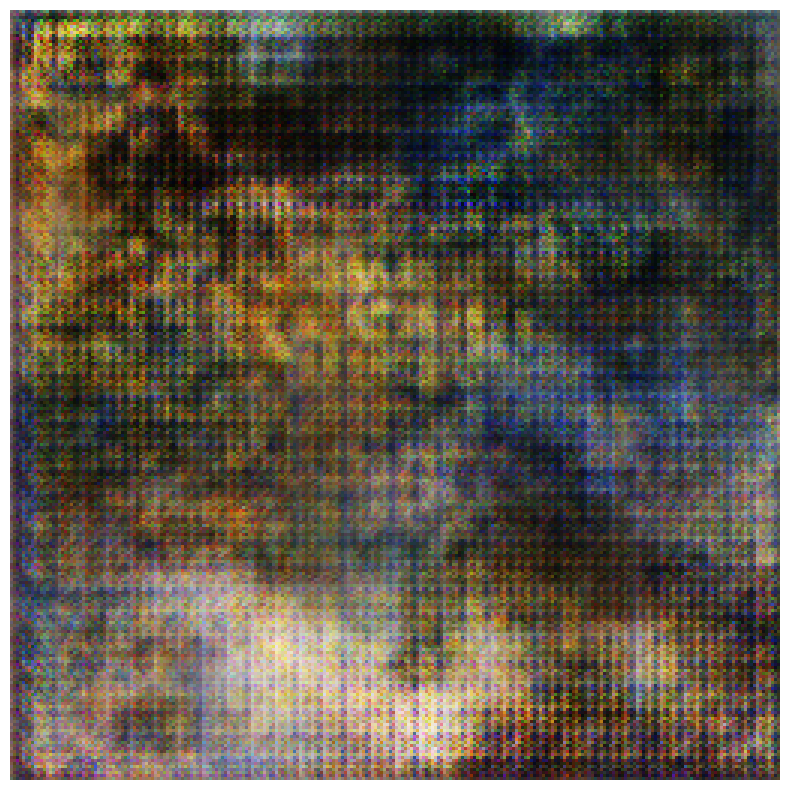

Training epoch 241/500
Training epoch 242/500
Training epoch 243/500
Training epoch 244/500
Training epoch 245/500
Training epoch 246/500
Training epoch 247/500
Training epoch 248/500
Training epoch 249/500
Training epoch 250/500
Training epoch 251/500
Training epoch 252/500
Training epoch 253/500
Training epoch 254/500
Training epoch 255/500
Training epoch 256/500
Training epoch 257/500
Training epoch 258/500
Training epoch 259/500
Training epoch 260/500
generator loss: 1.1329169273376465    discriminator loss: 1.094693660736084
Time for epoch 260 is 26.390731302897134 min


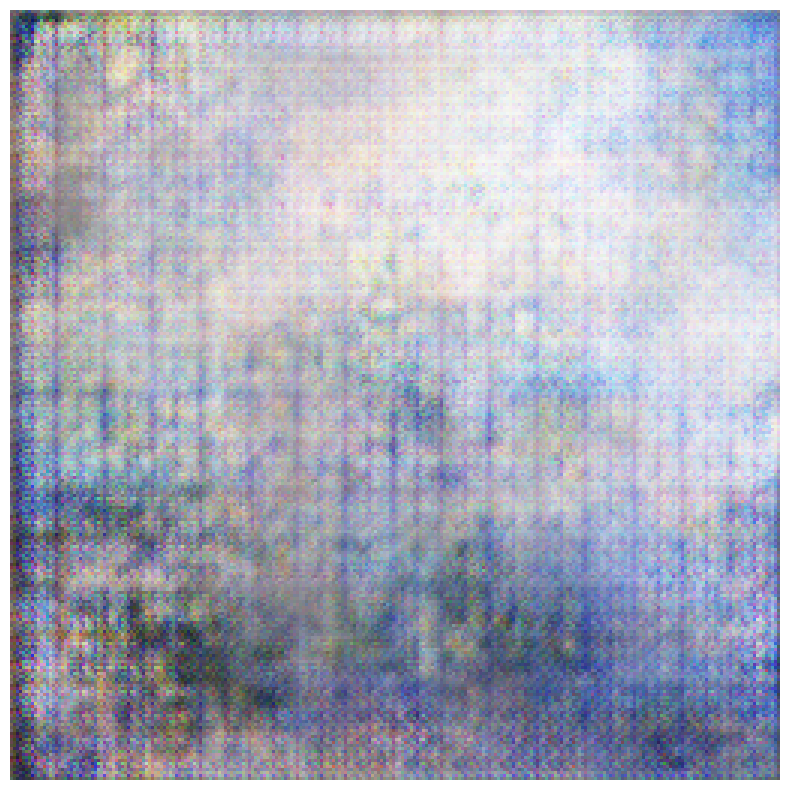

Training epoch 261/500
Training epoch 262/500
Training epoch 263/500
Training epoch 264/500
Training epoch 265/500
Training epoch 266/500
Training epoch 267/500
Training epoch 268/500
Training epoch 269/500
Training epoch 270/500
Training epoch 271/500
Training epoch 272/500
Training epoch 273/500
Training epoch 274/500
Training epoch 275/500
Training epoch 276/500
Training epoch 277/500
Training epoch 278/500
Training epoch 279/500
Training epoch 280/500
generator loss: 1.1457667350769043    discriminator loss: 1.1771348714828491
Time for epoch 280 is 28.42338833808899 min


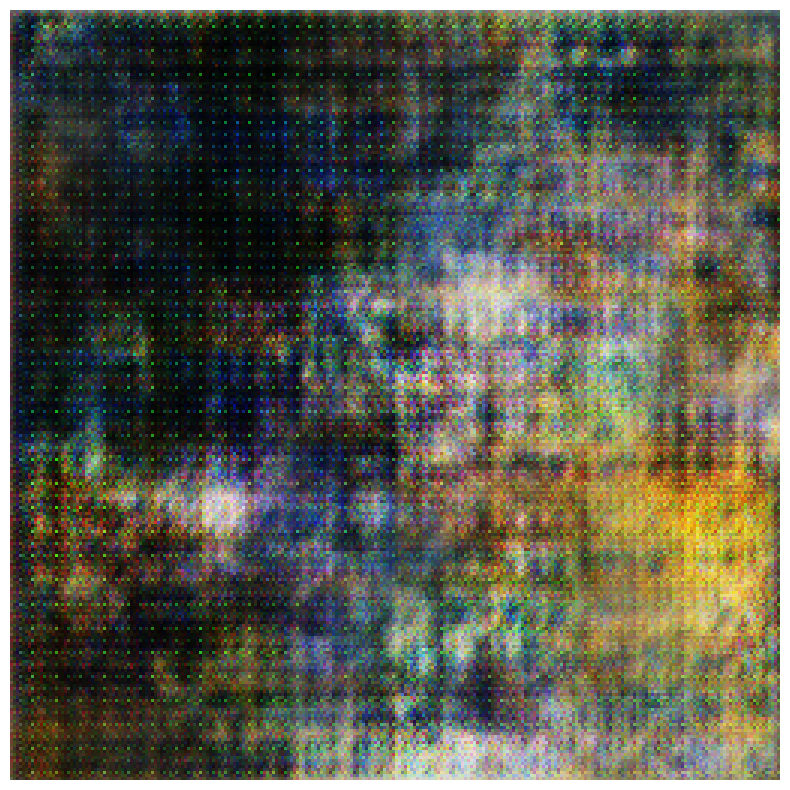

Training epoch 281/500
Training epoch 282/500
Training epoch 283/500
Training epoch 284/500
Training epoch 285/500
Training epoch 286/500
Training epoch 287/500
Training epoch 288/500
Training epoch 289/500
Training epoch 290/500
Training epoch 291/500
Training epoch 292/500
Training epoch 293/500
Training epoch 294/500
Training epoch 295/500
Training epoch 296/500
Training epoch 297/500
Training epoch 298/500
Training epoch 299/500
Training epoch 300/500
generator loss: 1.0929292440414429    discriminator loss: 1.227514386177063
Time for epoch 300 is 30.45901903708776 min


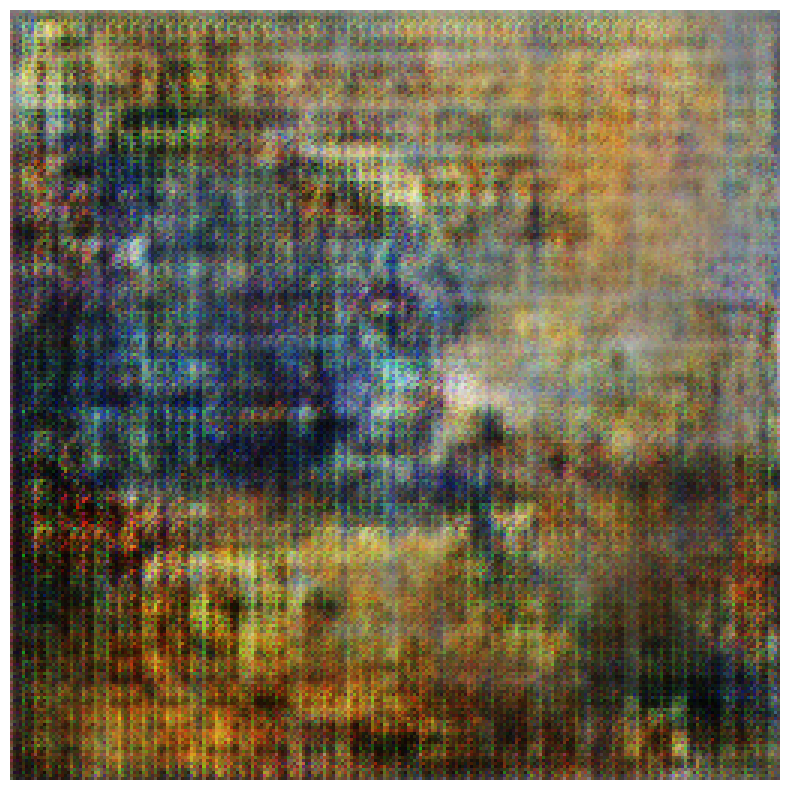

Training epoch 301/500
Training epoch 302/500
Training epoch 303/500
Training epoch 304/500
Training epoch 305/500
Training epoch 306/500
Training epoch 307/500
Training epoch 308/500
Training epoch 309/500
Training epoch 310/500
Training epoch 311/500
Training epoch 312/500
Training epoch 313/500
Training epoch 314/500
Training epoch 315/500
Training epoch 316/500
Training epoch 317/500
Training epoch 318/500
Training epoch 319/500
Training epoch 320/500
generator loss: 1.1656748056411743    discriminator loss: 1.0845422744750977
Time for epoch 320 is 32.488540422916415 min


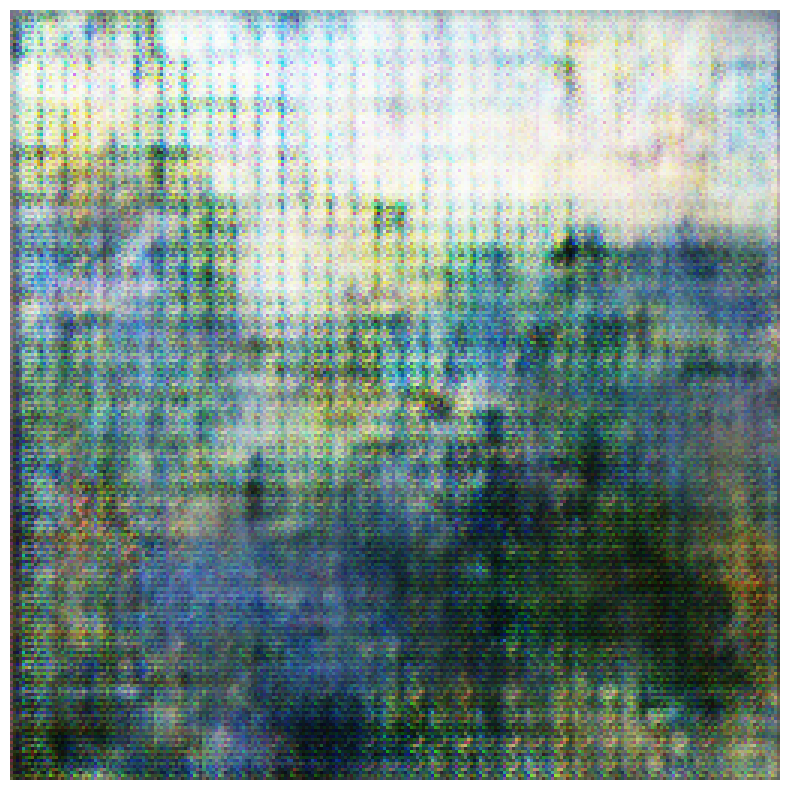

Training epoch 321/500
Training epoch 322/500
Training epoch 323/500
Training epoch 324/500
Training epoch 325/500
Training epoch 326/500
Training epoch 327/500
Training epoch 328/500
Training epoch 329/500
Training epoch 330/500
Training epoch 331/500
Training epoch 332/500
Training epoch 333/500
Training epoch 334/500
Training epoch 335/500
Training epoch 336/500
Training epoch 337/500
Training epoch 338/500
Training epoch 339/500
Training epoch 340/500
generator loss: 1.2065927982330322    discriminator loss: 1.0923982858657837
Time for epoch 340 is 34.509265287717184 min


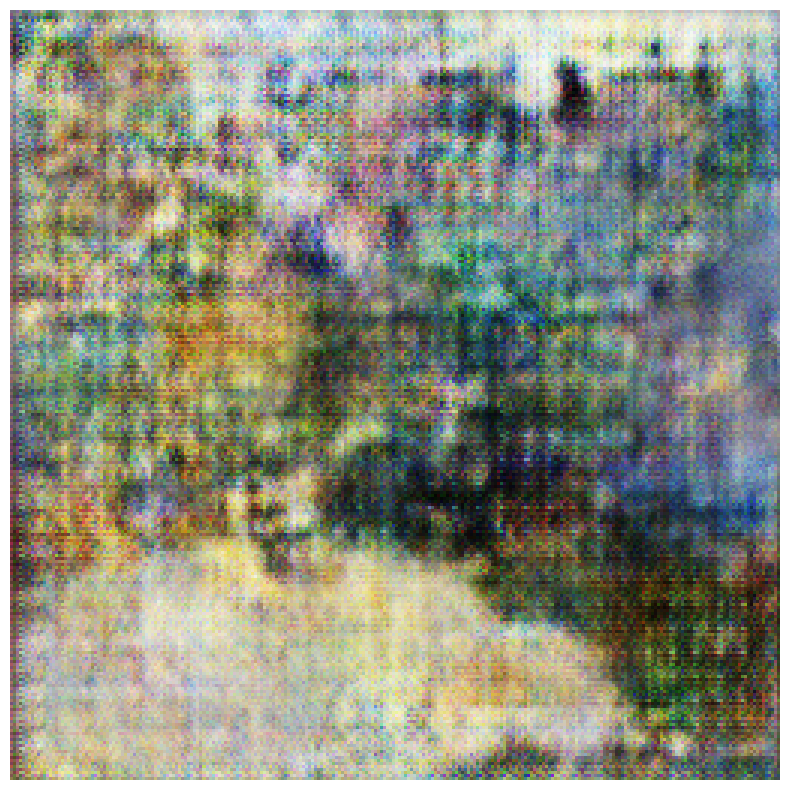

Training epoch 341/500
Training epoch 342/500
Training epoch 343/500
Training epoch 344/500
Training epoch 345/500
Training epoch 346/500
Training epoch 347/500
Training epoch 348/500
Training epoch 349/500
Training epoch 350/500
Training epoch 351/500
Training epoch 352/500
Training epoch 353/500
Training epoch 354/500
Training epoch 355/500
Training epoch 356/500
Training epoch 357/500
Training epoch 358/500
Training epoch 359/500
Training epoch 360/500
generator loss: 1.1770395040512085    discriminator loss: 1.1491217613220215
Time for epoch 360 is 36.53605486949285 min


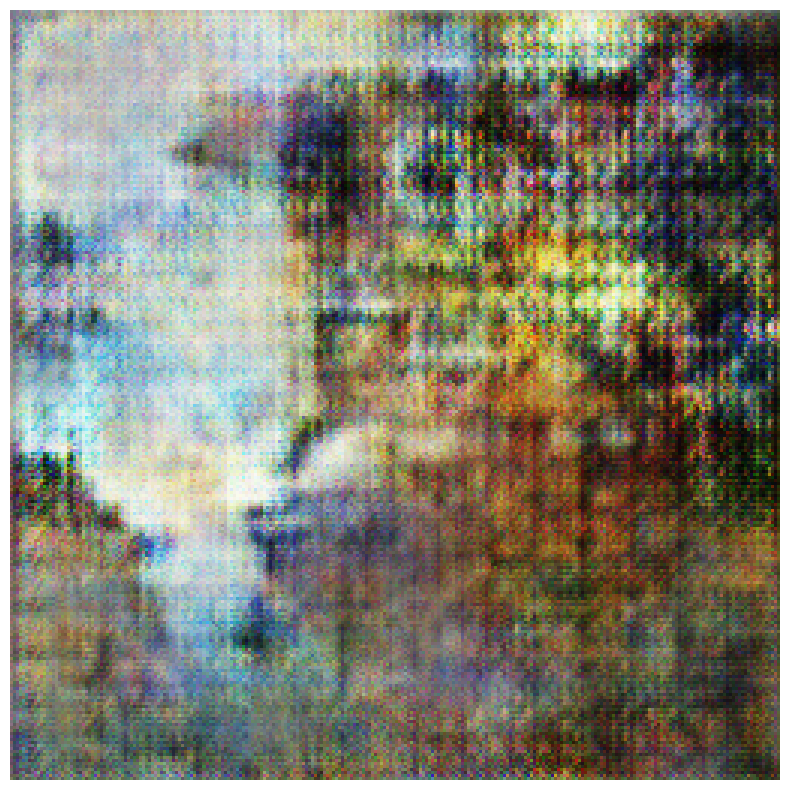

Training epoch 361/500
Training epoch 362/500
Training epoch 363/500
Training epoch 364/500
Training epoch 365/500
Training epoch 366/500
Training epoch 367/500
Training epoch 368/500
Training epoch 369/500
Training epoch 370/500
Training epoch 371/500
Training epoch 372/500
Training epoch 373/500
Training epoch 374/500
Training epoch 375/500
Training epoch 376/500
Training epoch 377/500
Training epoch 378/500
Training epoch 379/500
Training epoch 380/500
generator loss: 1.1581697463989258    discriminator loss: 1.0253080129623413
Time for epoch 380 is 38.567120285828906 min


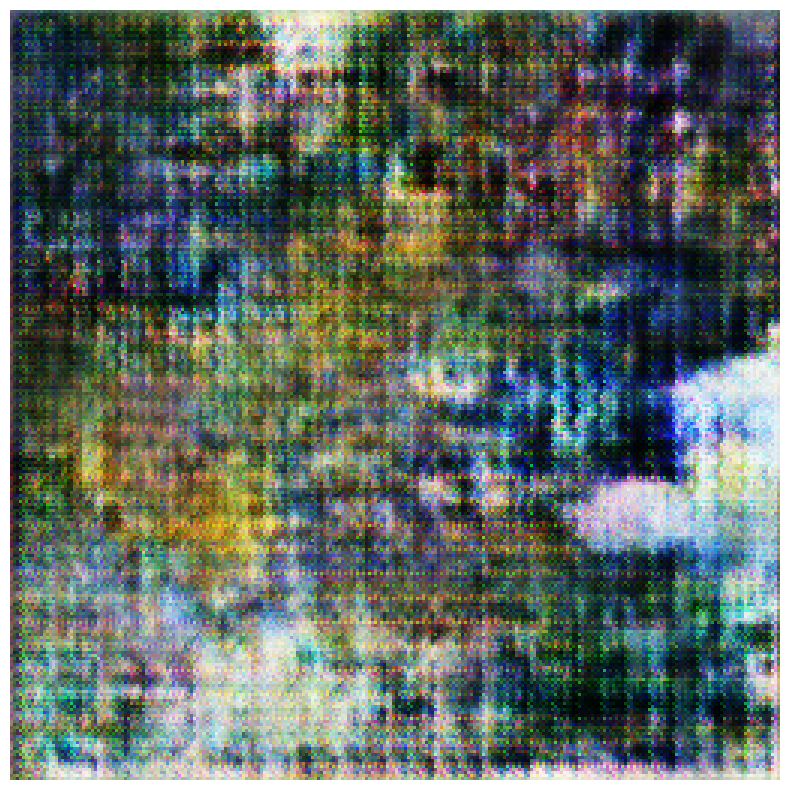

Training epoch 381/500
Training epoch 382/500
Training epoch 383/500
Training epoch 384/500
Training epoch 385/500
Training epoch 386/500
Training epoch 387/500
Training epoch 388/500
Training epoch 389/500
Training epoch 390/500
Training epoch 391/500
Training epoch 392/500
Training epoch 393/500
Training epoch 394/500
Training epoch 395/500
Training epoch 396/500
Training epoch 397/500
Training epoch 398/500
Training epoch 399/500
Training epoch 400/500
generator loss: 1.1401768922805786    discriminator loss: 1.0002423524856567
Time for epoch 400 is 40.59010725418727 min


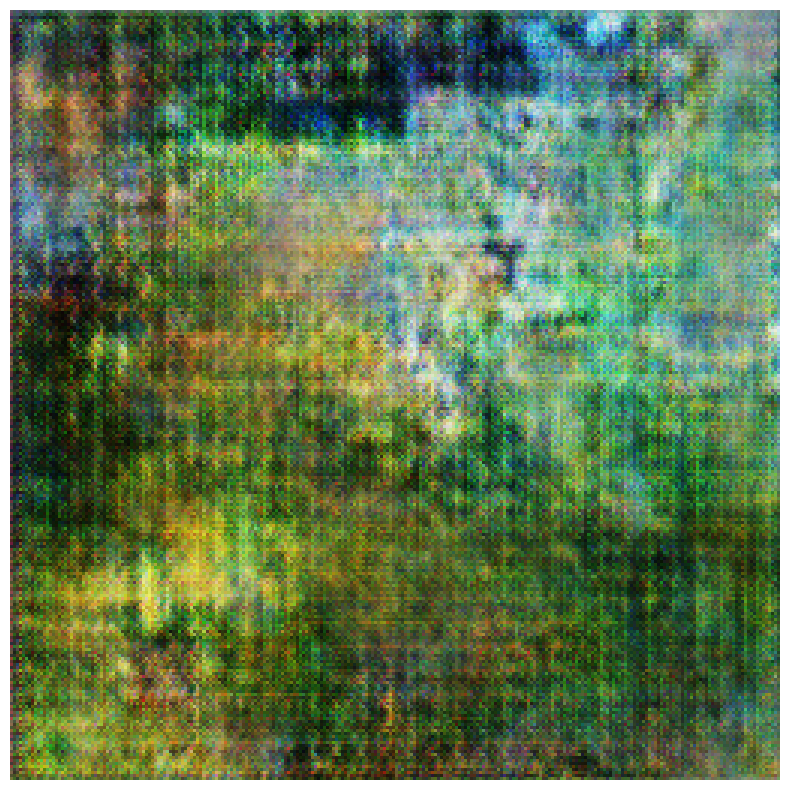

Training epoch 401/500
Training epoch 402/500
Training epoch 403/500
Training epoch 404/500
Training epoch 405/500
Training epoch 406/500
Training epoch 407/500
Training epoch 408/500
Training epoch 409/500
Training epoch 410/500
Training epoch 411/500
Training epoch 412/500
Training epoch 413/500
Training epoch 414/500
Training epoch 415/500
Training epoch 416/500
Training epoch 417/500
Training epoch 418/500
Training epoch 419/500
Training epoch 420/500
generator loss: 1.284457802772522    discriminator loss: 0.9508967995643616
Time for epoch 420 is 42.61239005327225 min


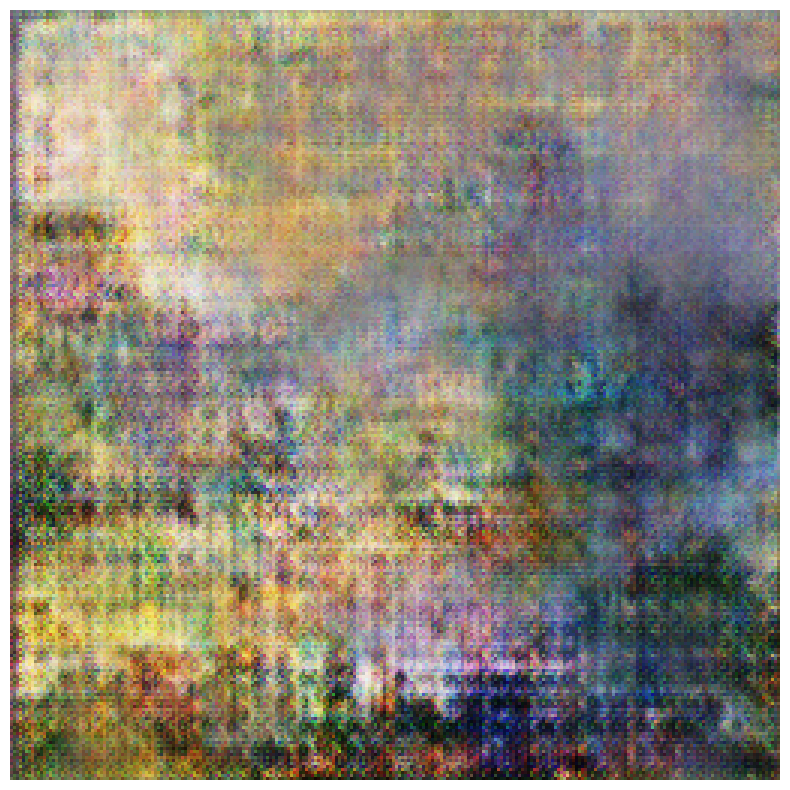

Training epoch 421/500
Training epoch 422/500
Training epoch 423/500
Training epoch 424/500
Training epoch 425/500
Training epoch 426/500
Training epoch 427/500
Training epoch 428/500
Training epoch 429/500
Training epoch 430/500
Training epoch 431/500
Training epoch 432/500
Training epoch 433/500
Training epoch 434/500
Training epoch 435/500
Training epoch 436/500
Training epoch 437/500
Training epoch 438/500
Training epoch 439/500
Training epoch 440/500
generator loss: 1.3249505758285522    discriminator loss: 1.032935380935669
Time for epoch 440 is 44.633652905623116 min


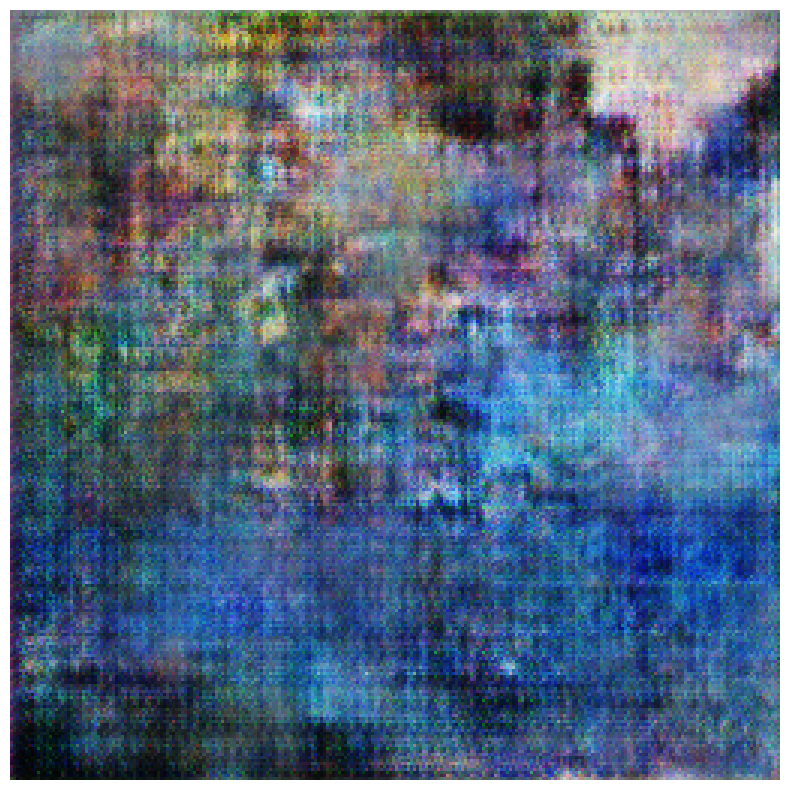

Training epoch 441/500
Training epoch 442/500
Training epoch 443/500
Training epoch 444/500
Training epoch 445/500
Training epoch 446/500
Training epoch 447/500
Training epoch 448/500
Training epoch 449/500
Training epoch 450/500
Training epoch 451/500
Training epoch 452/500
Training epoch 453/500
Training epoch 454/500
Training epoch 455/500
Training epoch 456/500
Training epoch 457/500
Training epoch 458/500
Training epoch 459/500
Training epoch 460/500
generator loss: 1.3086678981781006    discriminator loss: 1.0877512693405151
Time for epoch 460 is 46.67079861958822 min


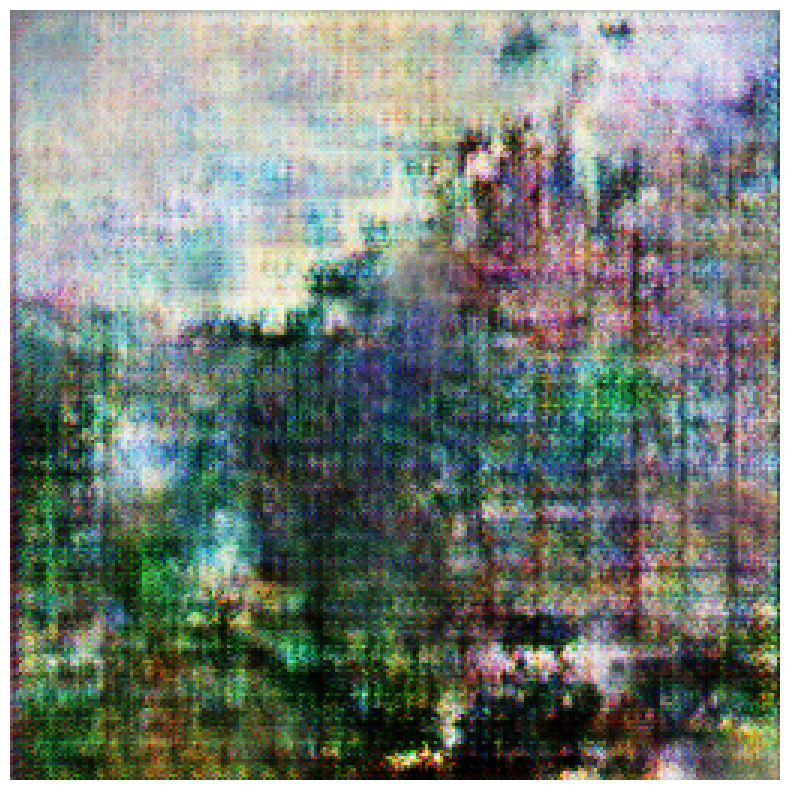

Training epoch 461/500
Training epoch 462/500
Training epoch 463/500
Training epoch 464/500
Training epoch 465/500
Training epoch 466/500
Training epoch 467/500
Training epoch 468/500
Training epoch 469/500
Training epoch 470/500
Training epoch 471/500
Training epoch 472/500
Training epoch 473/500
Training epoch 474/500
Training epoch 475/500
Training epoch 476/500
Training epoch 477/500
Training epoch 478/500
Training epoch 479/500
Training epoch 480/500
generator loss: 1.3856403827667236    discriminator loss: 1.0197397470474243
Time for epoch 480 is 48.72795725266139 min


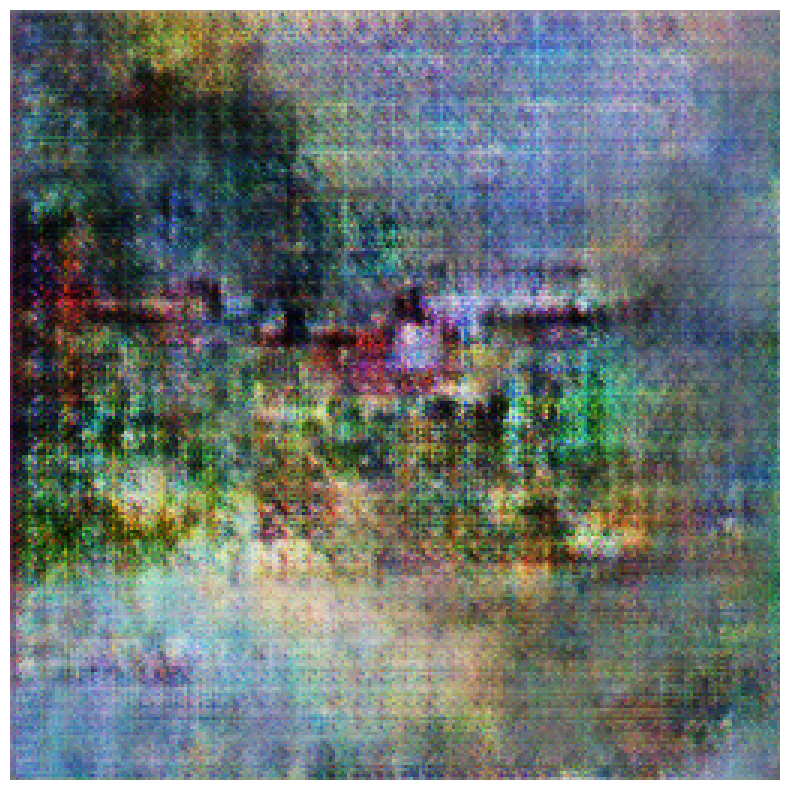

Training epoch 481/500
Training epoch 482/500
Training epoch 483/500
Training epoch 484/500
Training epoch 485/500
Training epoch 486/500
Training epoch 487/500
Training epoch 488/500
Training epoch 489/500
Training epoch 490/500
Training epoch 491/500
Training epoch 492/500
Training epoch 493/500
Training epoch 494/500
Training epoch 495/500
Training epoch 496/500
Training epoch 497/500
Training epoch 498/500
Training epoch 499/500
Training epoch 500/500
generator loss: 1.523496389389038    discriminator loss: 0.8229340314865112
Time for epoch 500 is 50.77967260281245 min


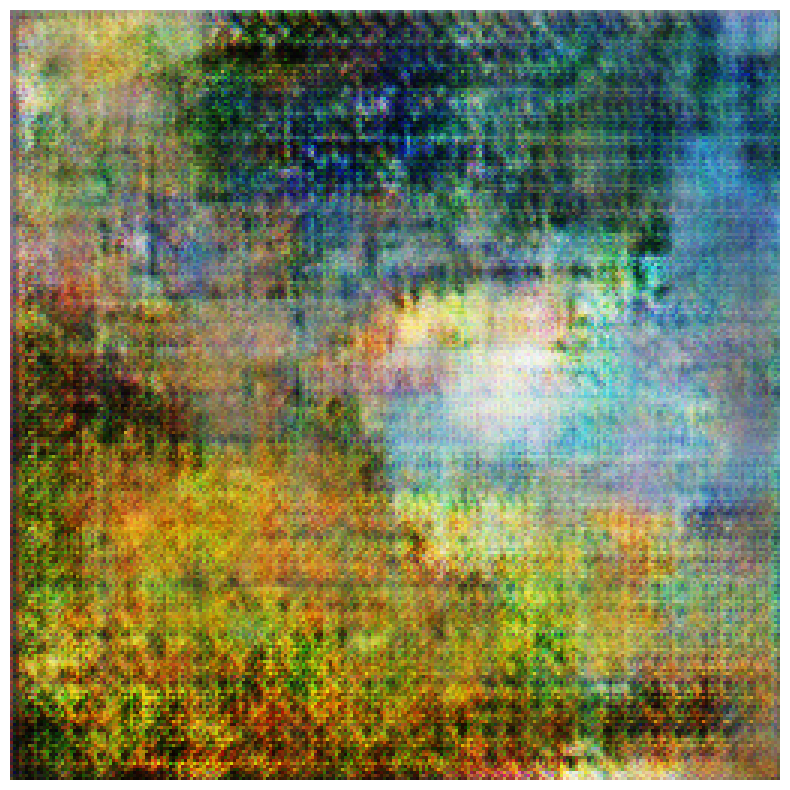

In [21]:
#Train the model
discriminator_loss_0, generation_loss_0=train(img_monet, EPOCHS)


The model runs through 500 epochs. We see that the generated images have more similar color to Monet painting at the end of the training. This is a good sign. It shows that the model is learning.

Let's generate some other images with the generator model.

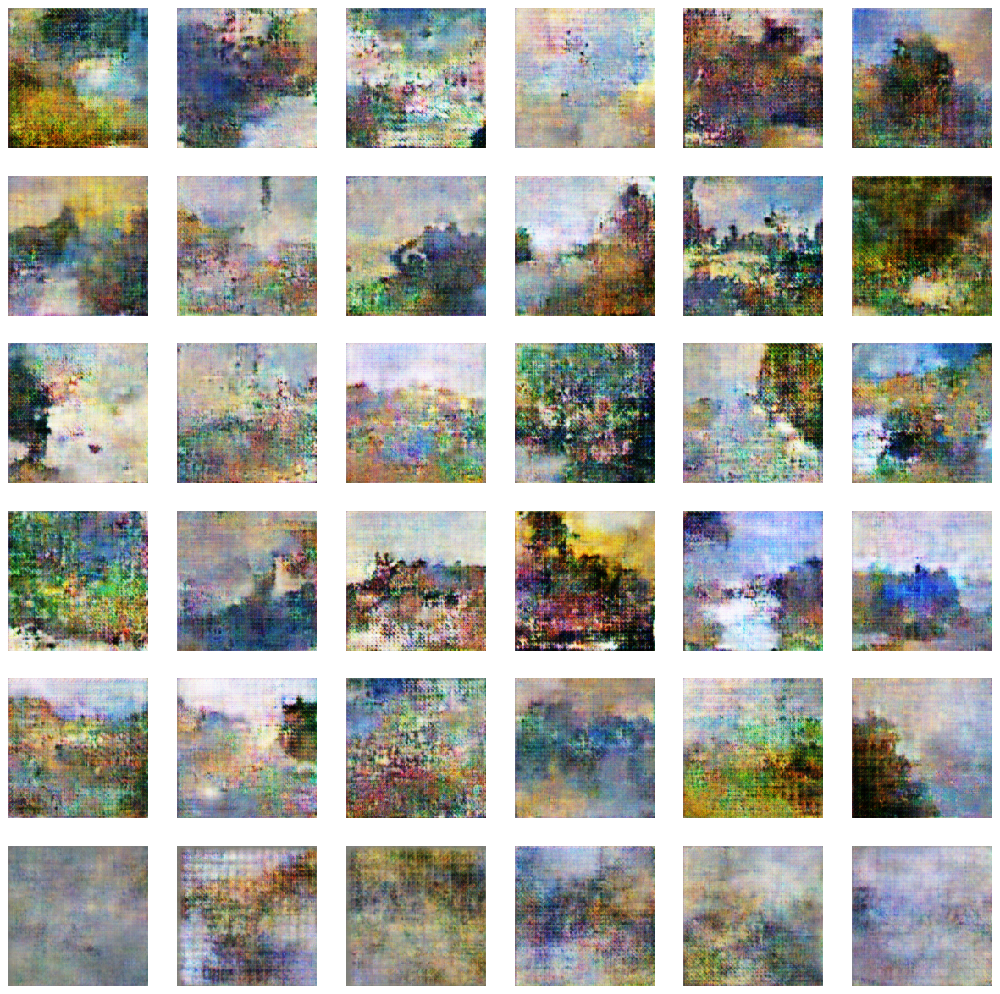

In [38]:
noise = tf.random.normal([36, noise_dim])
predictions = generator(noise, training=False)

fig = plt.figure(figsize=(15, 15))
for i in range(36):
    plt.subplot(6, 6, i + 1)
    plt.imshow((np.array((predictions[i]+1)*127.5).astype(int)))     
    plt.axis('off')

plt.show()

The images are blurry with a weird discoloring in some part. The color looks a bit weird here and the images are not smooth.

Let's plot the loss over epoch to see how my model performs.

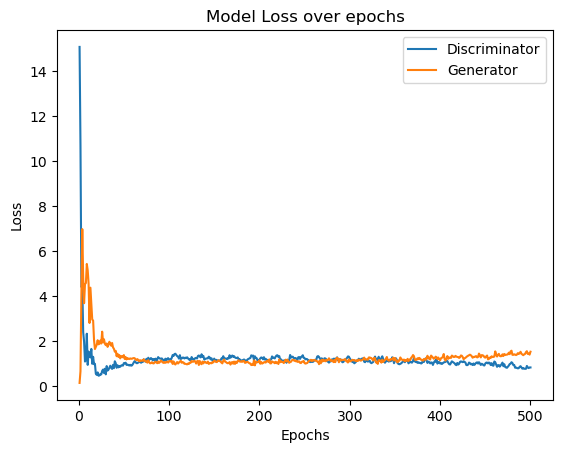

In [133]:
#Plot discriminator and generator loss
x=np.array(range(EPOCHS))+1

plt.plot(x, discriminator_loss_0, label = "Discriminator")
plt.plot(x, generation_loss_0, label = "Generator")
plt.title("Model Loss over epochs")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

The model has high discriminator loss at first. Then, as the discriminator gets better, the generator loss increases. After epoch 80, both the losses don't improve that much. This is until around epoch 400, when the discriminator loss decreases and generator loss increases. We also see that in the images the model generates over the epochs. at epoch 80-400, the generated images look similar.

The model works fine but the generated images look weird and rough. Let's try to improve this model.


## DCGAN Model with additional batch normalization

To improve the previous model, I add batch normalization layers after each transpose convolutional layer in the genrator. This would be helpful because the prevous generated images look rough with a lot of sudden changes in color. The batch nrmalization usually helps with smoothening the images.

In [33]:
discriminator1 = keras.Sequential(
    [
        keras.Input(shape=(256, 256, 3)),
        layers.Conv2D(32, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2D(64, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(128, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(256, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(512, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Flatten(),
        layers.Dropout(0.3),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator1",
)
discriminator1.summary()

Model: "discriminator1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_12 (Conv2D)          (None, 128, 128, 32)      896       
                                                                 
 leaky_re_lu_18 (LeakyReLU)  (None, 128, 128, 32)      0         
                                                                 
 conv2d_13 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 batch_normalization_8 (Bat  (None, 64, 64, 64)        256       
 chNormalization)                                                
                                                                 
 leaky_re_lu_19 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_14 (Conv2D)          (None, 32, 32, 128)       73856     
                                                    

In [34]:
latent_dim = 100

generator1 = keras.Sequential(
    [
        keras.Input(shape=(latent_dim,)),
        layers.Dense(16 * 16 * 512),
        layers.Reshape((16, 16, 512)),
        layers.Conv2DTranspose(256, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(128, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(64, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(32, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(3, kernel_size=(3, 3),strides=(1, 1), padding="same", activation="tanh"),
    ],
    name="generator1",
)
generator1.summary()

Model: "generator1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_5 (Dense)             (None, 131072)            13238272  
                                                                 
 reshape_2 (Reshape)         (None, 16, 16, 512)       0         
                                                                 
 conv2d_transpose_8 (Conv2D  (None, 32, 32, 256)       1179904   
 Transpose)                                                      
                                                                 
 batch_normalization_12 (Ba  (None, 32, 32, 256)       1024      
 tchNormalization)                                               
                                                                 
 leaky_re_lu_23 (LeakyReLU)  (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose_9 (Conv2D  (None, 64, 64, 128)       2

In [55]:
def train_step1(d_loss, g_loss,images):
        
    noise = np.random.normal(size=(images.shape[0], noise_dim))
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator1(noise, training=True)
        real_output = discriminator1(images, training=True)
        fake_output = discriminator1(generated_images, training=True)
        
        disc_loss = discriminator_loss(real_output, fake_output)
        gen_loss = generator_loss(fake_output)


        #Store the loss
        d_loss.append(disc_loss)
        g_loss.append(gen_loss)

        gradients_of_generator = gen_tape.gradient(gen_loss, generator1.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator1.trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator1.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator1.trainable_variables))

    return d_loss, g_loss

In [56]:
def train1(dataset, epochs):
    discriminator_loss_hist, generation_loss_hist=[],[]
    start = time.time()
    for epoch in range(epochs):
        print('Training epoch {}/{}'.format(epoch+1, epochs))
        d_loss, g_loss = [], []

        for batch in dataset:
            d_loss, g_loss=train_step1(d_loss, g_loss, batch)

        
        #Store history of loss
        discriminator_loss_hist.append(np.mean(d_loss))
        generation_loss_hist.append(np.mean(g_loss)) 
        if (epoch+1) % 20 == 0:                                  
            print('generator loss: {}    discriminator loss: {}'.format( generation_loss_hist[-1],discriminator_loss_hist[-1]))
            print ('Time for epoch {} is {} min'.format(epoch + 1, (time.time()-start)/60))
            generate_and_save_images1(generator1,epoch+1,seed)
    return discriminator_loss_hist, generation_loss_hist

In [57]:
def generate_and_save_images1(model, epoch, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10, 10))
    
    plt.imshow((np.array((predictions[0]+1)*127.5).astype(int)))     
    plt.axis('off')

    plt.savefig('image_1_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

Let's also train the new model for 500 epochs.

Training epoch 1/500
Training epoch 2/500
Training epoch 3/500
Training epoch 4/500
Training epoch 5/500
Training epoch 6/500
Training epoch 7/500
Training epoch 8/500
Training epoch 9/500
Training epoch 10/500
Training epoch 11/500
Training epoch 12/500
Training epoch 13/500
Training epoch 14/500
Training epoch 15/500
Training epoch 16/500
Training epoch 17/500
Training epoch 18/500
Training epoch 19/500
Training epoch 20/500
generator loss: 2.246628522872925    discriminator loss: 0.9110828638076782
Time for epoch 20 is 2.3708340326944985 min


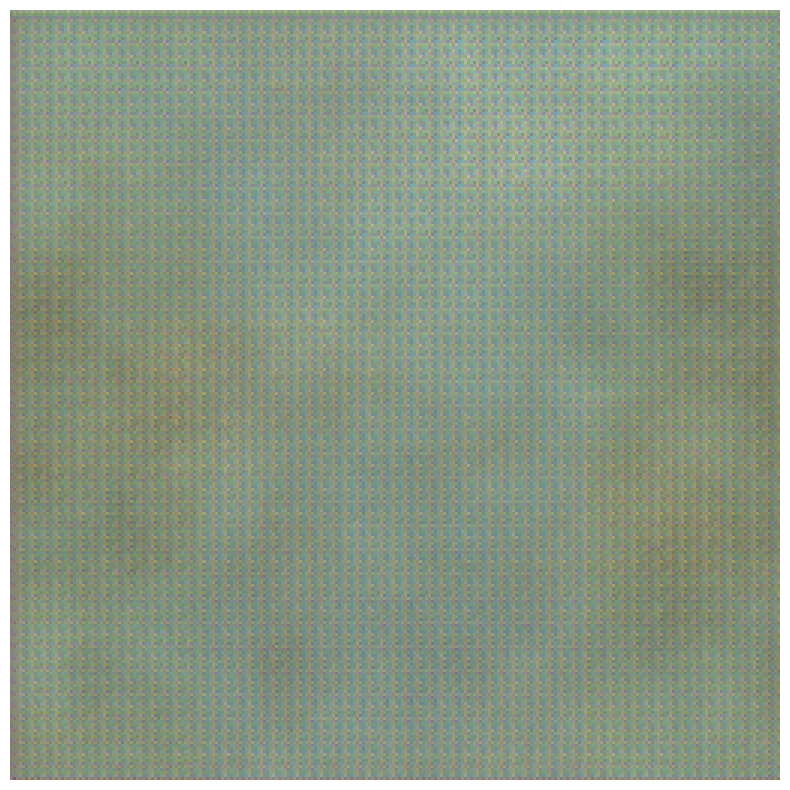

Training epoch 21/500
Training epoch 22/500
Training epoch 23/500
Training epoch 24/500
Training epoch 25/500
Training epoch 26/500
Training epoch 27/500
Training epoch 28/500
Training epoch 29/500
Training epoch 30/500
Training epoch 31/500
Training epoch 32/500
Training epoch 33/500
Training epoch 34/500
Training epoch 35/500
Training epoch 36/500
Training epoch 37/500
Training epoch 38/500
Training epoch 39/500
Training epoch 40/500
generator loss: 2.234473466873169    discriminator loss: 0.4455006420612335
Time for epoch 40 is 4.748009367783864 min


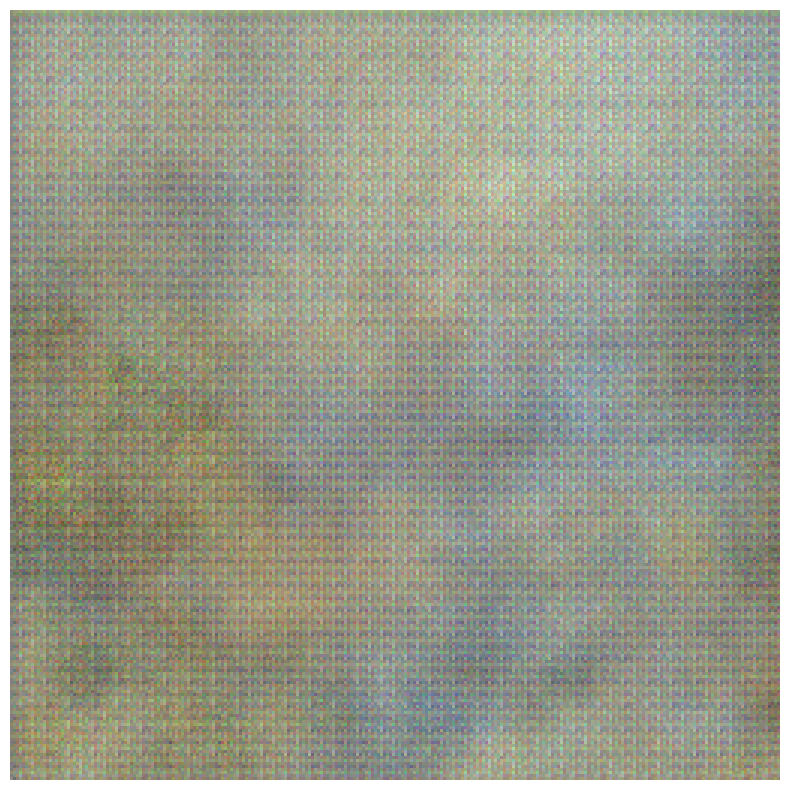

Training epoch 41/500
Training epoch 42/500
Training epoch 43/500
Training epoch 44/500
Training epoch 45/500
Training epoch 46/500
Training epoch 47/500
Training epoch 48/500
Training epoch 49/500
Training epoch 50/500
Training epoch 51/500
Training epoch 52/500
Training epoch 53/500
Training epoch 54/500
Training epoch 55/500
Training epoch 56/500
Training epoch 57/500
Training epoch 58/500
Training epoch 59/500
Training epoch 60/500
generator loss: 2.403883934020996    discriminator loss: 0.492379367351532
Time for epoch 60 is 7.072691766421 min


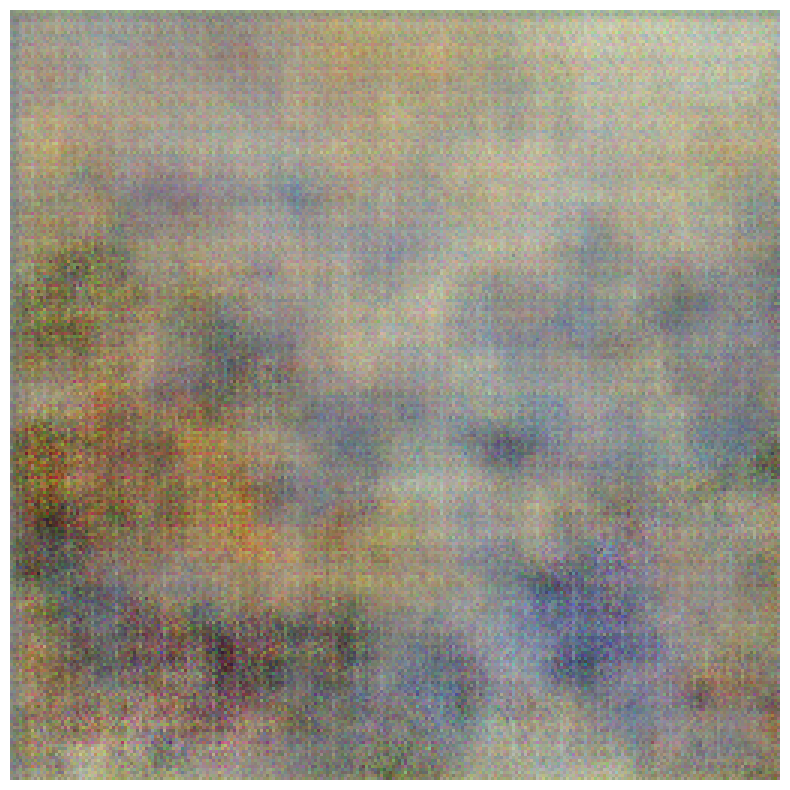

Training epoch 61/500
Training epoch 62/500
Training epoch 63/500
Training epoch 64/500
Training epoch 65/500
Training epoch 66/500
Training epoch 67/500
Training epoch 68/500
Training epoch 69/500
Training epoch 70/500
Training epoch 71/500
Training epoch 72/500
Training epoch 73/500
Training epoch 74/500
Training epoch 75/500
Training epoch 76/500
Training epoch 77/500
Training epoch 78/500
Training epoch 79/500
Training epoch 80/500
generator loss: 3.157038688659668    discriminator loss: 0.25603625178337097
Time for epoch 80 is 9.407257918516795 min


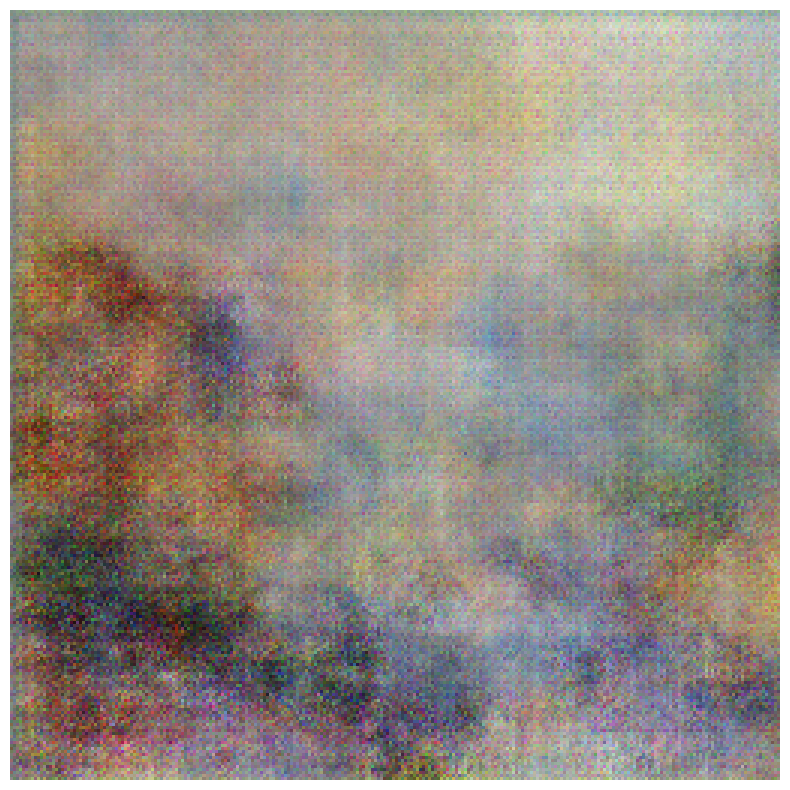

Training epoch 81/500
Training epoch 82/500
Training epoch 83/500
Training epoch 84/500
Training epoch 85/500
Training epoch 86/500
Training epoch 87/500
Training epoch 88/500
Training epoch 89/500
Training epoch 90/500
Training epoch 91/500
Training epoch 92/500
Training epoch 93/500
Training epoch 94/500
Training epoch 95/500
Training epoch 96/500
Training epoch 97/500
Training epoch 98/500
Training epoch 99/500
Training epoch 100/500
generator loss: 3.9149324893951416    discriminator loss: 0.21275533735752106
Time for epoch 100 is 11.744107099374135 min


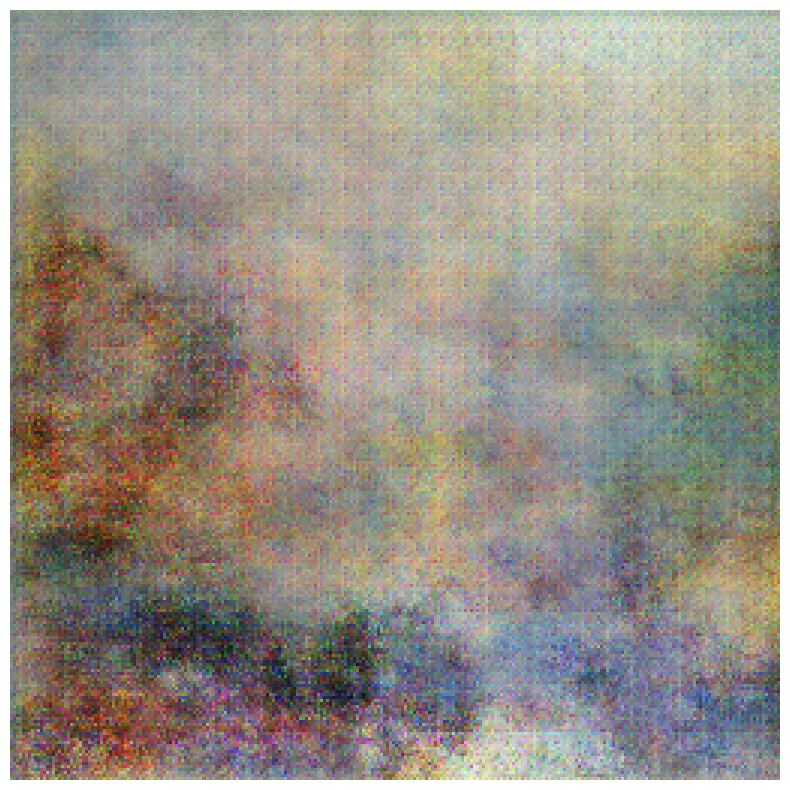

Training epoch 101/500
Training epoch 102/500
Training epoch 103/500
Training epoch 104/500
Training epoch 105/500
Training epoch 106/500
Training epoch 107/500
Training epoch 108/500
Training epoch 109/500
Training epoch 110/500
Training epoch 111/500
Training epoch 112/500
Training epoch 113/500
Training epoch 114/500
Training epoch 115/500
Training epoch 116/500
Training epoch 117/500
Training epoch 118/500
Training epoch 119/500
Training epoch 120/500
generator loss: 4.255399227142334    discriminator loss: 0.08677124232053757
Time for epoch 120 is 14.086607551574707 min


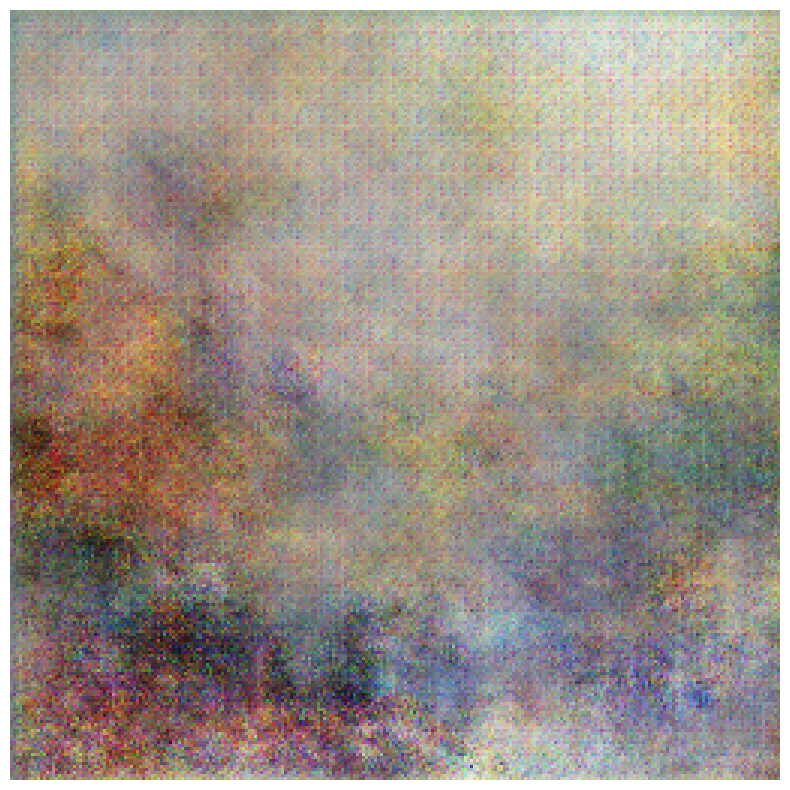

Training epoch 121/500
Training epoch 122/500
Training epoch 123/500
Training epoch 124/500
Training epoch 125/500
Training epoch 126/500
Training epoch 127/500
Training epoch 128/500
Training epoch 129/500
Training epoch 130/500
Training epoch 131/500
Training epoch 132/500
Training epoch 133/500
Training epoch 134/500
Training epoch 135/500
Training epoch 136/500
Training epoch 137/500
Training epoch 138/500
Training epoch 139/500
Training epoch 140/500
generator loss: 4.884986877441406    discriminator loss: 0.08287914097309113
Time for epoch 140 is 16.413491197427113 min


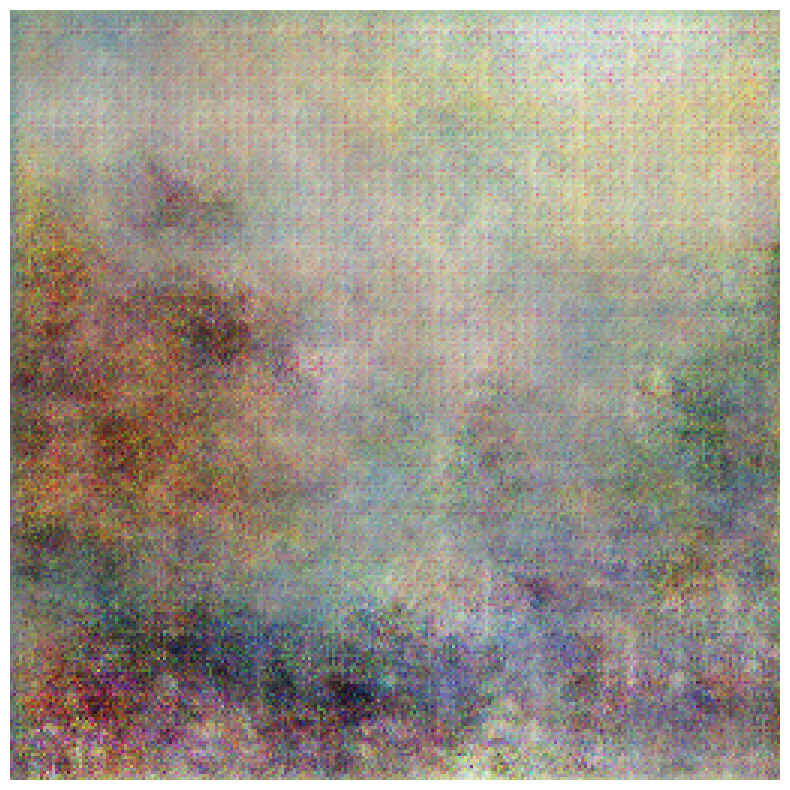

Training epoch 141/500
Training epoch 142/500
Training epoch 143/500
Training epoch 144/500
Training epoch 145/500
Training epoch 146/500
Training epoch 147/500
Training epoch 148/500
Training epoch 149/500
Training epoch 150/500
Training epoch 151/500
Training epoch 152/500
Training epoch 153/500
Training epoch 154/500
Training epoch 155/500
Training epoch 156/500
Training epoch 157/500
Training epoch 158/500
Training epoch 159/500
Training epoch 160/500
generator loss: 5.267273902893066    discriminator loss: 0.060226213186979294
Time for epoch 160 is 18.756174834569297 min


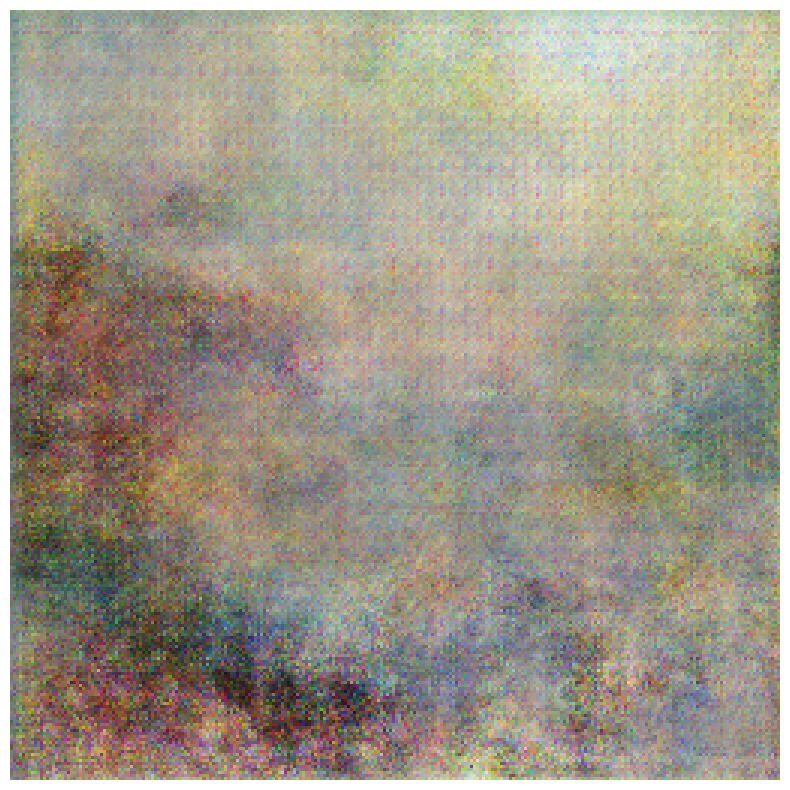

Training epoch 161/500
Training epoch 162/500
Training epoch 163/500
Training epoch 164/500
Training epoch 165/500
Training epoch 166/500
Training epoch 167/500
Training epoch 168/500
Training epoch 169/500
Training epoch 170/500
Training epoch 171/500
Training epoch 172/500
Training epoch 173/500
Training epoch 174/500
Training epoch 175/500
Training epoch 176/500
Training epoch 177/500
Training epoch 178/500
Training epoch 179/500
Training epoch 180/500
generator loss: 4.9651618003845215    discriminator loss: 0.06285969167947769
Time for epoch 180 is 21.098299650351205 min


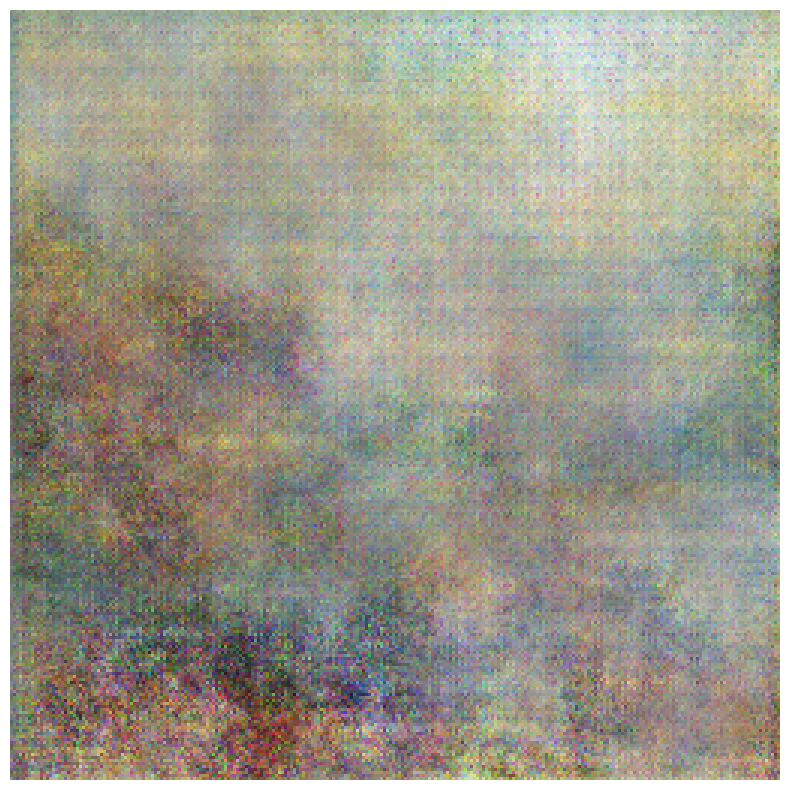

Training epoch 181/500
Training epoch 182/500
Training epoch 183/500
Training epoch 184/500
Training epoch 185/500
Training epoch 186/500
Training epoch 187/500
Training epoch 188/500
Training epoch 189/500
Training epoch 190/500
Training epoch 191/500
Training epoch 192/500
Training epoch 193/500
Training epoch 194/500
Training epoch 195/500
Training epoch 196/500
Training epoch 197/500
Training epoch 198/500
Training epoch 199/500
Training epoch 200/500
generator loss: 6.039117813110352    discriminator loss: 0.03771800547838211
Time for epoch 200 is 23.397269999980928 min


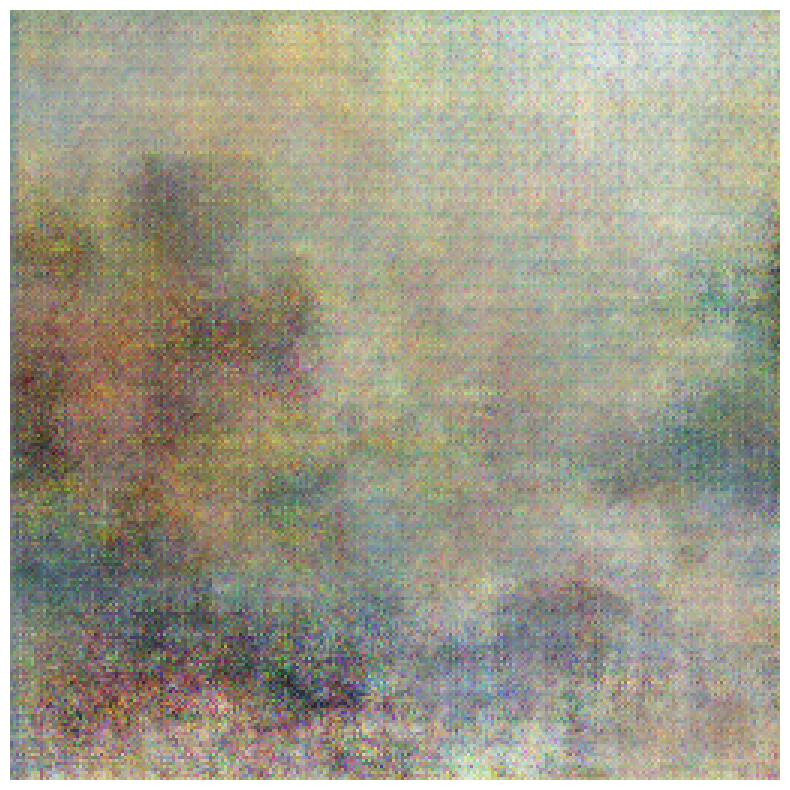

Training epoch 201/500
Training epoch 202/500
Training epoch 203/500
Training epoch 204/500
Training epoch 205/500
Training epoch 206/500
Training epoch 207/500
Training epoch 208/500
Training epoch 209/500
Training epoch 210/500
Training epoch 211/500
Training epoch 212/500
Training epoch 213/500
Training epoch 214/500
Training epoch 215/500
Training epoch 216/500
Training epoch 217/500
Training epoch 218/500
Training epoch 219/500
Training epoch 220/500
generator loss: 6.606393814086914    discriminator loss: 0.023306967690587044
Time for epoch 220 is 25.68122368256251 min


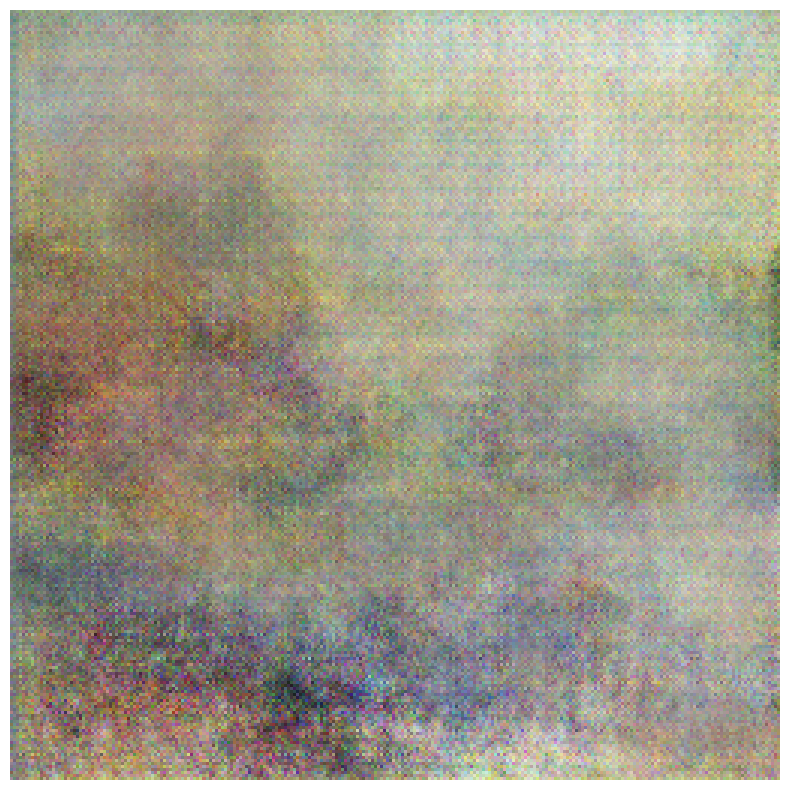

Training epoch 221/500
Training epoch 222/500
Training epoch 223/500
Training epoch 224/500
Training epoch 225/500
Training epoch 226/500
Training epoch 227/500
Training epoch 228/500
Training epoch 229/500
Training epoch 230/500
Training epoch 231/500
Training epoch 232/500
Training epoch 233/500
Training epoch 234/500
Training epoch 235/500
Training epoch 236/500
Training epoch 237/500
Training epoch 238/500
Training epoch 239/500
Training epoch 240/500
generator loss: 6.60878849029541    discriminator loss: 0.016934093087911606
Time for epoch 240 is 27.9616955836614 min


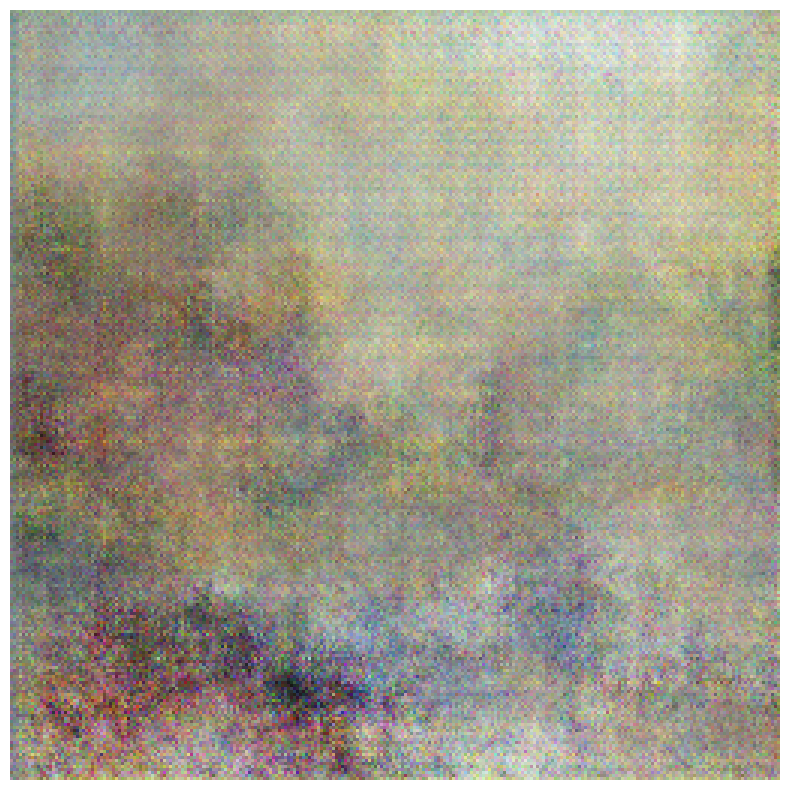

Training epoch 241/500
Training epoch 242/500
Training epoch 243/500
Training epoch 244/500
Training epoch 245/500
Training epoch 246/500
Training epoch 247/500
Training epoch 248/500
Training epoch 249/500
Training epoch 250/500
Training epoch 251/500
Training epoch 252/500
Training epoch 253/500
Training epoch 254/500
Training epoch 255/500
Training epoch 256/500
Training epoch 257/500
Training epoch 258/500
Training epoch 259/500
Training epoch 260/500
generator loss: 7.017296314239502    discriminator loss: 0.017692746594548225
Time for epoch 260 is 30.24185681740443 min


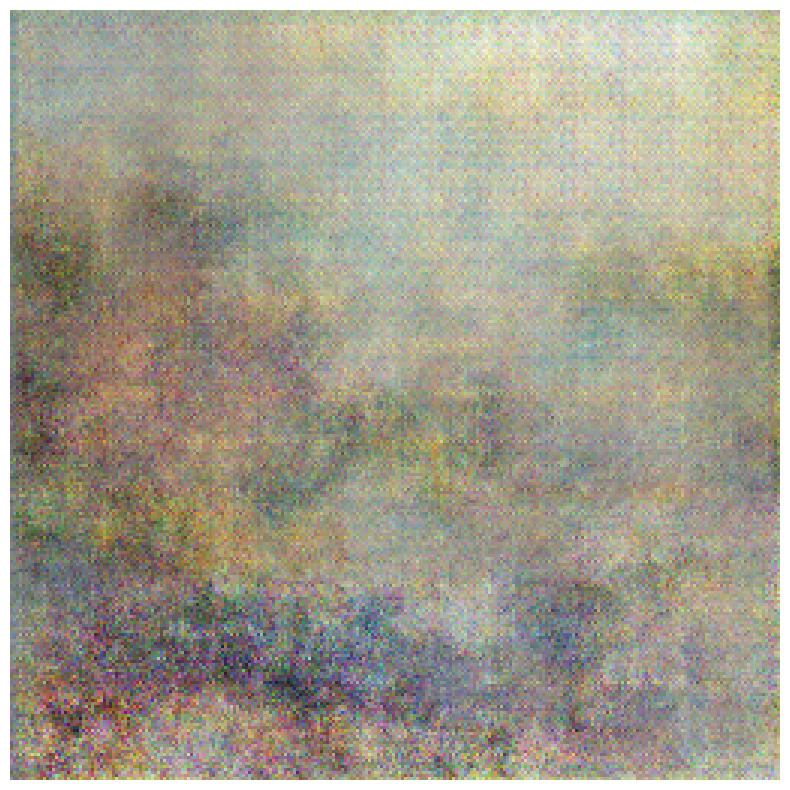

Training epoch 261/500
Training epoch 262/500
Training epoch 263/500
Training epoch 264/500
Training epoch 265/500
Training epoch 266/500
Training epoch 267/500
Training epoch 268/500
Training epoch 269/500
Training epoch 270/500
Training epoch 271/500
Training epoch 272/500
Training epoch 273/500
Training epoch 274/500
Training epoch 275/500
Training epoch 276/500
Training epoch 277/500
Training epoch 278/500
Training epoch 279/500
Training epoch 280/500
generator loss: 4.780074119567871    discriminator loss: 0.30106568336486816
Time for epoch 280 is 32.523860168457034 min


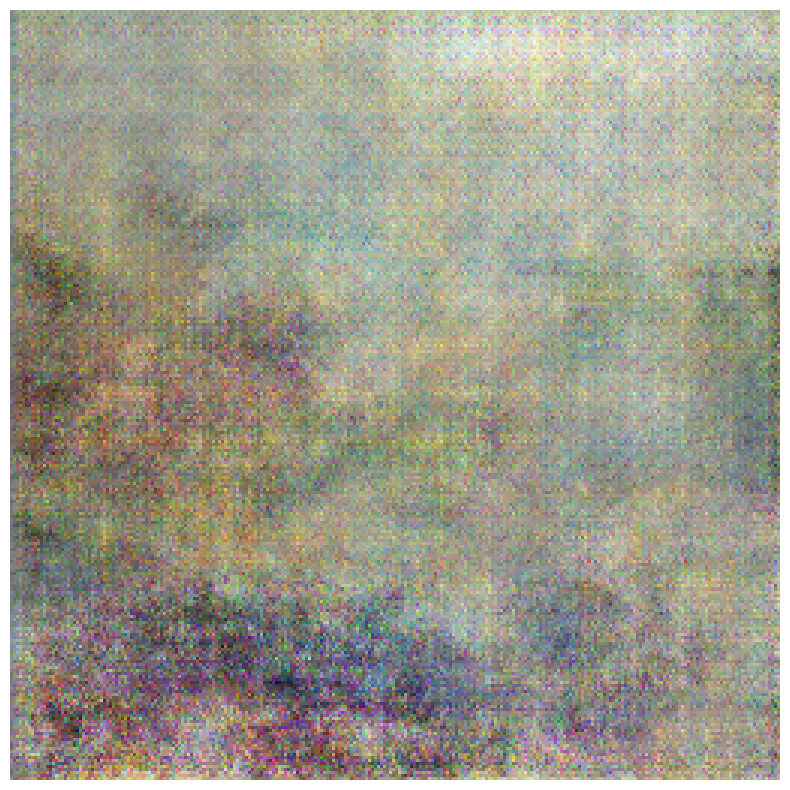

Training epoch 281/500
Training epoch 282/500
Training epoch 283/500
Training epoch 284/500
Training epoch 285/500
Training epoch 286/500
Training epoch 287/500
Training epoch 288/500
Training epoch 289/500
Training epoch 290/500
Training epoch 291/500
Training epoch 292/500
Training epoch 293/500
Training epoch 294/500
Training epoch 295/500
Training epoch 296/500
Training epoch 297/500
Training epoch 298/500
Training epoch 299/500
Training epoch 300/500
generator loss: 6.182798862457275    discriminator loss: 0.038954656571149826
Time for epoch 300 is 34.81104828516642 min


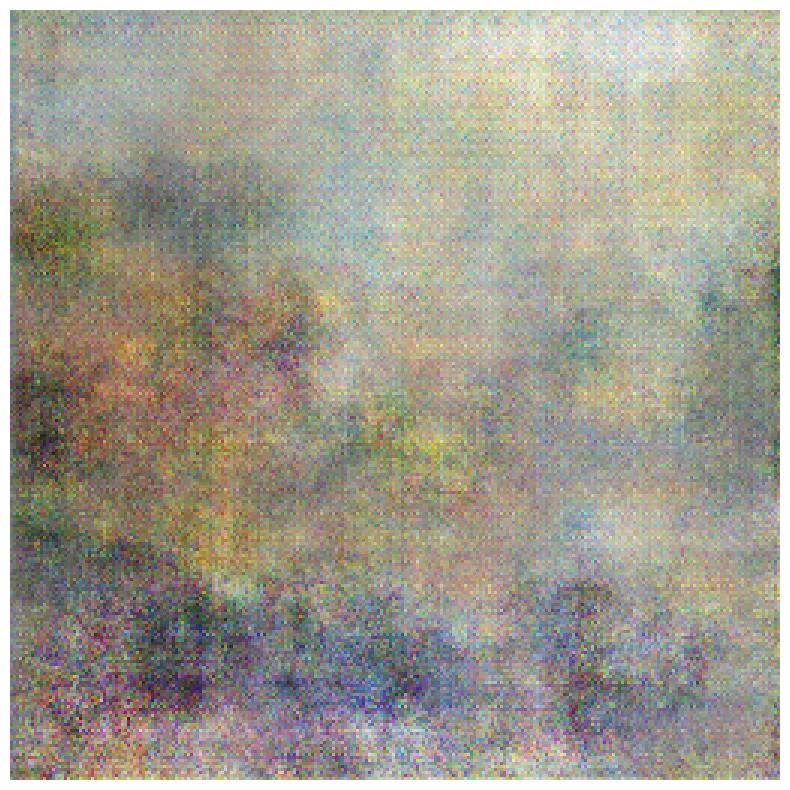

Training epoch 301/500
Training epoch 302/500
Training epoch 303/500
Training epoch 304/500
Training epoch 305/500
Training epoch 306/500
Training epoch 307/500
Training epoch 308/500
Training epoch 309/500
Training epoch 310/500
Training epoch 311/500
Training epoch 312/500
Training epoch 313/500
Training epoch 314/500
Training epoch 315/500
Training epoch 316/500
Training epoch 317/500
Training epoch 318/500
Training epoch 319/500
Training epoch 320/500
generator loss: 6.971795082092285    discriminator loss: 0.01424617413431406
Time for epoch 320 is 37.10511658589045 min


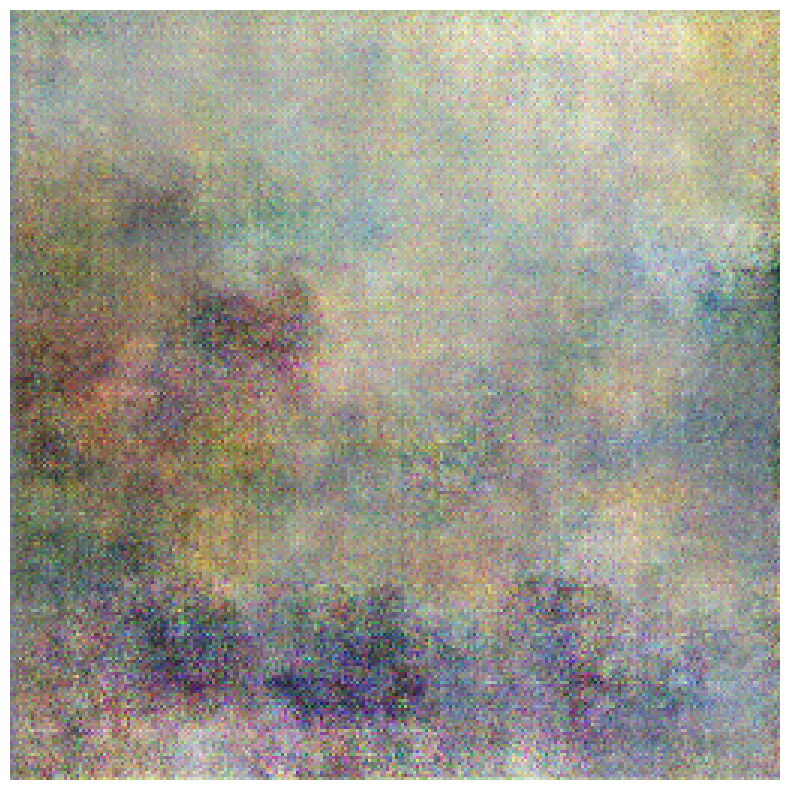

Training epoch 321/500
Training epoch 322/500
Training epoch 323/500
Training epoch 324/500
Training epoch 325/500
Training epoch 326/500
Training epoch 327/500
Training epoch 328/500
Training epoch 329/500
Training epoch 330/500
Training epoch 331/500
Training epoch 332/500
Training epoch 333/500
Training epoch 334/500
Training epoch 335/500
Training epoch 336/500
Training epoch 337/500
Training epoch 338/500
Training epoch 339/500
Training epoch 340/500
generator loss: 7.708105564117432    discriminator loss: 0.009947795420885086
Time for epoch 340 is 39.39831209977468 min


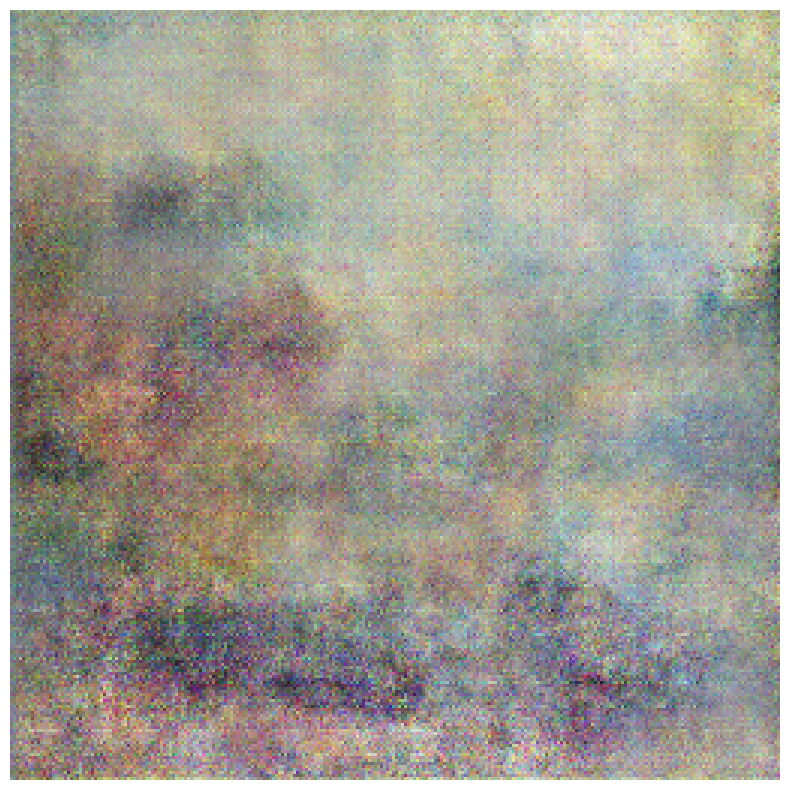

Training epoch 341/500
Training epoch 342/500
Training epoch 343/500
Training epoch 344/500
Training epoch 345/500
Training epoch 346/500
Training epoch 347/500
Training epoch 348/500
Training epoch 349/500
Training epoch 350/500
Training epoch 351/500
Training epoch 352/500
Training epoch 353/500
Training epoch 354/500
Training epoch 355/500
Training epoch 356/500
Training epoch 357/500
Training epoch 358/500
Training epoch 359/500
Training epoch 360/500
generator loss: 8.103734016418457    discriminator loss: 0.006121926940977573
Time for epoch 360 is 41.69047489960988 min


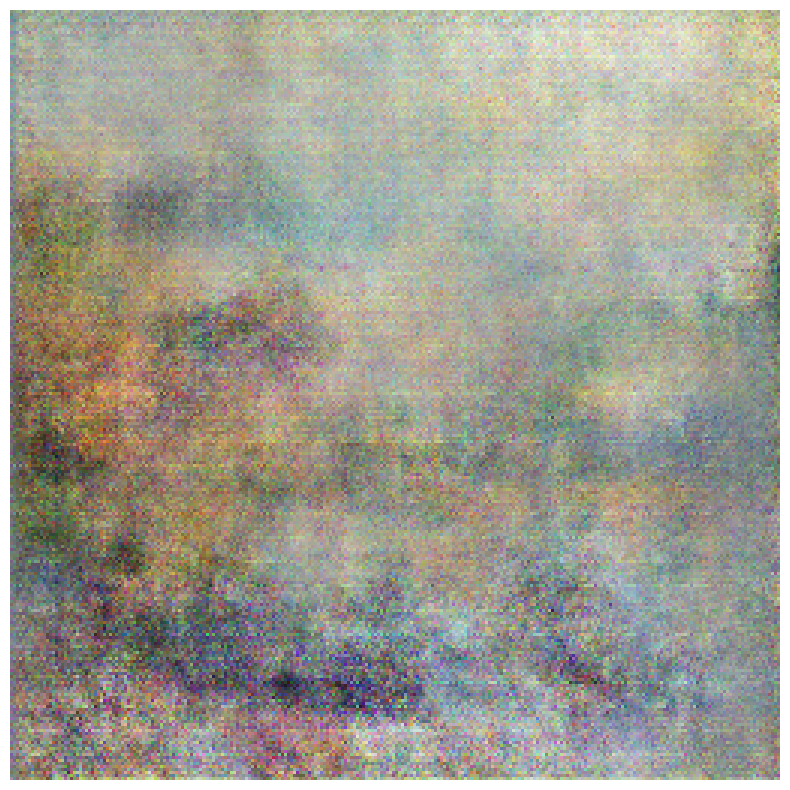

Training epoch 361/500
Training epoch 362/500
Training epoch 363/500
Training epoch 364/500
Training epoch 365/500
Training epoch 366/500
Training epoch 367/500
Training epoch 368/500
Training epoch 369/500
Training epoch 370/500
Training epoch 371/500
Training epoch 372/500
Training epoch 373/500
Training epoch 374/500
Training epoch 375/500
Training epoch 376/500
Training epoch 377/500
Training epoch 378/500
Training epoch 379/500
Training epoch 380/500
generator loss: 8.184915542602539    discriminator loss: 0.006132791750133038
Time for epoch 380 is 43.966954199473065 min


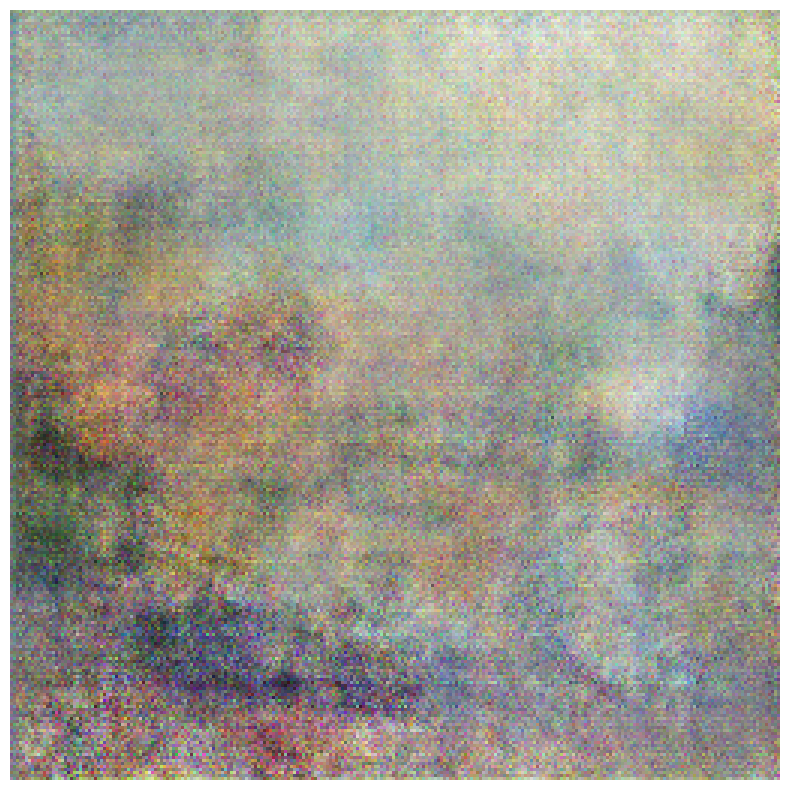

Training epoch 381/500
Training epoch 382/500
Training epoch 383/500
Training epoch 384/500
Training epoch 385/500
Training epoch 386/500
Training epoch 387/500
Training epoch 388/500
Training epoch 389/500
Training epoch 390/500
Training epoch 391/500
Training epoch 392/500
Training epoch 393/500
Training epoch 394/500
Training epoch 395/500
Training epoch 396/500
Training epoch 397/500
Training epoch 398/500
Training epoch 399/500
Training epoch 400/500
generator loss: 4.242673397064209    discriminator loss: 0.5404314398765564
Time for epoch 400 is 46.23784071604411 min


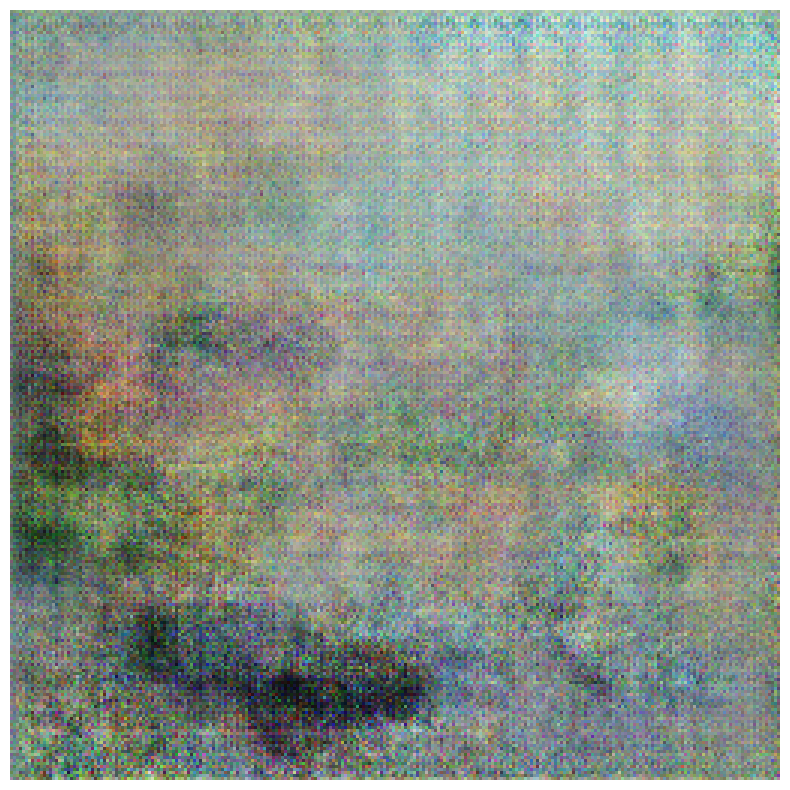

Training epoch 401/500
Training epoch 402/500
Training epoch 403/500
Training epoch 404/500
Training epoch 405/500
Training epoch 406/500
Training epoch 407/500
Training epoch 408/500
Training epoch 409/500
Training epoch 410/500
Training epoch 411/500
Training epoch 412/500
Training epoch 413/500
Training epoch 414/500
Training epoch 415/500
Training epoch 416/500
Training epoch 417/500
Training epoch 418/500
Training epoch 419/500
Training epoch 420/500
generator loss: 6.546132564544678    discriminator loss: 0.04707341641187668
Time for epoch 420 is 48.50530629952748 min


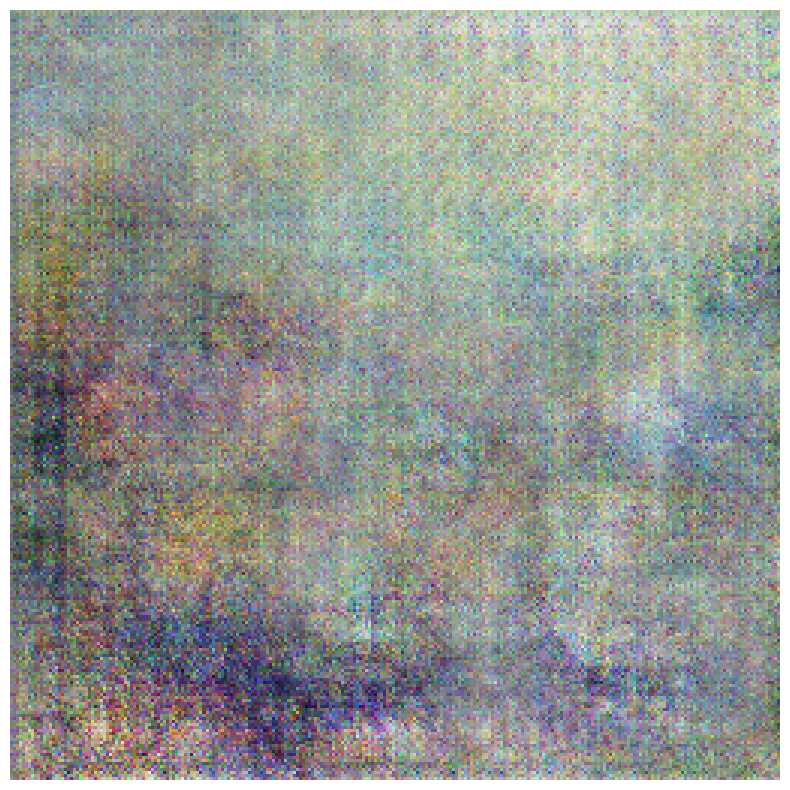

Training epoch 421/500
Training epoch 422/500
Training epoch 423/500
Training epoch 424/500
Training epoch 425/500
Training epoch 426/500
Training epoch 427/500
Training epoch 428/500
Training epoch 429/500
Training epoch 430/500
Training epoch 431/500
Training epoch 432/500
Training epoch 433/500
Training epoch 434/500
Training epoch 435/500
Training epoch 436/500
Training epoch 437/500
Training epoch 438/500
Training epoch 439/500
Training epoch 440/500
generator loss: 7.443862438201904    discriminator loss: 0.020042674615979195
Time for epoch 440 is 50.77413934866588 min


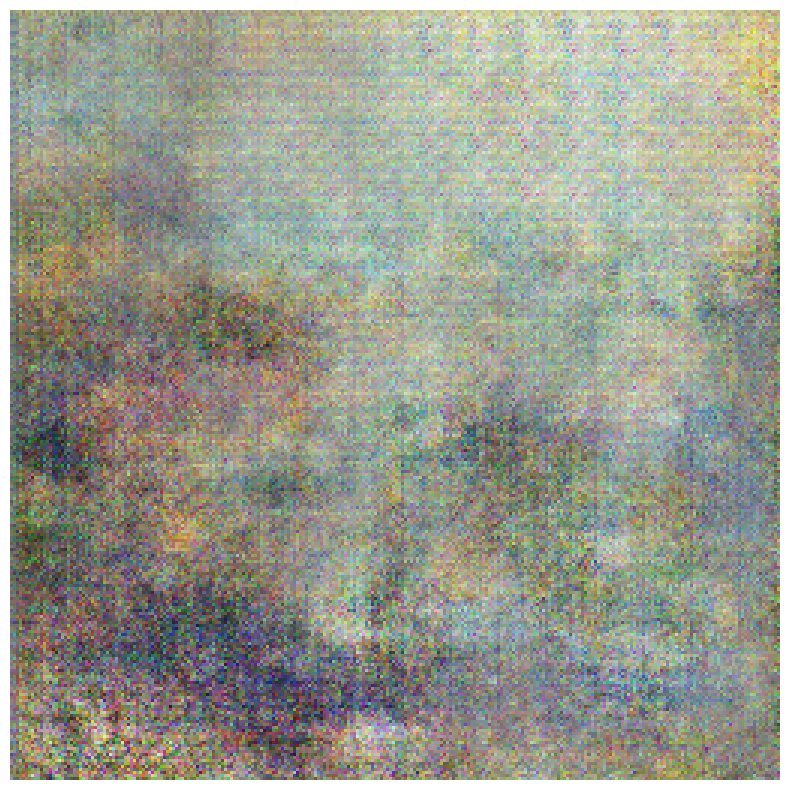

Training epoch 441/500
Training epoch 442/500
Training epoch 443/500
Training epoch 444/500
Training epoch 445/500
Training epoch 446/500
Training epoch 447/500
Training epoch 448/500
Training epoch 449/500
Training epoch 450/500
Training epoch 451/500
Training epoch 452/500
Training epoch 453/500
Training epoch 454/500
Training epoch 455/500
Training epoch 456/500
Training epoch 457/500
Training epoch 458/500
Training epoch 459/500
Training epoch 460/500
generator loss: 7.988105297088623    discriminator loss: 0.01962900534272194
Time for epoch 460 is 53.045904417832695 min


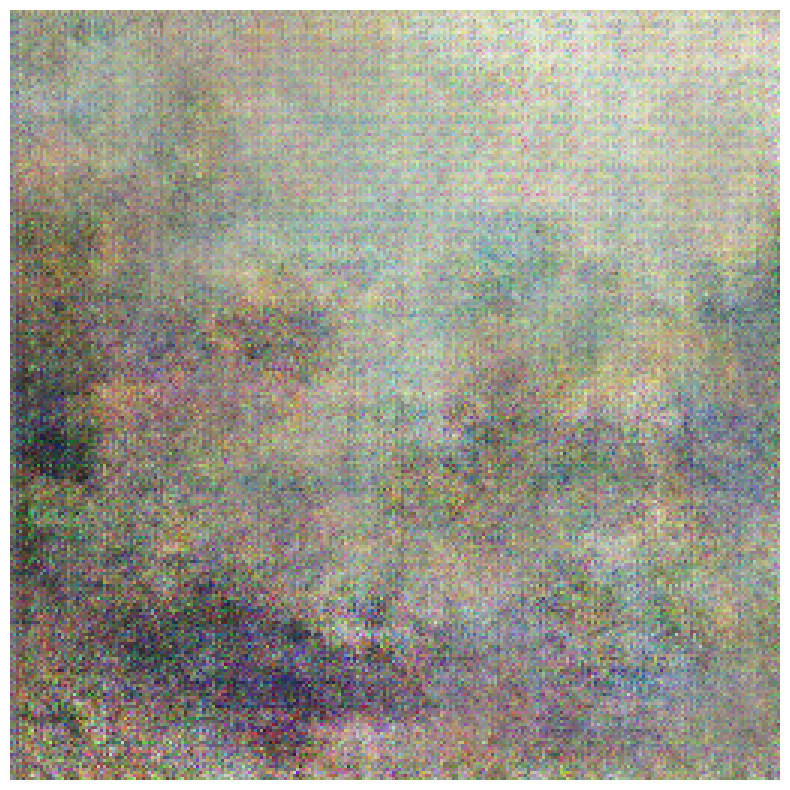

Training epoch 461/500
Training epoch 462/500
Training epoch 463/500
Training epoch 464/500
Training epoch 465/500
Training epoch 466/500
Training epoch 467/500
Training epoch 468/500
Training epoch 469/500
Training epoch 470/500
Training epoch 471/500
Training epoch 472/500
Training epoch 473/500
Training epoch 474/500
Training epoch 475/500
Training epoch 476/500
Training epoch 477/500
Training epoch 478/500
Training epoch 479/500
Training epoch 480/500
generator loss: 8.27641773223877    discriminator loss: 0.009229292161762714
Time for epoch 480 is 55.317871050039926 min


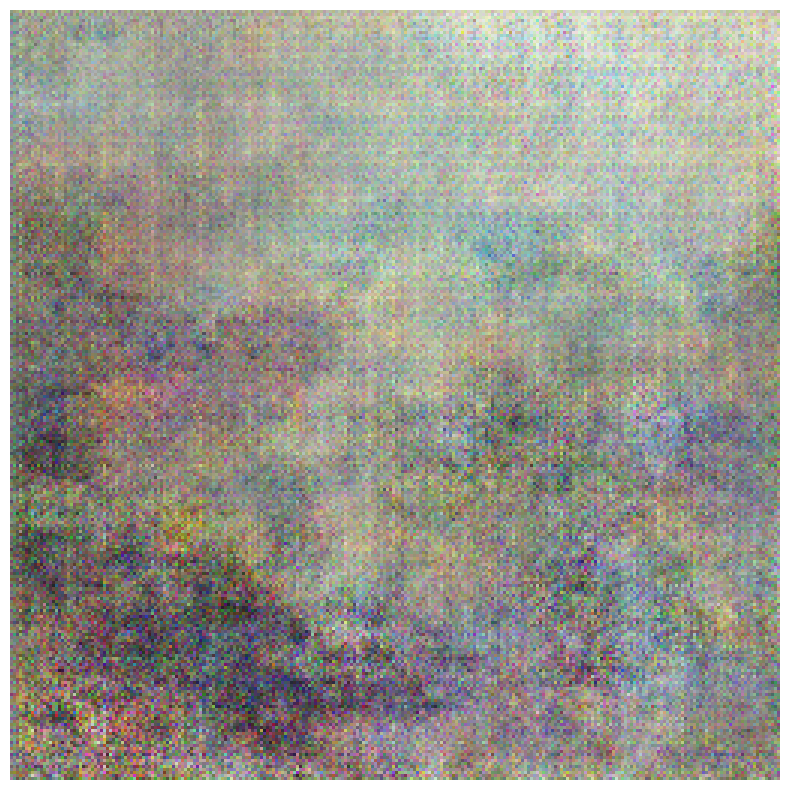

Training epoch 481/500
Training epoch 482/500
Training epoch 483/500
Training epoch 484/500
Training epoch 485/500
Training epoch 486/500
Training epoch 487/500
Training epoch 488/500
Training epoch 489/500
Training epoch 490/500
Training epoch 491/500
Training epoch 492/500
Training epoch 493/500
Training epoch 494/500
Training epoch 495/500
Training epoch 496/500
Training epoch 497/500
Training epoch 498/500
Training epoch 499/500
Training epoch 500/500
generator loss: 8.782350540161133    discriminator loss: 0.006158200558274984
Time for epoch 500 is 57.587704332669574 min


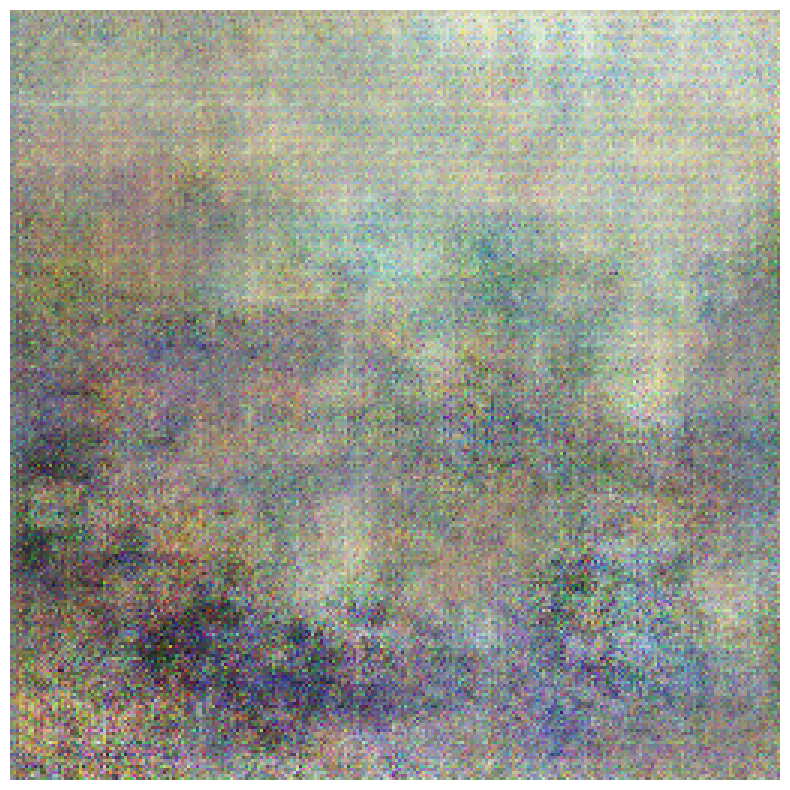

In [58]:
discriminator_loss1, generation_loss1=train1(img_monet, EPOCHS)

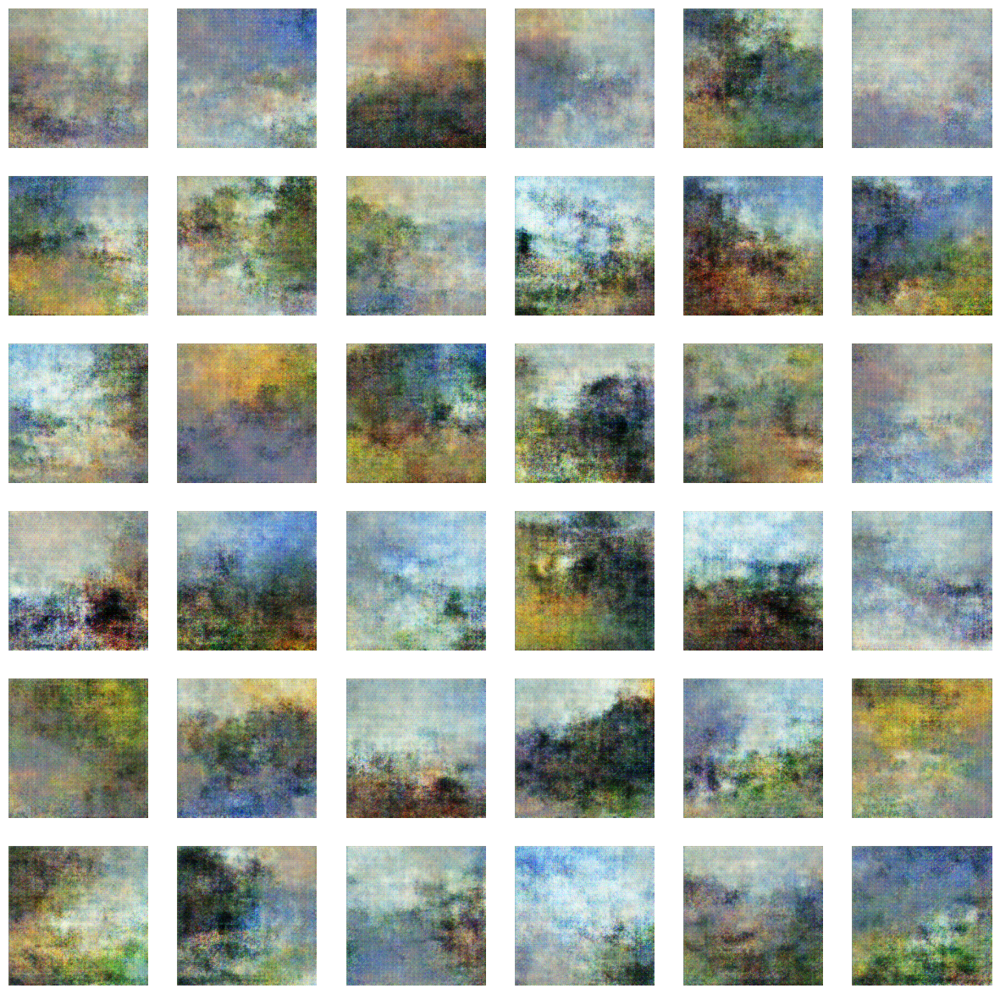

In [59]:
noise = tf.random.normal([36, noise_dim])
predictions = generator1(noise, training=False)

fig = plt.figure(figsize=(15, 15))
for i in range(36):
    plt.subplot(6, 6, i + 1)
    plt.imshow((np.array((predictions[i]+1)*127.5).astype(int)))     
    plt.axis('off')

plt.show()

We see an improvement in the generated images from the previous model. The images look much smoother and don't have the weird discoloration. 

The coloring looks like the colors from Monet's painting. However, the images are blurry and there are no subjects in the images.

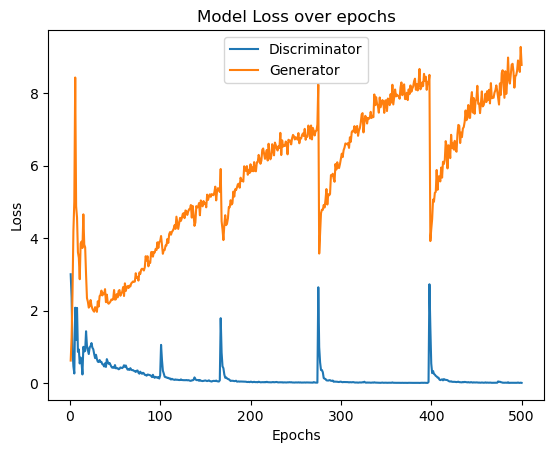

In [132]:
#Plot discriminator and generator loss
x=np.array(range(EPOCHS))+1

plt.plot(x, discriminator_loss1, label = "Discriminator")
plt.plot(x, generation_loss1, label = "Generator")
plt.title("Model Loss over epochs")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

The model's discriminator performs very well with low loss. However, this causes the generator to have higher loss and have a hard time catching up with the discriminator.

The model's generated images have nice color but still no where near the quality of Monet's painting. This is expected from the simple DCGAN model architecture. Let's try to improve this model more.

## DCGAN Model with label smoothening

So far, I have use hard labels to train my models (1: real, 0: generated). It is suggested that one should use soft labels to train GAN model. This means adding random noises to the labels so that they are slightly off from 1 and 0. Soft labels can give the model a regularizing effect and help it learn faster. This is oftern referred to as label smoothing.

Another trick I add to improve the model is switching the labels. This means real images have label 0 and generated images have label 1. Many have used this tip to train GAN and believe that the discriminator model can learn to separate the generated images better.

In [117]:
discriminator2 = keras.Sequential(
    [
        keras.Input(shape=(256, 256, 3)),
        layers.Conv2D(32, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.LeakyReLU(0.2),
        layers.Conv2D(64, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(128, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(256, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(512, kernel_size=(3,3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Flatten(),
        layers.Dropout(0.3),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator2",
)
discriminator2.summary()

Model: "discriminator2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_30 (Conv2D)          (None, 128, 128, 32)      896       
                                                                 
 leaky_re_lu_45 (LeakyReLU)  (None, 128, 128, 32)      0         
                                                                 
 conv2d_31 (Conv2D)          (None, 64, 64, 64)        18496     
                                                                 
 batch_normalization_32 (Ba  (None, 64, 64, 64)        256       
 tchNormalization)                                               
                                                                 
 leaky_re_lu_46 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 conv2d_32 (Conv2D)          (None, 32, 32, 128)       73856     
                                                    

In [118]:
latent_dim = 100

generator2 = keras.Sequential(
    [
        keras.Input(shape=(latent_dim,)),
        layers.Dense(16 * 16 * 512),
        layers.Reshape((16, 16, 512)),
        layers.Conv2DTranspose(256, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(128, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(64, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2DTranspose(32, kernel_size=(3, 3), strides=(2, 2), padding="same"),
        layers.BatchNormalization(),
        layers.LeakyReLU(0.2),
        layers.Conv2D(3, kernel_size=(3, 3),strides=(1, 1), padding="same", activation="tanh"),
    ],
    name="generator2",
)
generator2.summary()

Model: "generator2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_11 (Dense)            (None, 131072)            13238272  
                                                                 
 reshape_5 (Reshape)         (None, 16, 16, 512)       0         
                                                                 
 conv2d_transpose_20 (Conv2  (None, 32, 32, 256)       1179904   
 DTranspose)                                                     
                                                                 
 batch_normalization_36 (Ba  (None, 32, 32, 256)       1024      
 tchNormalization)                                               
                                                                 
 leaky_re_lu_50 (LeakyReLU)  (None, 32, 32, 256)       0         
                                                                 
 conv2d_transpose_21 (Conv2  (None, 64, 64, 128)       2

In [119]:
def train_step2(d_loss, g_loss,images):
        
    noise = np.random.normal(size=(images.shape[0], noise_dim))
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator2(noise, training=True)
        real_output = discriminator2(images, training=True)
        fake_output = discriminator2(generated_images, training=True)
        
        disc_loss = discriminator_loss2(real_output, fake_output)
        gen_loss = generator_loss2(fake_output)


        #Store the loss
        d_loss.append(disc_loss)
        g_loss.append(gen_loss)

        gradients_of_generator = gen_tape.gradient(gen_loss, generator2.trainable_variables)
        gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator2.trainable_variables)

        generator_optimizer.apply_gradients(zip(gradients_of_generator, generator2.trainable_variables))
        discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator2.trainable_variables))

    return d_loss, g_loss

In [120]:
def train2(dataset, epochs):
    discriminator_loss_hist, generation_loss_hist=[],[]
    start = time.time()
    for epoch in range(epochs):
        print('Training epoch {}/{}'.format(epoch+1, epochs))
        d_loss, g_loss = [], []

        for batch in dataset:
            d_loss, g_loss=train_step2(d_loss, g_loss, batch)

        
        #Store history of loss
        discriminator_loss_hist.append(np.mean(d_loss))
        generation_loss_hist.append(np.mean(g_loss)) 
        if (epoch+1) % 20 == 0:                                  
            print('generator loss: {}    discriminator loss: {}'.format( generation_loss_hist[-1],discriminator_loss_hist[-1]))
            print ('Time for epoch {} is {} min'.format(epoch + 1, (time.time()-start)/60))
            generate_and_save_images2(generator2,epoch+1,seed)
    return discriminator_loss_hist, generation_loss_hist

In [121]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)

def discriminator_loss2(real_output, fake_output):
    y_real=smooth_y(real_output,False)
    y_fake=smooth_y(fake_output,True)
    
    real_loss = cross_entropy(y_real, real_output)
    fake_loss = cross_entropy(y_fake, fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss2(fake_output):
    return cross_entropy(smooth_y(fake_output,False), fake_output)

def smooth_y(output,positive):
    noise=np.random.normal(loc=0.0, scale=1.0,size=output.shape[0])*0.05
    if positive:
        noise=noise+0.9
    noise=np.expand_dims(noise,axis=1)
    y=np.zeros_like(output)
    return tf.convert_to_tensor(y+noise)
    
generator_optimizer = tf.keras.optimizers.legacy.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.legacy.Adam(2e-4, beta_1=0.5)


In [122]:
def generate_and_save_images2(model, epoch, test_input):
    predictions = model(test_input, training=False)

    fig = plt.figure(figsize=(10, 10))
    
    plt.imshow((np.array((predictions[0]+1)*127.5).astype(int)))     
    plt.axis('off')

    plt.savefig('image_2_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

Training epoch 1/500
Training epoch 2/500
Training epoch 3/500
Training epoch 4/500
Training epoch 5/500
Training epoch 6/500
Training epoch 7/500
Training epoch 8/500
Training epoch 9/500
Training epoch 10/500
Training epoch 11/500
Training epoch 12/500
Training epoch 13/500
Training epoch 14/500
Training epoch 15/500
Training epoch 16/500
Training epoch 17/500
Training epoch 18/500
Training epoch 19/500
Training epoch 20/500
generator loss: 1.728115200996399    discriminator loss: 0.7846725583076477
Time for epoch 20 is 2.4143928488095603 min


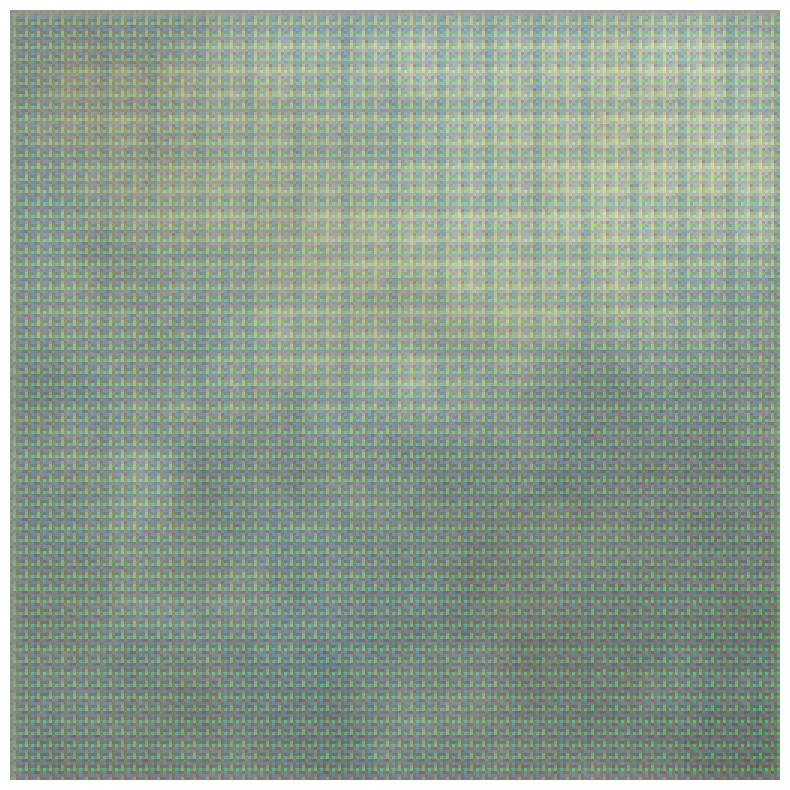

Training epoch 21/500
Training epoch 22/500
Training epoch 23/500
Training epoch 24/500
Training epoch 25/500
Training epoch 26/500
Training epoch 27/500
Training epoch 28/500
Training epoch 29/500
Training epoch 30/500
Training epoch 31/500
Training epoch 32/500
Training epoch 33/500
Training epoch 34/500
Training epoch 35/500
Training epoch 36/500
Training epoch 37/500
Training epoch 38/500
Training epoch 39/500
Training epoch 40/500
generator loss: 1.446012020111084    discriminator loss: 0.8848599195480347
Time for epoch 40 is 4.804081801573435 min


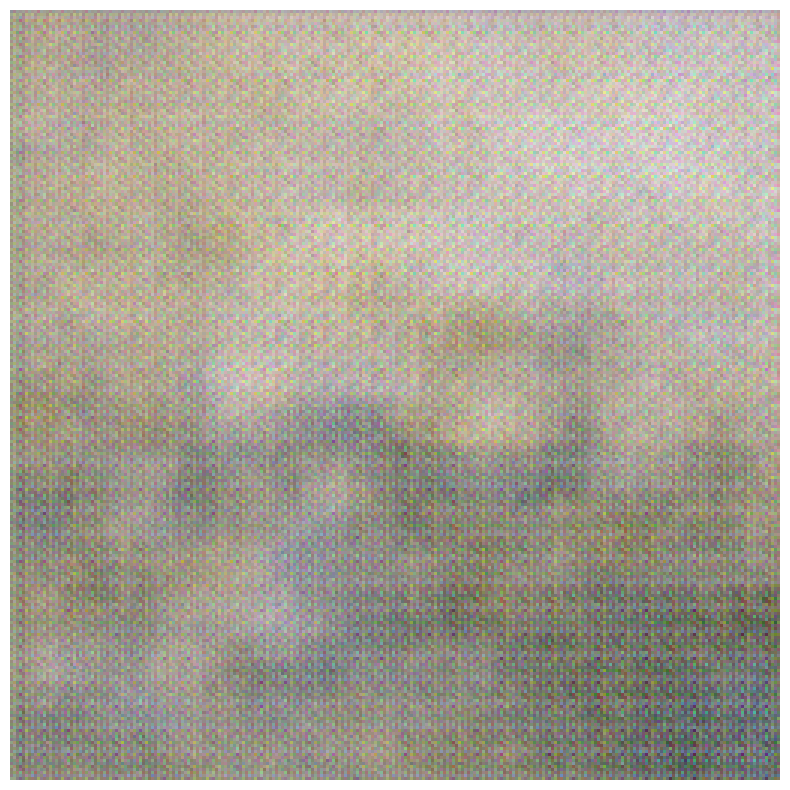

Training epoch 41/500
Training epoch 42/500
Training epoch 43/500
Training epoch 44/500
Training epoch 45/500
Training epoch 46/500
Training epoch 47/500
Training epoch 48/500
Training epoch 49/500
Training epoch 50/500
Training epoch 51/500
Training epoch 52/500
Training epoch 53/500
Training epoch 54/500
Training epoch 55/500
Training epoch 56/500
Training epoch 57/500
Training epoch 58/500
Training epoch 59/500
Training epoch 60/500
generator loss: 1.693760633468628    discriminator loss: 0.7568281888961792
Time for epoch 60 is 7.203098587195078 min


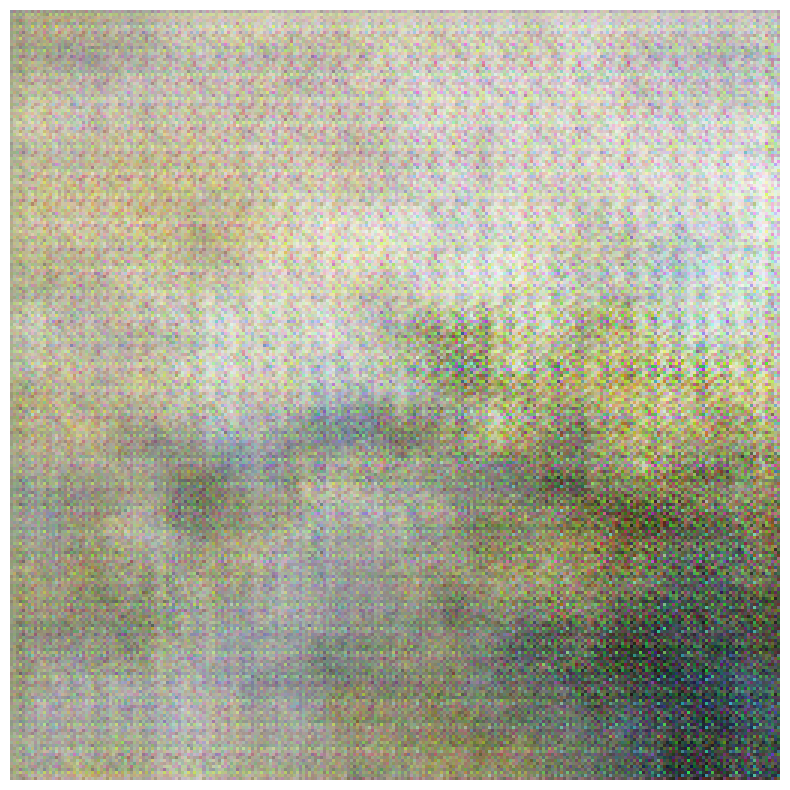

Training epoch 61/500
Training epoch 62/500
Training epoch 63/500
Training epoch 64/500
Training epoch 65/500
Training epoch 66/500
Training epoch 67/500
Training epoch 68/500
Training epoch 69/500
Training epoch 70/500
Training epoch 71/500
Training epoch 72/500
Training epoch 73/500
Training epoch 74/500
Training epoch 75/500
Training epoch 76/500
Training epoch 77/500
Training epoch 78/500
Training epoch 79/500
Training epoch 80/500
generator loss: 2.001887559890747    discriminator loss: 0.6526836156845093
Time for epoch 80 is 9.572077401479085 min


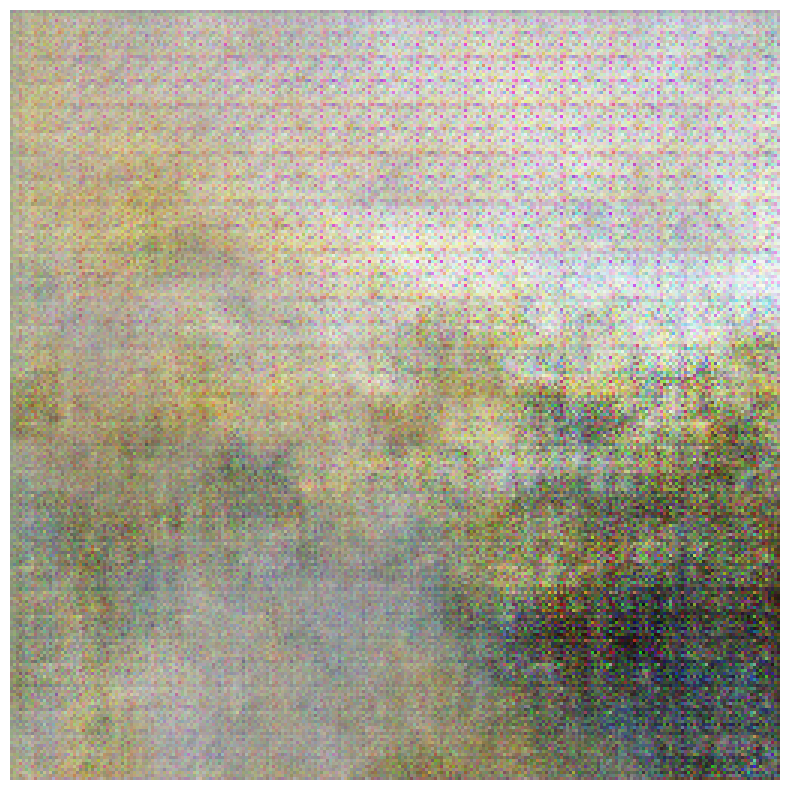

Training epoch 81/500
Training epoch 82/500
Training epoch 83/500
Training epoch 84/500
Training epoch 85/500
Training epoch 86/500
Training epoch 87/500
Training epoch 88/500
Training epoch 89/500
Training epoch 90/500
Training epoch 91/500
Training epoch 92/500
Training epoch 93/500
Training epoch 94/500
Training epoch 95/500
Training epoch 96/500
Training epoch 97/500
Training epoch 98/500
Training epoch 99/500
Training epoch 100/500
generator loss: 2.1297988891601562    discriminator loss: 0.5534787774085999
Time for epoch 100 is 11.933117532730103 min


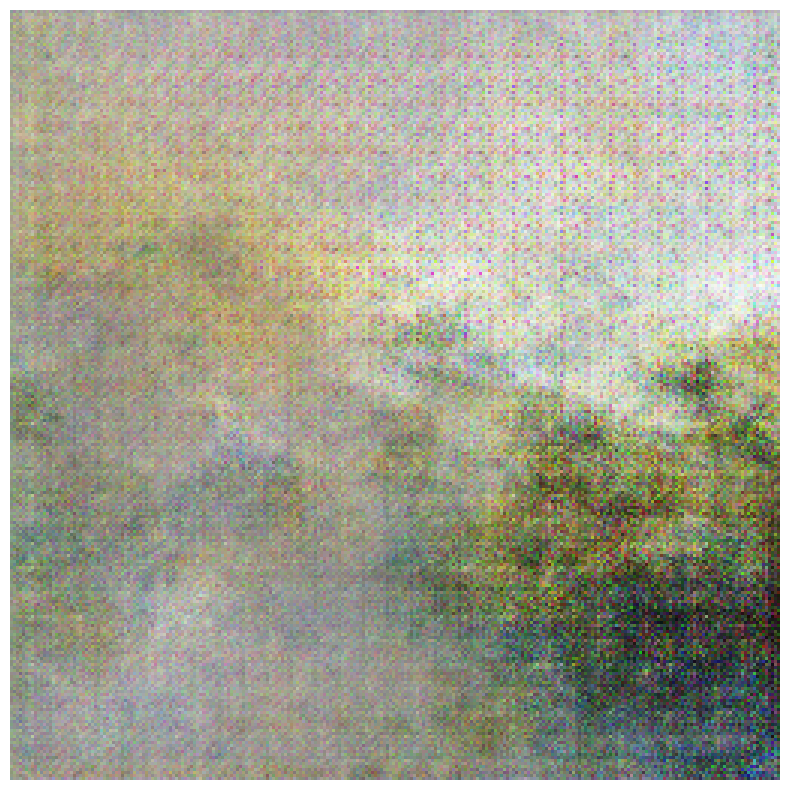

Training epoch 101/500
Training epoch 102/500
Training epoch 103/500
Training epoch 104/500
Training epoch 105/500
Training epoch 106/500
Training epoch 107/500
Training epoch 108/500
Training epoch 109/500
Training epoch 110/500
Training epoch 111/500
Training epoch 112/500
Training epoch 113/500
Training epoch 114/500
Training epoch 115/500
Training epoch 116/500
Training epoch 117/500
Training epoch 118/500
Training epoch 119/500
Training epoch 120/500
generator loss: 2.435629367828369    discriminator loss: 0.5196743011474609
Time for epoch 120 is 14.291398652394612 min


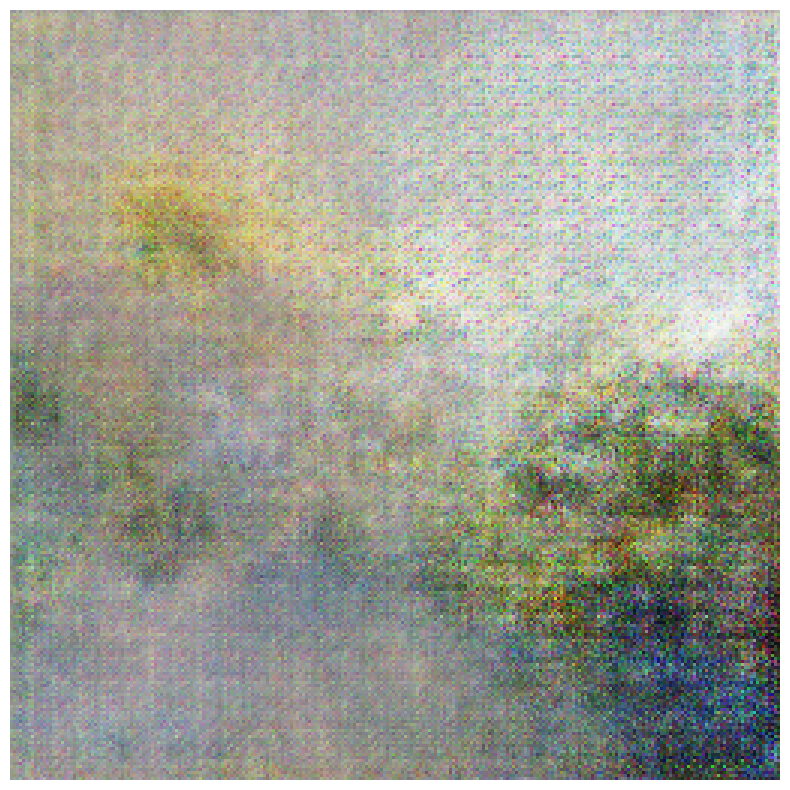

Training epoch 121/500
Training epoch 122/500
Training epoch 123/500
Training epoch 124/500
Training epoch 125/500
Training epoch 126/500
Training epoch 127/500
Training epoch 128/500
Training epoch 129/500
Training epoch 130/500
Training epoch 131/500
Training epoch 132/500
Training epoch 133/500
Training epoch 134/500
Training epoch 135/500
Training epoch 136/500
Training epoch 137/500
Training epoch 138/500
Training epoch 139/500
Training epoch 140/500
generator loss: 2.5000414848327637    discriminator loss: 0.4797292947769165
Time for epoch 140 is 16.922249750296274 min


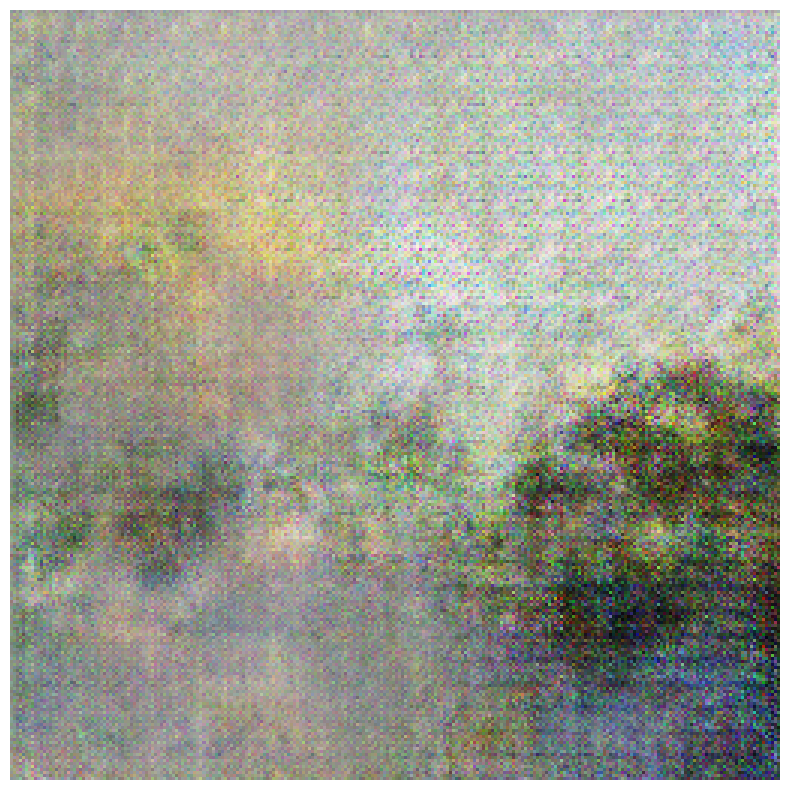

Training epoch 141/500
Training epoch 142/500
Training epoch 143/500
Training epoch 144/500
Training epoch 145/500
Training epoch 146/500
Training epoch 147/500
Training epoch 148/500
Training epoch 149/500
Training epoch 150/500
Training epoch 151/500
Training epoch 152/500
Training epoch 153/500
Training epoch 154/500
Training epoch 155/500
Training epoch 156/500
Training epoch 157/500
Training epoch 158/500
Training epoch 159/500
Training epoch 160/500
generator loss: 2.506788730621338    discriminator loss: 0.4574775695800781
Time for epoch 160 is 19.566507200400036 min


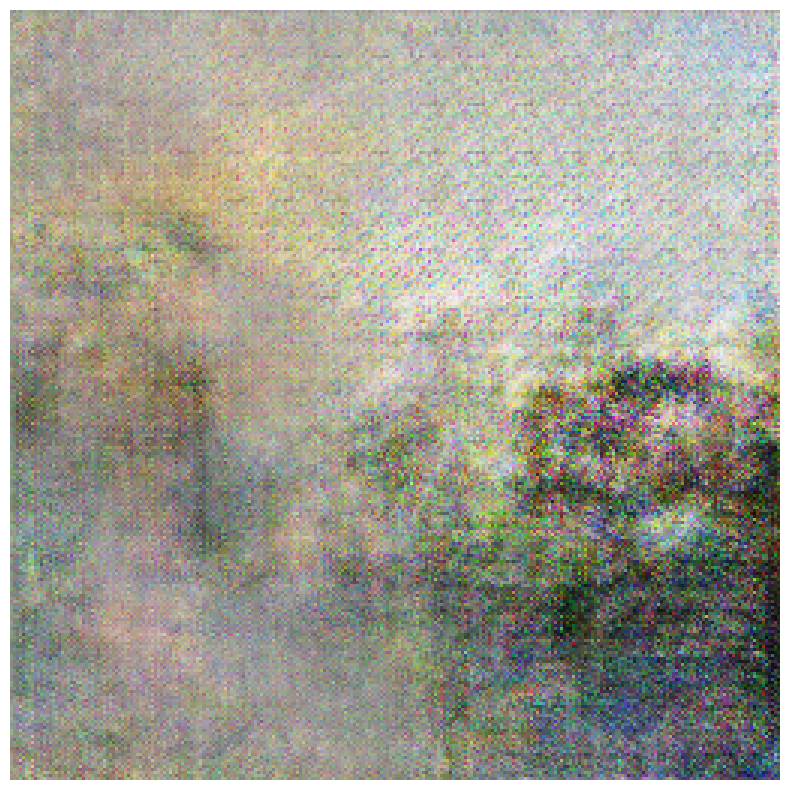

Training epoch 161/500
Training epoch 162/500
Training epoch 163/500
Training epoch 164/500
Training epoch 165/500
Training epoch 166/500
Training epoch 167/500
Training epoch 168/500
Training epoch 169/500
Training epoch 170/500
Training epoch 171/500
Training epoch 172/500
Training epoch 173/500
Training epoch 174/500
Training epoch 175/500
Training epoch 176/500
Training epoch 177/500
Training epoch 178/500
Training epoch 179/500
Training epoch 180/500
generator loss: 2.645137071609497    discriminator loss: 0.46837636828422546
Time for epoch 180 is 22.176359049479167 min


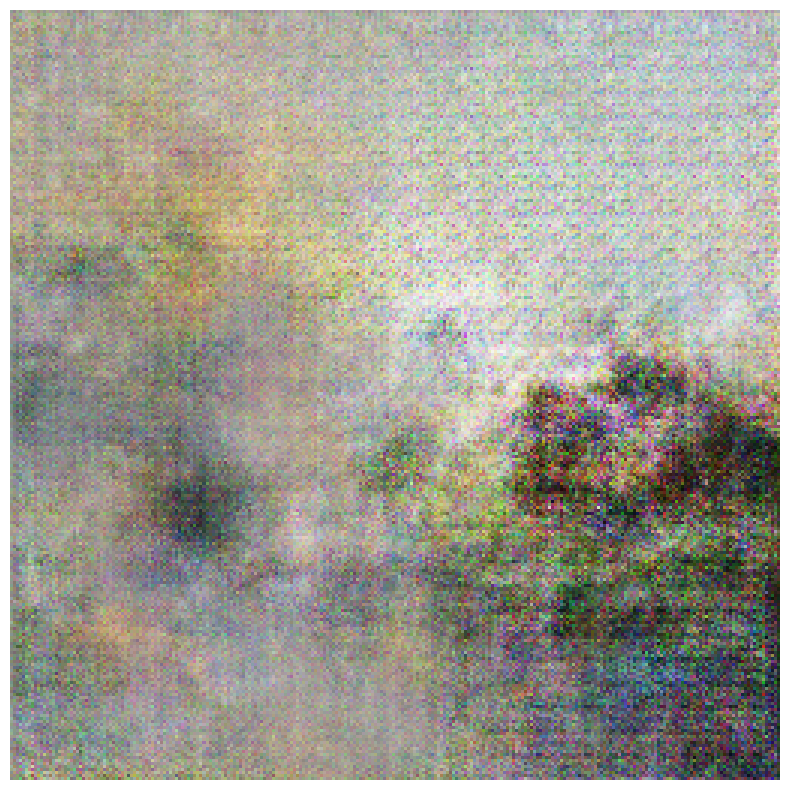

Training epoch 181/500
Training epoch 182/500
Training epoch 183/500
Training epoch 184/500
Training epoch 185/500
Training epoch 186/500
Training epoch 187/500
Training epoch 188/500
Training epoch 189/500
Training epoch 190/500
Training epoch 191/500
Training epoch 192/500
Training epoch 193/500
Training epoch 194/500
Training epoch 195/500
Training epoch 196/500
Training epoch 197/500
Training epoch 198/500
Training epoch 199/500
Training epoch 200/500
generator loss: 2.586731433868408    discriminator loss: 0.4672147035598755
Time for epoch 200 is 24.741487570603688 min


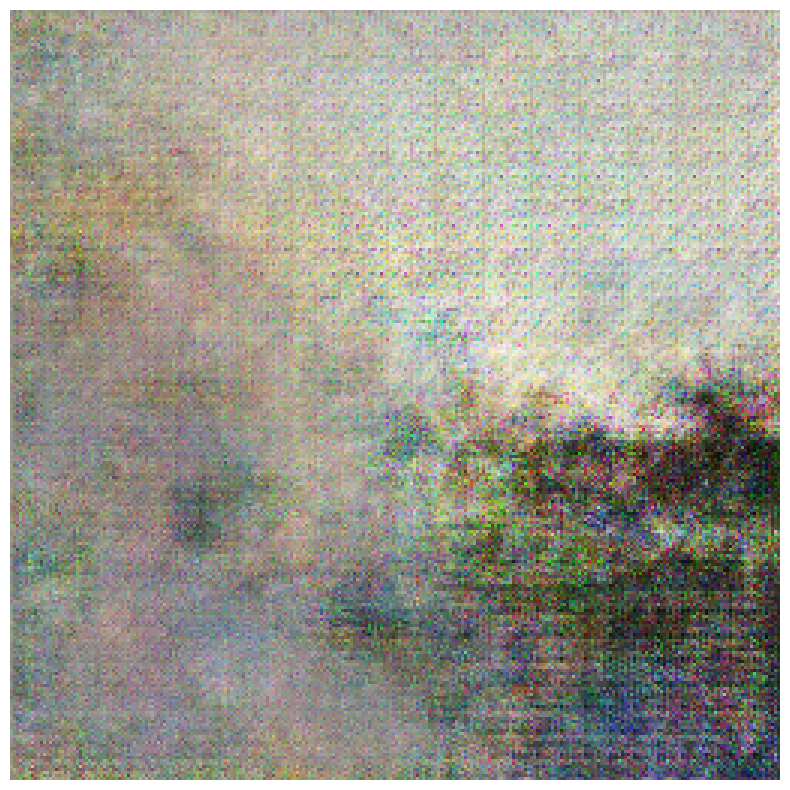

Training epoch 201/500
Training epoch 202/500
Training epoch 203/500
Training epoch 204/500
Training epoch 205/500
Training epoch 206/500
Training epoch 207/500
Training epoch 208/500
Training epoch 209/500
Training epoch 210/500
Training epoch 211/500
Training epoch 212/500
Training epoch 213/500
Training epoch 214/500
Training epoch 215/500
Training epoch 216/500
Training epoch 217/500
Training epoch 218/500
Training epoch 219/500
Training epoch 220/500
generator loss: 2.666597604751587    discriminator loss: 0.47789859771728516
Time for epoch 220 is 27.344160385926564 min


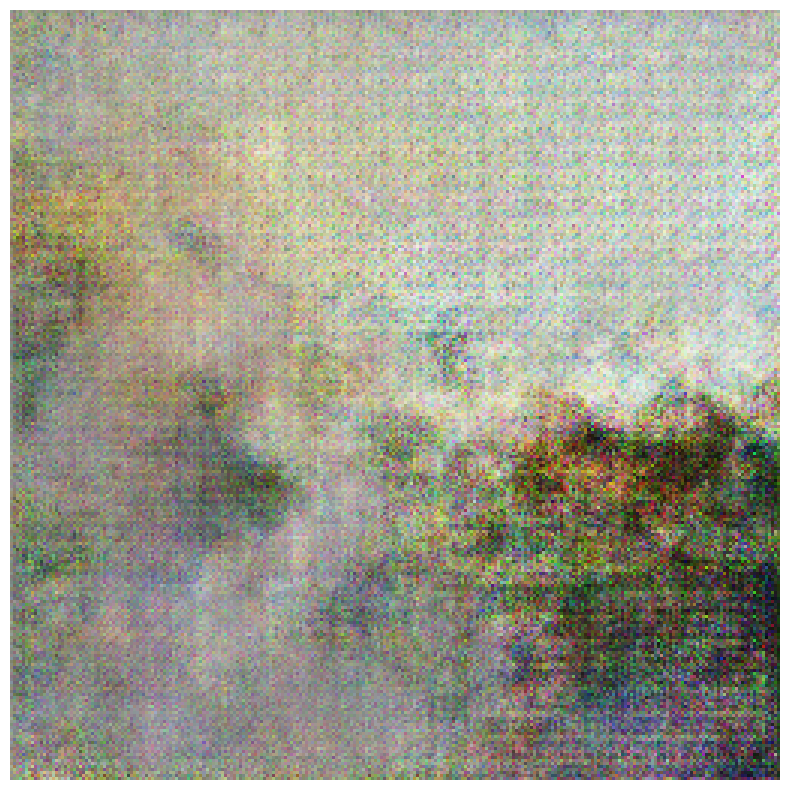

Training epoch 221/500
Training epoch 222/500
Training epoch 223/500
Training epoch 224/500
Training epoch 225/500
Training epoch 226/500
Training epoch 227/500
Training epoch 228/500
Training epoch 229/500
Training epoch 230/500
Training epoch 231/500
Training epoch 232/500
Training epoch 233/500
Training epoch 234/500
Training epoch 235/500
Training epoch 236/500
Training epoch 237/500
Training epoch 238/500
Training epoch 239/500
Training epoch 240/500
generator loss: 2.6736807823181152    discriminator loss: 0.43334102630615234
Time for epoch 240 is 29.90691530307134 min


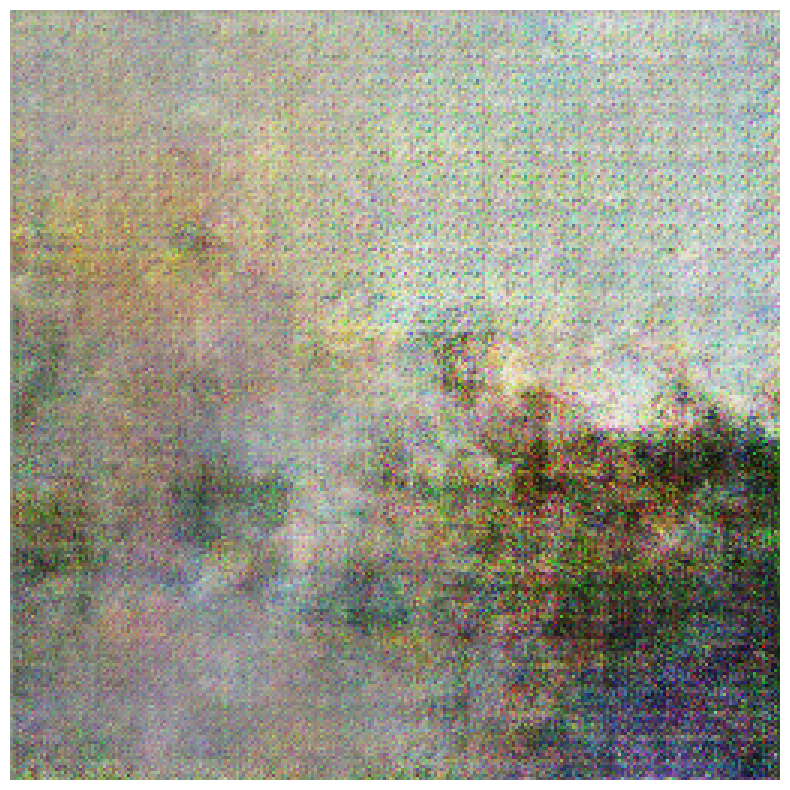

Training epoch 241/500
Training epoch 242/500
Training epoch 243/500
Training epoch 244/500
Training epoch 245/500
Training epoch 246/500
Training epoch 247/500
Training epoch 248/500
Training epoch 249/500
Training epoch 250/500
Training epoch 251/500
Training epoch 252/500
Training epoch 253/500
Training epoch 254/500
Training epoch 255/500
Training epoch 256/500
Training epoch 257/500
Training epoch 258/500
Training epoch 259/500
Training epoch 260/500
generator loss: 2.6212289333343506    discriminator loss: 0.46616506576538086
Time for epoch 260 is 32.46902718146642 min


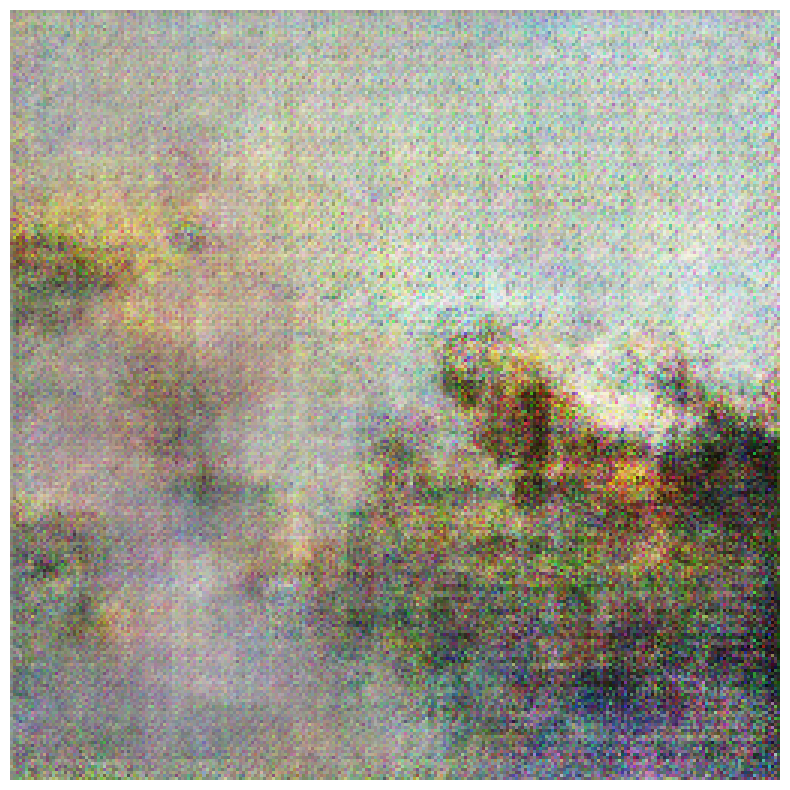

Training epoch 261/500
Training epoch 262/500
Training epoch 263/500
Training epoch 264/500
Training epoch 265/500
Training epoch 266/500
Training epoch 267/500
Training epoch 268/500
Training epoch 269/500
Training epoch 270/500
Training epoch 271/500
Training epoch 272/500
Training epoch 273/500
Training epoch 274/500
Training epoch 275/500
Training epoch 276/500
Training epoch 277/500
Training epoch 278/500
Training epoch 279/500
Training epoch 280/500
generator loss: 2.721506357192993    discriminator loss: 0.4342159032821655
Time for epoch 280 is 35.04084131717682 min


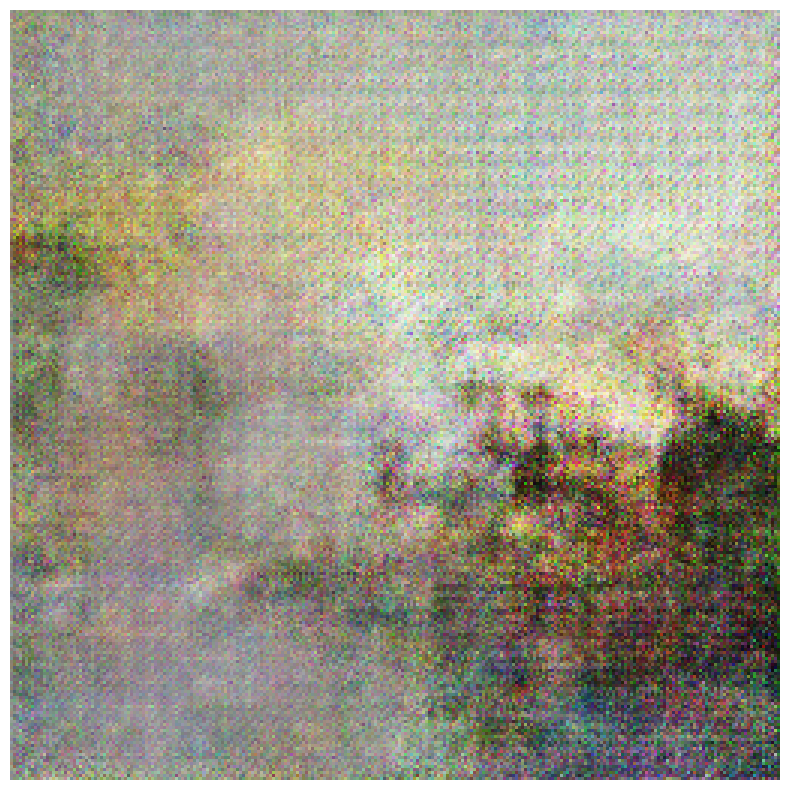

Training epoch 281/500
Training epoch 282/500
Training epoch 283/500
Training epoch 284/500
Training epoch 285/500
Training epoch 286/500
Training epoch 287/500
Training epoch 288/500
Training epoch 289/500
Training epoch 290/500
Training epoch 291/500
Training epoch 292/500
Training epoch 293/500
Training epoch 294/500
Training epoch 295/500
Training epoch 296/500
Training epoch 297/500
Training epoch 298/500
Training epoch 299/500
Training epoch 300/500
generator loss: 2.7398738861083984    discriminator loss: 0.41579270362854004
Time for epoch 300 is 37.61336491505305 min


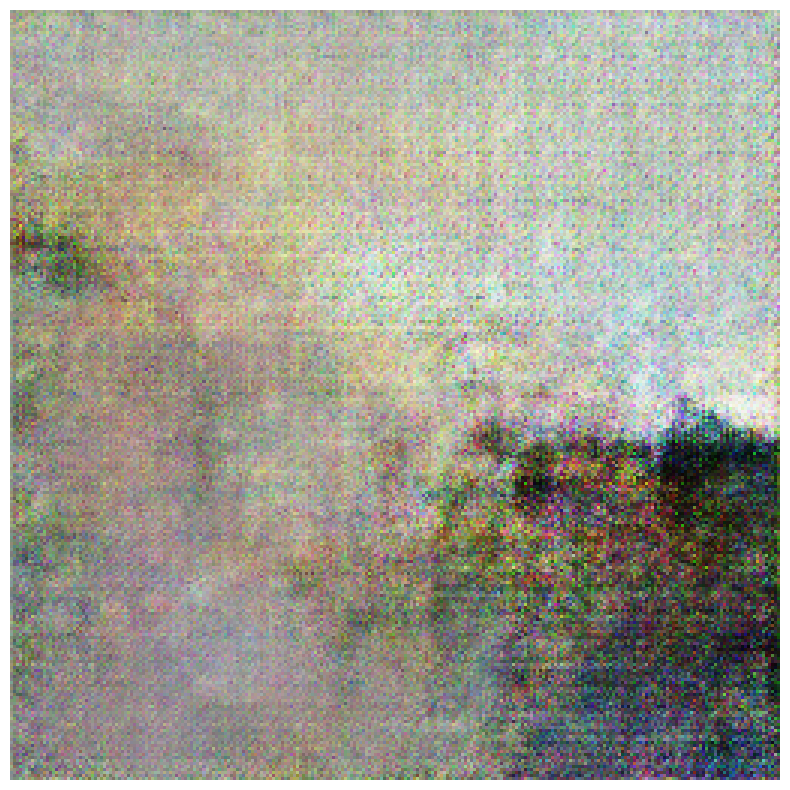

Training epoch 301/500
Training epoch 302/500
Training epoch 303/500
Training epoch 304/500
Training epoch 305/500
Training epoch 306/500
Training epoch 307/500
Training epoch 308/500
Training epoch 309/500
Training epoch 310/500
Training epoch 311/500
Training epoch 312/500
Training epoch 313/500
Training epoch 314/500
Training epoch 315/500
Training epoch 316/500
Training epoch 317/500
Training epoch 318/500
Training epoch 319/500
Training epoch 320/500
generator loss: 2.8200228214263916    discriminator loss: 0.42677104473114014
Time for epoch 320 is 40.193826699256896 min


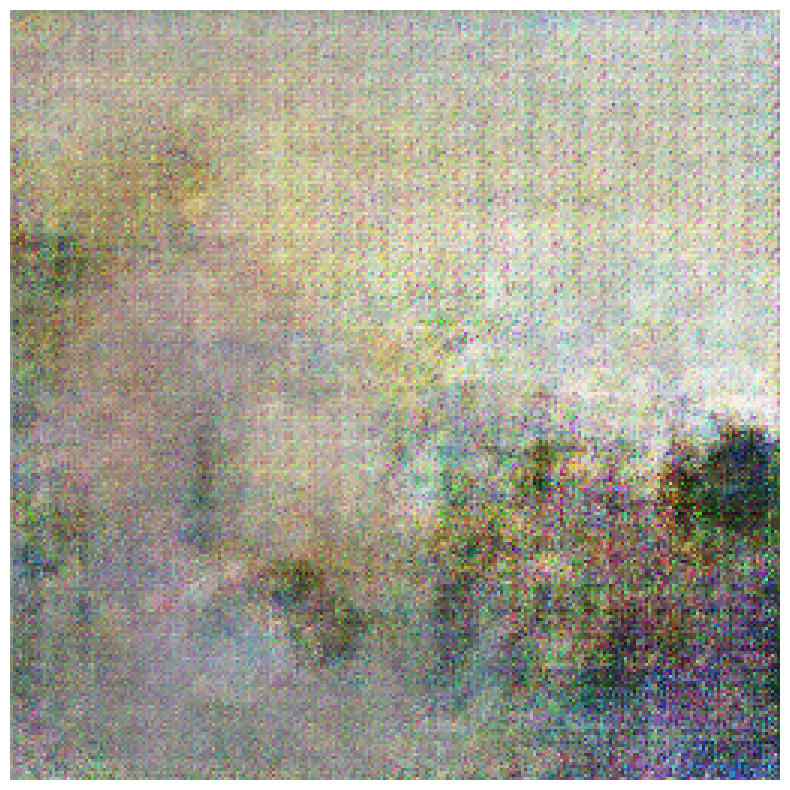

Training epoch 321/500
Training epoch 322/500
Training epoch 323/500
Training epoch 324/500
Training epoch 325/500
Training epoch 326/500
Training epoch 327/500
Training epoch 328/500
Training epoch 329/500
Training epoch 330/500
Training epoch 331/500
Training epoch 332/500
Training epoch 333/500
Training epoch 334/500
Training epoch 335/500
Training epoch 336/500
Training epoch 337/500
Training epoch 338/500
Training epoch 339/500
Training epoch 340/500
generator loss: 2.7652900218963623    discriminator loss: 0.4507336914539337
Time for epoch 340 is 42.76580783526103 min


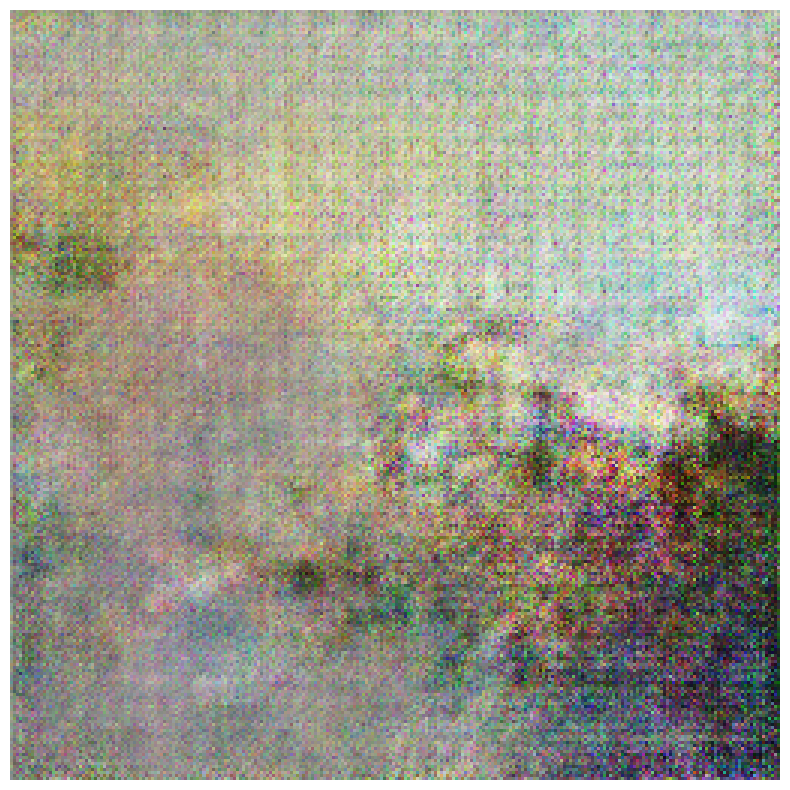

Training epoch 341/500
Training epoch 342/500
Training epoch 343/500
Training epoch 344/500
Training epoch 345/500
Training epoch 346/500
Training epoch 347/500
Training epoch 348/500
Training epoch 349/500
Training epoch 350/500
Training epoch 351/500
Training epoch 352/500
Training epoch 353/500
Training epoch 354/500
Training epoch 355/500
Training epoch 356/500
Training epoch 357/500
Training epoch 358/500
Training epoch 359/500
Training epoch 360/500
generator loss: 2.616537570953369    discriminator loss: 0.4010581076145172
Time for epoch 360 is 45.31184349854787 min


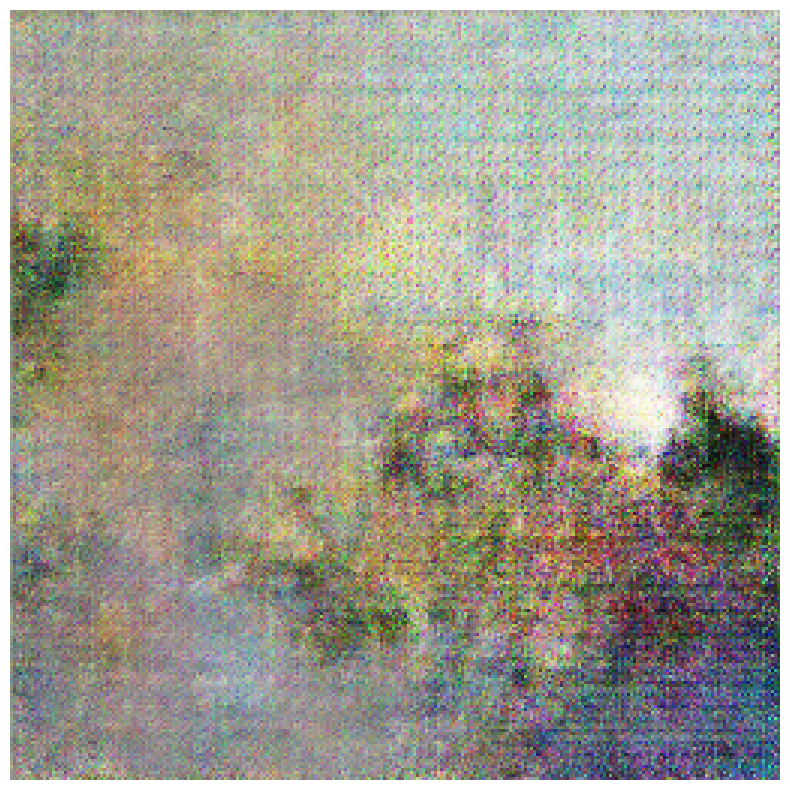

Training epoch 361/500
Training epoch 362/500
Training epoch 363/500
Training epoch 364/500
Training epoch 365/500
Training epoch 366/500
Training epoch 367/500
Training epoch 368/500
Training epoch 369/500
Training epoch 370/500
Training epoch 371/500
Training epoch 372/500
Training epoch 373/500
Training epoch 374/500
Training epoch 375/500
Training epoch 376/500
Training epoch 377/500
Training epoch 378/500
Training epoch 379/500
Training epoch 380/500
generator loss: 2.7187535762786865    discriminator loss: 0.3992236256599426
Time for epoch 380 is 47.89802580277125 min


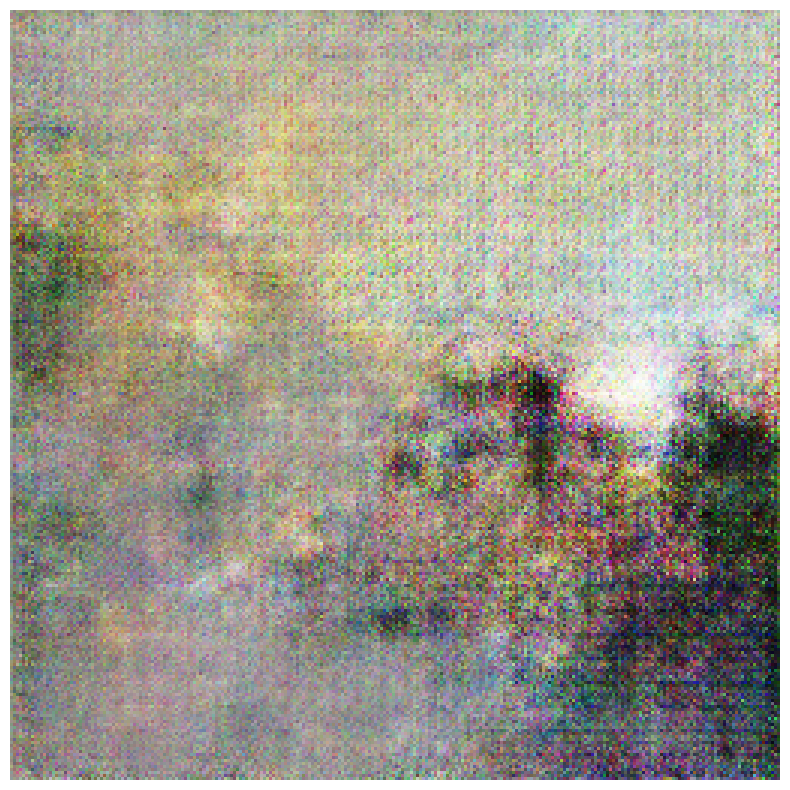

Training epoch 381/500
Training epoch 382/500
Training epoch 383/500
Training epoch 384/500
Training epoch 385/500
Training epoch 386/500
Training epoch 387/500
Training epoch 388/500
Training epoch 389/500
Training epoch 390/500
Training epoch 391/500
Training epoch 392/500
Training epoch 393/500
Training epoch 394/500
Training epoch 395/500
Training epoch 396/500
Training epoch 397/500
Training epoch 398/500
Training epoch 399/500
Training epoch 400/500
generator loss: 3.0390748977661133    discriminator loss: 0.43926727771759033
Time for epoch 400 is 50.482108350594835 min


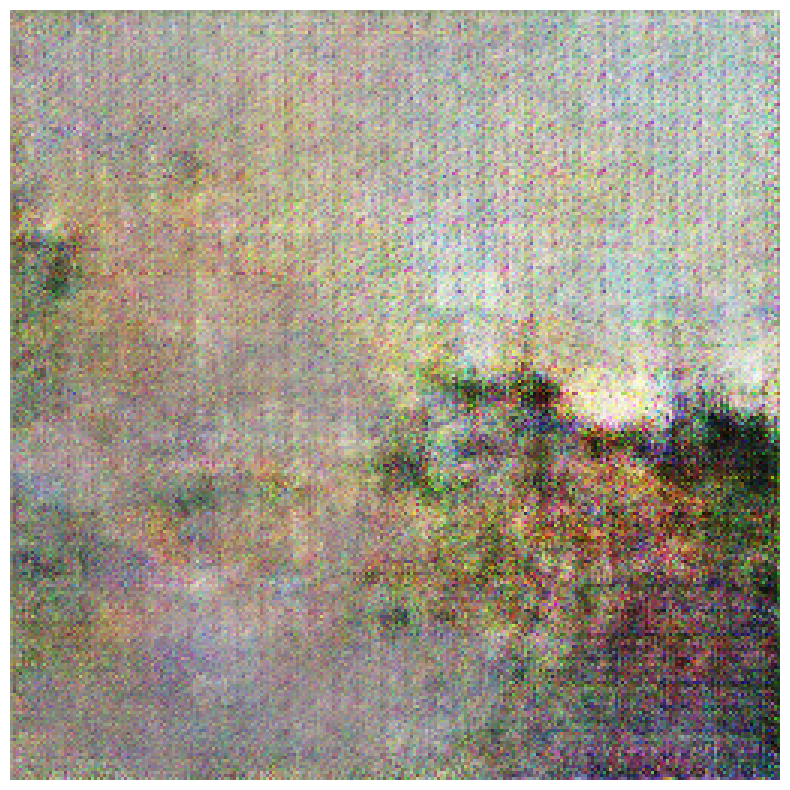

Training epoch 401/500
Training epoch 402/500
Training epoch 403/500
Training epoch 404/500
Training epoch 405/500
Training epoch 406/500
Training epoch 407/500
Training epoch 408/500
Training epoch 409/500
Training epoch 410/500
Training epoch 411/500
Training epoch 412/500
Training epoch 413/500
Training epoch 414/500
Training epoch 415/500
Training epoch 416/500
Training epoch 417/500
Training epoch 418/500
Training epoch 419/500
Training epoch 420/500
generator loss: 2.675893783569336    discriminator loss: 0.4161795675754547
Time for epoch 420 is 53.080595302581784 min


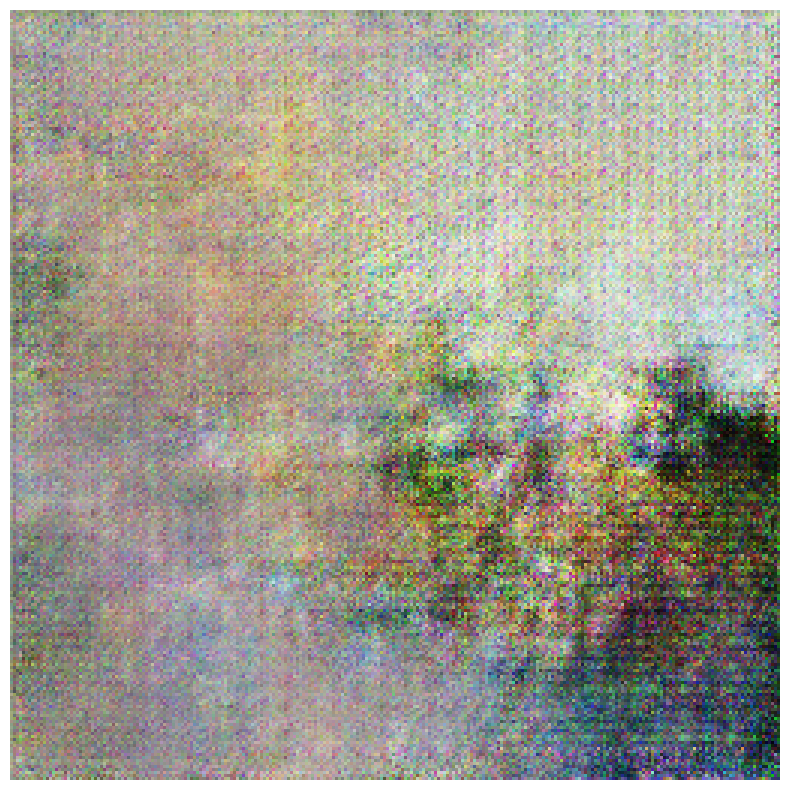

Training epoch 421/500
Training epoch 422/500
Training epoch 423/500
Training epoch 424/500
Training epoch 425/500
Training epoch 426/500
Training epoch 427/500
Training epoch 428/500
Training epoch 429/500
Training epoch 430/500
Training epoch 431/500
Training epoch 432/500
Training epoch 433/500
Training epoch 434/500
Training epoch 435/500
Training epoch 436/500
Training epoch 437/500
Training epoch 438/500
Training epoch 439/500
Training epoch 440/500
generator loss: 2.583786725997925    discriminator loss: 0.368898868560791
Time for epoch 440 is 55.66063050429026 min


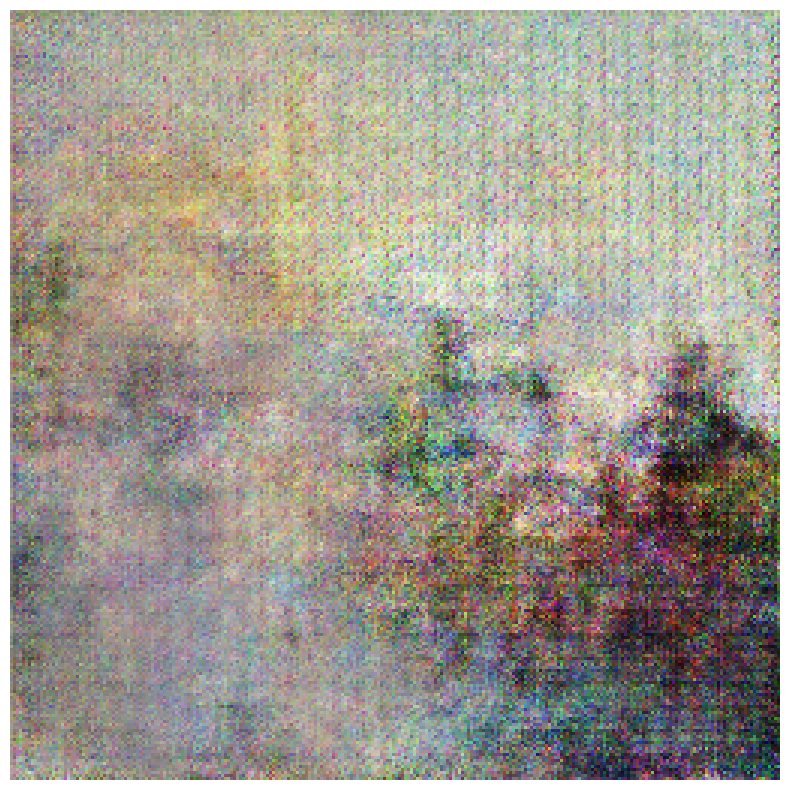

Training epoch 441/500
Training epoch 442/500
Training epoch 443/500
Training epoch 444/500
Training epoch 445/500
Training epoch 446/500
Training epoch 447/500
Training epoch 448/500
Training epoch 449/500
Training epoch 450/500
Training epoch 451/500
Training epoch 452/500
Training epoch 453/500
Training epoch 454/500
Training epoch 455/500
Training epoch 456/500
Training epoch 457/500
Training epoch 458/500
Training epoch 459/500
Training epoch 460/500
generator loss: 2.6702005863189697    discriminator loss: 0.41120296716690063
Time for epoch 460 is 58.24597448507945 min


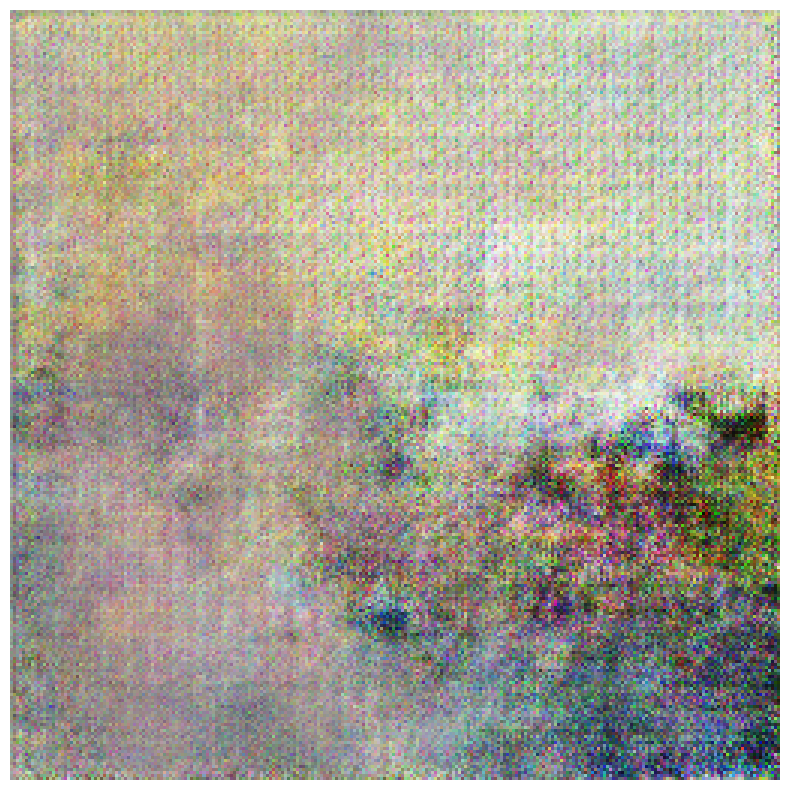

Training epoch 461/500
Training epoch 462/500
Training epoch 463/500
Training epoch 464/500
Training epoch 465/500
Training epoch 466/500
Training epoch 467/500
Training epoch 468/500
Training epoch 469/500
Training epoch 470/500
Training epoch 471/500
Training epoch 472/500
Training epoch 473/500
Training epoch 474/500
Training epoch 475/500
Training epoch 476/500
Training epoch 477/500
Training epoch 478/500
Training epoch 479/500
Training epoch 480/500
generator loss: 2.6469454765319824    discriminator loss: 0.41213807463645935
Time for epoch 480 is 60.82893455028534 min


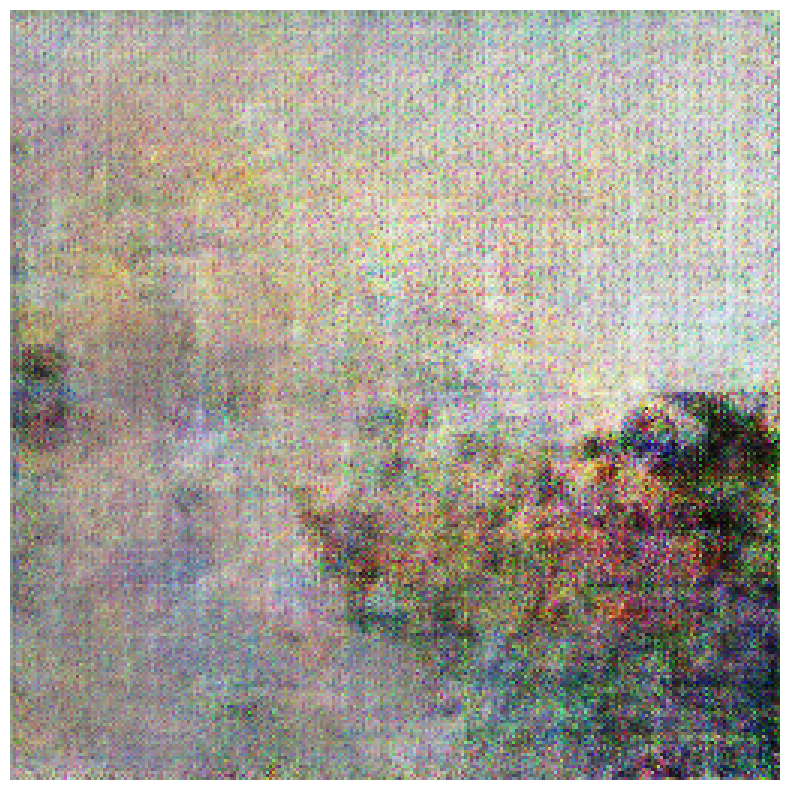

Training epoch 481/500
Training epoch 482/500
Training epoch 483/500
Training epoch 484/500
Training epoch 485/500
Training epoch 486/500
Training epoch 487/500
Training epoch 488/500
Training epoch 489/500
Training epoch 490/500
Training epoch 491/500
Training epoch 492/500
Training epoch 493/500
Training epoch 494/500
Training epoch 495/500
Training epoch 496/500
Training epoch 497/500
Training epoch 498/500
Training epoch 499/500
Training epoch 500/500
generator loss: 2.783219337463379    discriminator loss: 0.42522192001342773
Time for epoch 500 is 63.41845415433248 min


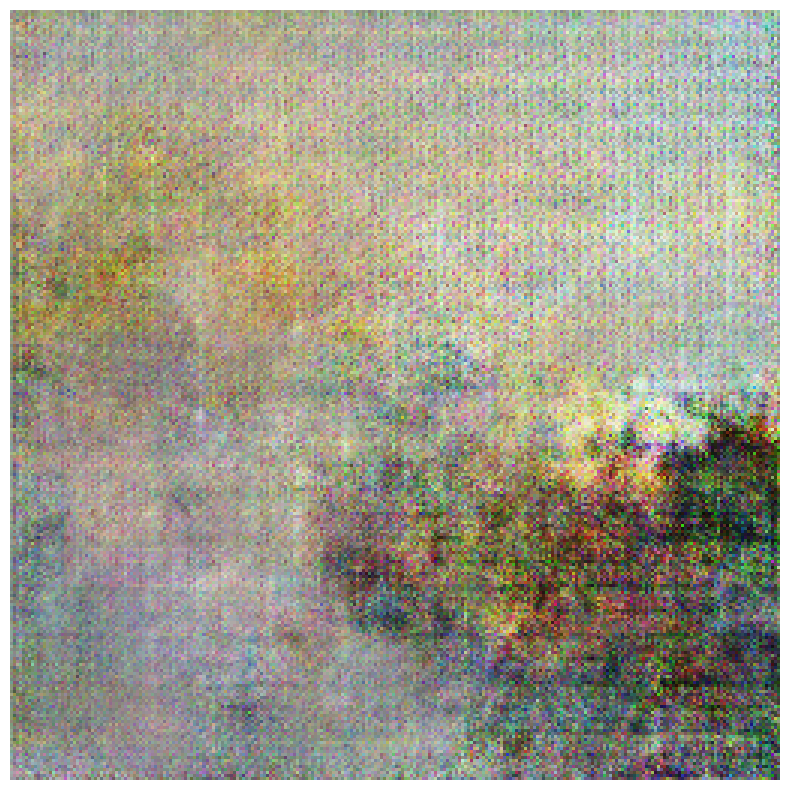

In [123]:
discriminator_loss_2, generation_loss_2=train2(img_monet, EPOCHS)

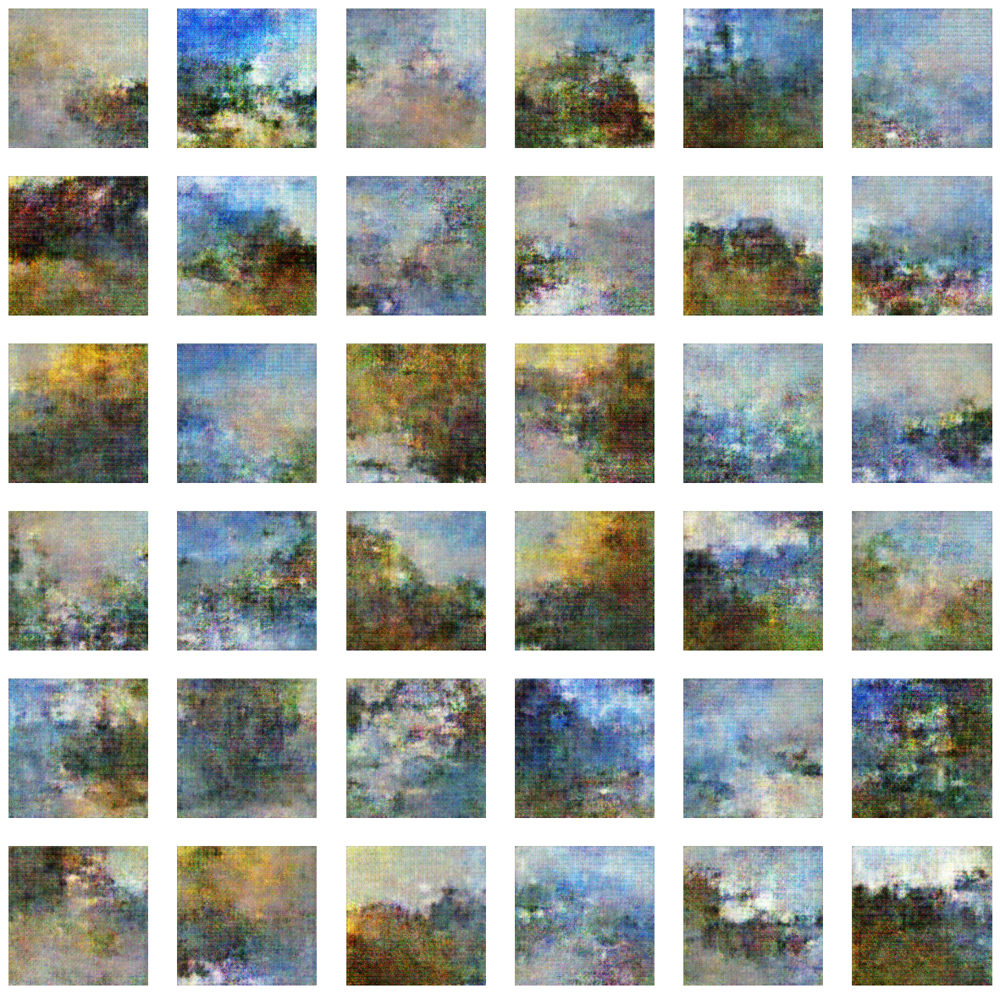

In [124]:
noise = tf.random.normal([36, noise_dim])
predictions = generator2(noise, training=False)

fig = plt.figure(figsize=(15, 15))
for i in range(36):
    plt.subplot(6, 6, i + 1)
    plt.imshow((np.array((predictions[i]+1)*127.5).astype(int)))     
    plt.axis('off')

plt.show()

The output looks similar to the previous model. However, some generated images looks noisier than the prevois outputs. This is not good.

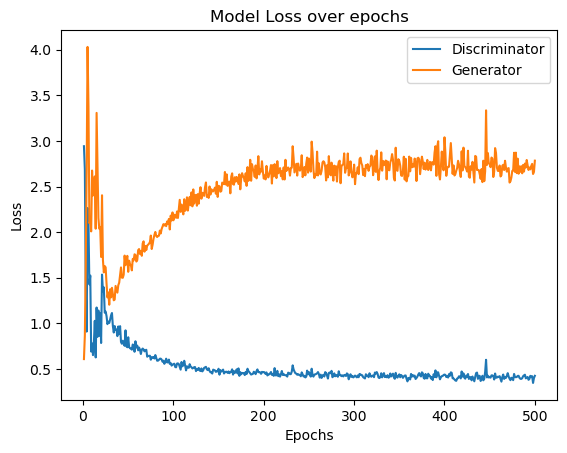

In [131]:
#Plot discriminator and generator loss
x=np.array(range(EPOCHS))+1

plt.plot(x, discriminator_loss_2, label = "Discriminator")
plt.plot(x, generation_loss_2, label = "Generator")
plt.title("Model Loss over epochs")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.legend()
plt.show()

This model performance doesn't visibly improve from the last model. The attempt to improve the model is not successful.

## Submission to Kaggle for model performance

Finally, I will generate 10,000 images and submit to Kaggle for a score on my model. I will use the second model (with added batch normalization) as my final model.

The Kaggle competition will be assessed on MiFID (Memorization-informed Fréchet Inception Distance), which measures the distance between the features of the generated images and Monet paintings. The lower the score is, the better the model performs.

In [166]:
# Submission generate 10,000 images
Batch_num=100
for b in range(Batch_num):
    #Generate images
    noise = np.random.normal(size=(100, noise_dim))
    predictions = generator1(noise, training=False)
    generated_images=(np.array((predictions+1)*127.5).astype(np.uint8))
    
    #Save images
    for i, img in enumerate(generated_images):
        img = Image.fromarray(img)
        img.save("images/" + str(b*100+i+1) + ".jpg")


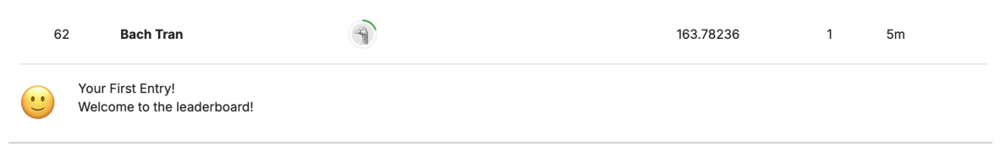

In [5]:
# Competition result
img = Image.open('score.png')
 
# Output Images
plt.figure(figsize=(15, 10))
plt.imshow(img)
plt.axis('off')
plt.show()

# Conclusion

Overall, my model performs pretty well with a MiFID score of 163. I was able to improve my initial model by changing the model architecture.

The generated images look nice with a color resemble the Monet paintings. However, the generated images are blurry. This might be due to the low number of filters in the generator model. To improve this model, in the future, I will add more filters and convolutional layer to the model, so that it can produce sharper images.

DCGAN is also not the best generative model. It has been shown that simple DCGAN is usually unstable. Often, the DCGAN model faces convergence failure. In this case, my model also had a hard time converging the generator. This is due to the imbalance between the discriminator and generator. My discriminator does a gret job at separating fake and real images, making the generated images always getting rejected. Thus, the generator has no chance to learn and reduce it's weight. This problem can be solved by using a more advanced GAN models like Wasserstein Generative Adversarial Network (WGAN), where the model use a different loss function and optimizer.
